***To visualize the centers in circle, the last FC need to be removed bias***
- result: if use lr=1 auto grad fail but the paper one doesn't

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline
import matplotlib.pyplot as plt
from torchvision import transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader, Dataset
import torch.nn as nn
import torch.nn.functional as F
import torch
import numpy as np
from exitai.learner import Learner
from exitai.callbacks import Callback
from exitai.losses import CenterLoss, CenterLossAutograd
from exitai.callbacks import classification_eval_func
from sklearn.decomposition import PCA
import numpy as np
import random
import os

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:
transform_train = transforms.Compose([
#                                    transforms.RandomAffine(15, scale=(.9,1.2)), # TODO add me
                                   transforms.ToTensor(),
                                   transforms.Normalize((0.1307,), (0.3081,))
                               ])
transform_test = transforms.Compose([
                                   transforms.ToTensor(),
                                   transforms.Normalize((0.5,), (1,))
                               ])
dataset_train = datasets.MNIST(root='../../data/', train=True, download=True, transform=transform_train)
dataset_test = datasets.MNIST(root='../../data/', train=False, download=True, transform=transform_test)
data_loader_train = DataLoader(dataset_train, batch_size=128, shuffle=True, num_workers=8)
data_loader_test = DataLoader(dataset_test, batch_size=128, shuffle=True, num_workers=8)

In [4]:
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1_1 = nn.Conv2d(1, 32, kernel_size=5, padding=2)
        self.prelu1_1 = nn.PReLU()
        self.conv1_2 = nn.Conv2d(32, 32, kernel_size=5, padding=2)
        self.prelu1_2 = nn.PReLU()
        self.conv2_1 = nn.Conv2d(32, 64, kernel_size=5, padding=2)
        self.prelu2_1 = nn.PReLU()
        self.conv2_2 = nn.Conv2d(64, 64, kernel_size=5, padding=2)
        self.prelu2_2 = nn.PReLU()
        self.conv3_1 = nn.Conv2d(64, 128, kernel_size=5, padding=2)
        self.prelu3_1 = nn.PReLU()
        self.conv3_2 = nn.Conv2d(128, 128, kernel_size=5, padding=2)
        self.prelu3_2 = nn.PReLU()
        self.preluip1 = nn.PReLU()
        self.ip1 = nn.Linear(128*3*3, 2)
        self.ip2 = nn.Linear(2, 10, bias=False)

    def forward(self, x):
        x = self.prelu1_1(self.conv1_1(x))
        x = self.prelu1_2(self.conv1_2(x))
        x = F.max_pool2d(x,2)
        x = self.prelu2_1(self.conv2_1(x))
        x = self.prelu2_2(self.conv2_2(x))
        x = F.max_pool2d(x,2)
        x = self.prelu3_1(self.conv3_1(x))
        x = self.prelu3_2(self.conv3_2(x))
        x = F.max_pool2d(x,2)
        x = x.view(-1, 128*3*3)
        vector_embedding = self.preluip1(self.ip1(x))
        output = self.ip2(vector_embedding)
        return output, vector_embedding

In [5]:
def visualize(vectors_embedding, target, epoch, save_path=None):
    plt.ion()
    c = ['#ff0000', '#ffff00', '#00ff00', '#00ffff', '#0000ff',
         '#ff00ff', '#990000', '#999900', '#009900', '#009999']
    plt.clf()
    for i in range(10):
        plt.plot(vectors_embedding[target == i, 0], vectors_embedding[target == i, 1], '.', c=c[i])
    plt.legend(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9'], loc = 'upper right')
#     plt.xlim(xmin=-80,xmax=80)
#     plt.ylim(ymin=-80,ymax=80)
    plt.text(0, 0,"epoch=%d" % epoch)
    if save_path:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig(f'{save_path}/epoch={epoch}.jpg')
    plt.draw()
    plt.pause(0.001)

## 1. Visualize Train set

In [8]:
def run_model(loss_center_weight, center_loss, save_path):
    model = Net().to(device)
    optimizer = torch.optim.SGD(model.parameters(),lr=0.001,momentum=0.9, weight_decay=0.0005)
    sheduler = torch.optim.lr_scheduler.StepLR(optimizer,20,gamma=0.8)
    optimzer_center = torch.optim.SGD(center_loss.parameters(), lr =0.5)
    for epoch in range(100):
        print('--- epoch',epoch+1,'---')
        sheduler.step()

        vector_embedding_all = []
        targe_all = []
        total_loss = 0
        total_correct = 0
        for i,(data, target) in enumerate(data_loader_train):
            data, target = data.to(device), target.to(device)

            output, vector_embedding = model(data)
            loss = F.cross_entropy(output, target) + loss_center_weight * center_loss(target, vector_embedding)

            optimizer.zero_grad()
            optimzer_center.zero_grad()
            loss.backward()
            optimizer.step()
            optimzer_center.step()

            targe_all.append((target))
            vector_embedding_all.append(vector_embedding)

            # find acc
            pred = output.max(1)[1]  # get the index of the max log-probability
            total_correct += pred.eq(target).sum().item()
            total_loss += loss.item()
        print('--- loss:', total_loss/len(data_loader_train.dataset)*100,'%', 'acc:', total_correct/len(data_loader_train.dataset)*100,'%')

        targe_all = torch.cat(targe_all, 0)
        vector_embedding_all = torch.cat(vector_embedding_all, 0)
        visualize(vector_embedding_all.data.cpu().numpy(),targe_all.data.cpu().numpy(),epoch, save_path)


--- epoch 1 ---
--- loss: 1.8257396137714388 % acc: 9.915000000000001 %


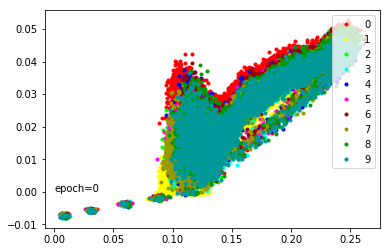

--- epoch 2 ---
--- loss: 1.7960432509581248 % acc: 11.411666666666667 %


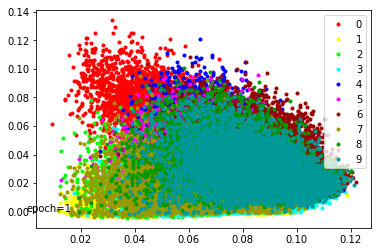

--- epoch 3 ---
--- loss: 1.7889615245660146 % acc: 14.446666666666665 %


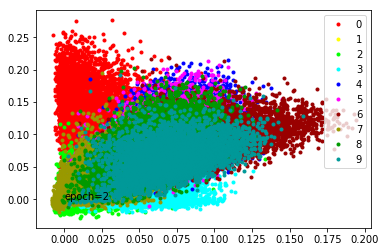

--- epoch 4 ---
--- loss: 1.774875971476237 % acc: 19.063333333333333 %


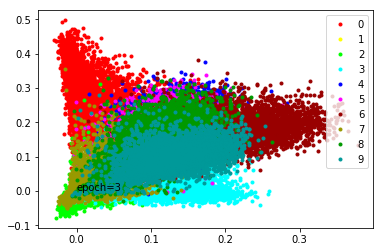

--- epoch 5 ---
--- loss: 1.7483873621622723 % acc: 24.568333333333335 %


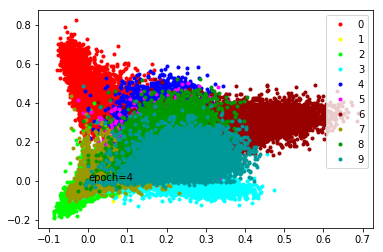

--- epoch 6 ---
--- loss: 1.7077654890219371 % acc: 28.463333333333335 %


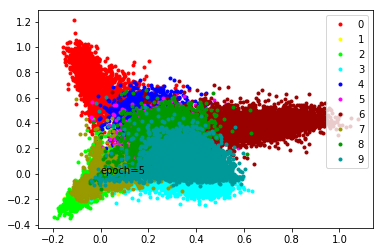

--- epoch 7 ---
--- loss: 1.6399254645903905 % acc: 32.62166666666666 %


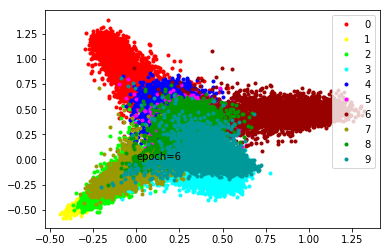

--- epoch 8 ---
--- loss: 1.5340566525856654 % acc: 33.58166666666666 %


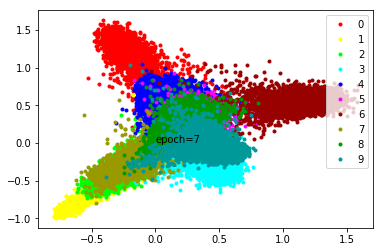

--- epoch 9 ---
--- loss: 1.410486811598142 % acc: 40.233333333333334 %


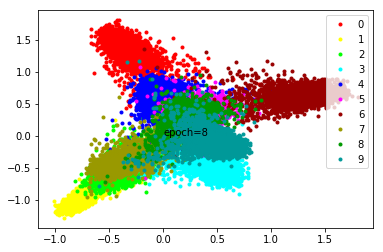

--- epoch 10 ---
--- loss: 1.3068507355451584 % acc: 40.821666666666665 %


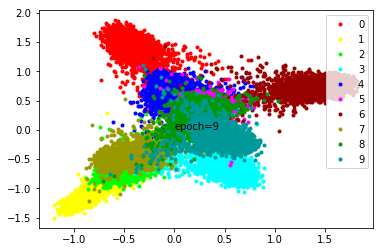

--- epoch 11 ---
--- loss: 1.2260548988978068 % acc: 40.99 %


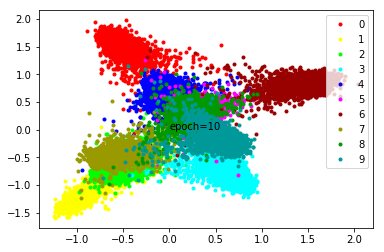

--- epoch 12 ---
--- loss: 1.158372384707133 % acc: 41.071666666666665 %


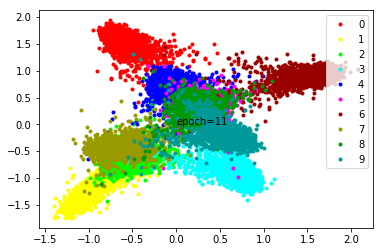

--- epoch 13 ---
--- loss: 1.097292978366216 % acc: 41.12833333333333 %


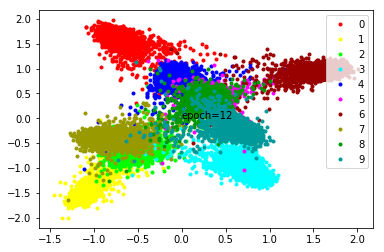

--- epoch 14 ---
--- loss: 1.0455464337269464 % acc: 43.861666666666665 %


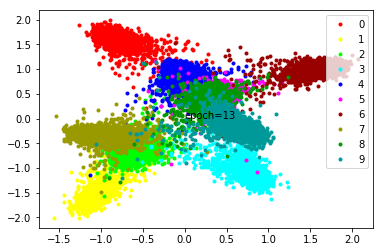

--- epoch 15 ---
--- loss: 0.9965026952823003 % acc: 51.10666666666667 %


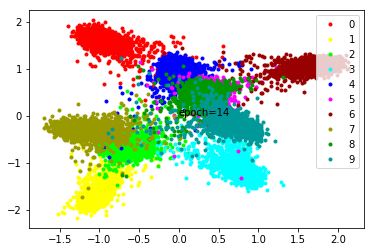

--- epoch 16 ---
--- loss: 0.9448129656910896 % acc: 53.04666666666667 %


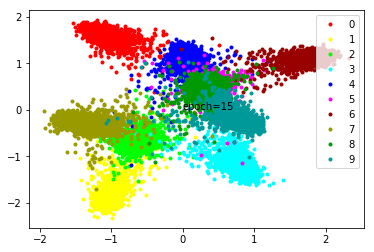

--- epoch 17 ---
--- loss: 0.8998095658421517 % acc: 63.97166666666667 %


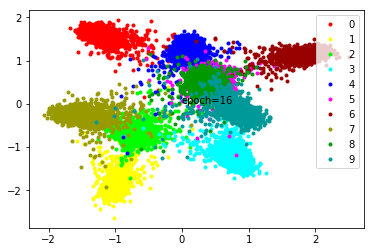

--- epoch 18 ---
--- loss: 0.857208040356636 % acc: 69.47833333333332 %


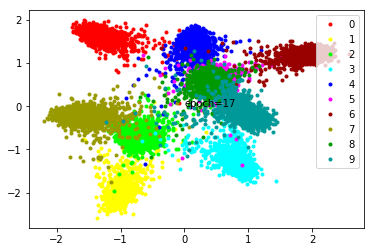

--- epoch 19 ---
--- loss: 0.8179863389333089 % acc: 70.49833333333333 %


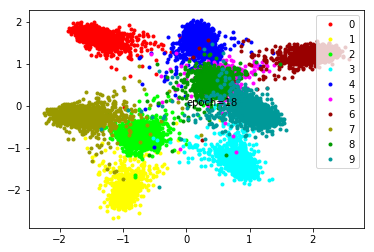

--- epoch 20 ---
--- loss: 0.7816166933377585 % acc: 70.76333333333334 %


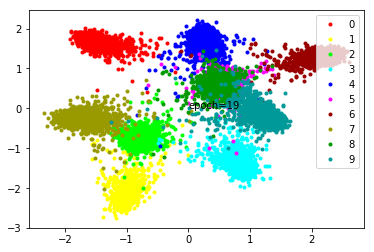

--- epoch 21 ---
--- loss: 0.7274309912323952 % acc: 70.92333333333333 %


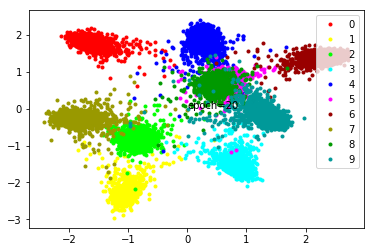

--- epoch 22 ---
--- loss: 0.7002263639370601 % acc: 71.05833333333334 %


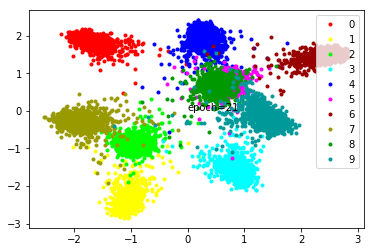

--- epoch 23 ---
--- loss: 0.6799091809988023 % acc: 74.18 %


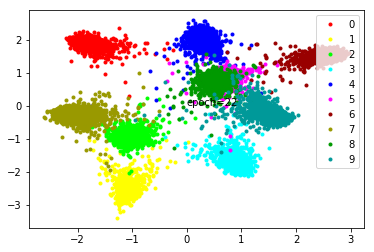

--- epoch 24 ---
--- loss: 0.6596439802646636 % acc: 78.67 %


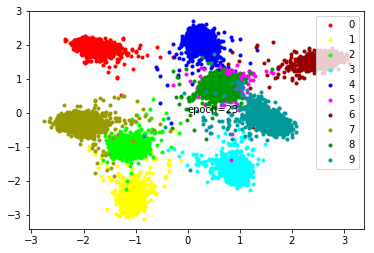

--- epoch 25 ---
--- loss: 0.6318100824952125 % acc: 80.53166666666667 %


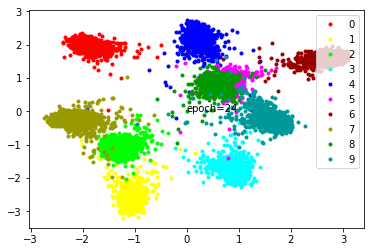

--- epoch 26 ---
--- loss: 0.6128524395823479 % acc: 81.26333333333334 %


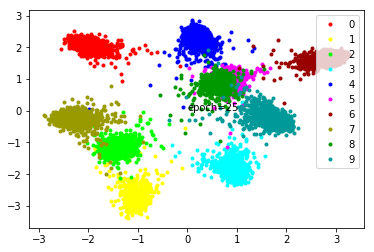

--- epoch 27 ---
--- loss: 0.5867704011003176 % acc: 83.36666666666666 %


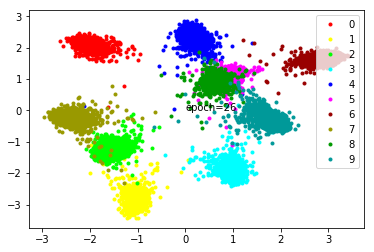

--- epoch 28 ---
--- loss: 0.5707655002673467 % acc: 86.20333333333333 %


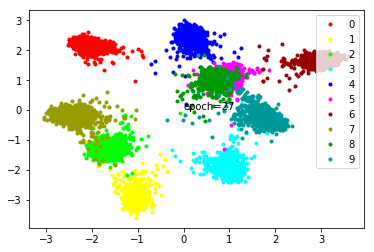

--- epoch 29 ---
--- loss: 0.5508382694919903 % acc: 88.46166666666667 %


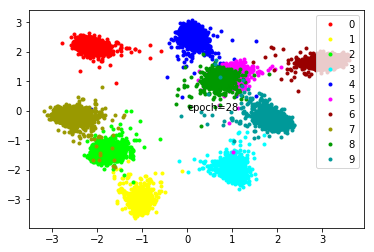

--- epoch 30 ---
--- loss: 0.5328412527839342 % acc: 89.51666666666667 %


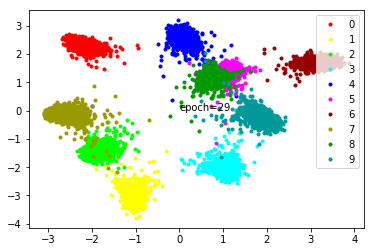

--- epoch 31 ---
--- loss: 0.5108895367880663 % acc: 89.905 %


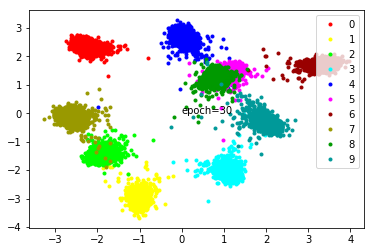

--- epoch 32 ---
--- loss: 0.4927856853107611 % acc: 90.08666666666667 %


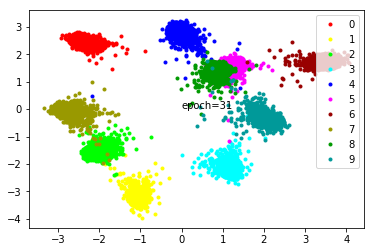

--- epoch 33 ---
--- loss: 0.47386726920803385 % acc: 90.39333333333333 %


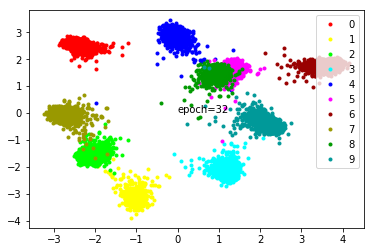

--- epoch 34 ---
--- loss: 0.4558727888266246 % acc: 91.34333333333333 %


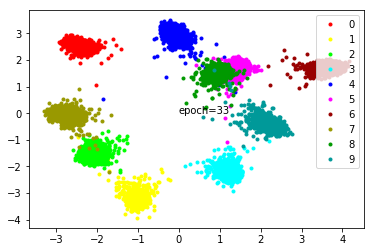

--- epoch 35 ---
--- loss: 0.43858071198066073 % acc: 92.56 %


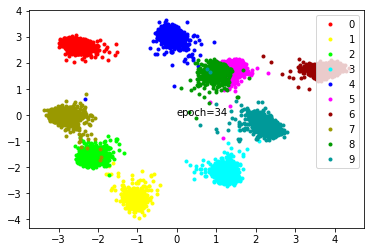

--- epoch 36 ---
--- loss: 0.4261939540505409 % acc: 94.44166666666666 %


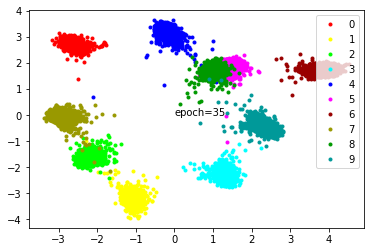

--- epoch 37 ---
--- loss: 0.4135435354709625 % acc: 97.60166666666666 %


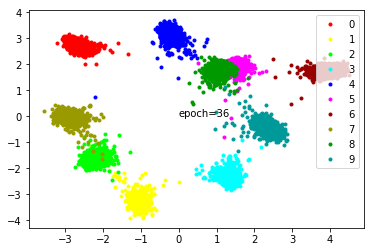

--- epoch 38 ---
--- loss: 0.40198192810018857 % acc: 98.29333333333334 %


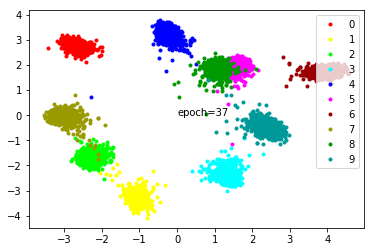

--- epoch 39 ---
--- loss: 0.37805873066186907 % acc: 99.57666666666667 %


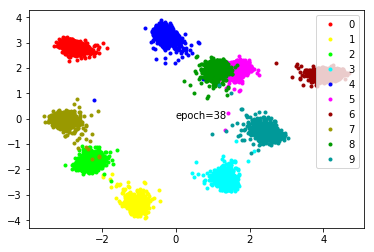

--- epoch 40 ---
--- loss: 0.3641761440535386 % acc: 99.72999999999999 %


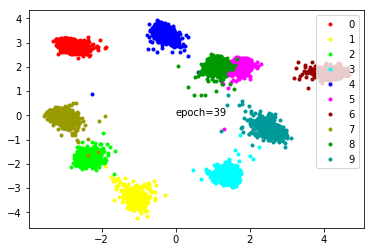

--- epoch 41 ---
--- loss: 0.3065242660045624 % acc: 99.89833333333334 %


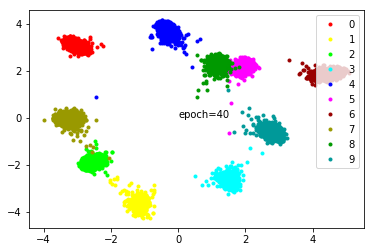

--- epoch 42 ---
--- loss: 0.30800607283910114 % acc: 99.94 %


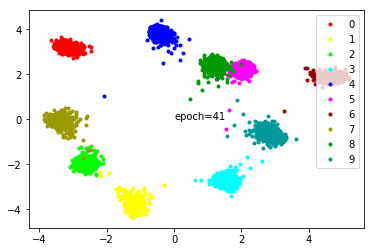

--- epoch 43 ---
--- loss: 0.30109669665495553 % acc: 99.95833333333334 %


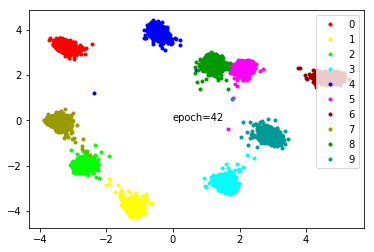

--- epoch 44 ---
--- loss: 0.2926480233172576 % acc: 99.97 %


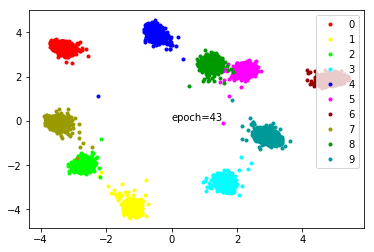

--- epoch 45 ---
--- loss: 0.28055688761174674 % acc: 99.98166666666667 %


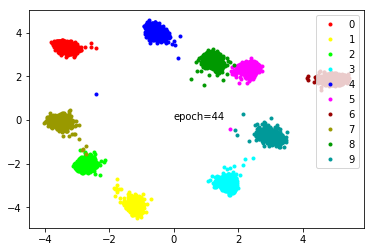

--- epoch 46 ---
--- loss: 0.2809521375596523 % acc: 99.97833333333334 %


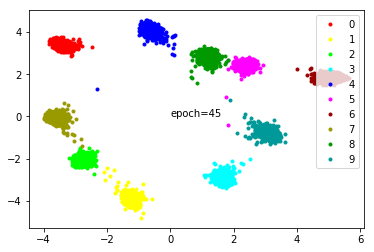

--- epoch 47 ---
--- loss: 0.26915761835873125 % acc: 99.99166666666667 %


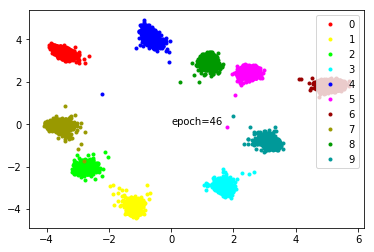

--- epoch 48 ---
--- loss: 0.25863180781404177 % acc: 99.98666666666666 %


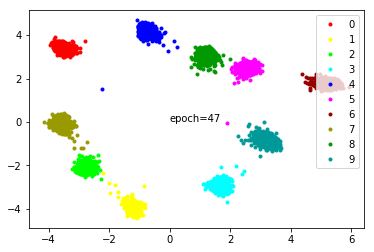

--- epoch 49 ---
--- loss: 0.25672895915806293 % acc: 99.99 %


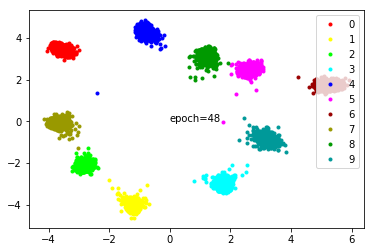

--- epoch 50 ---
--- loss: 0.24784183631340662 % acc: 99.99333333333334 %


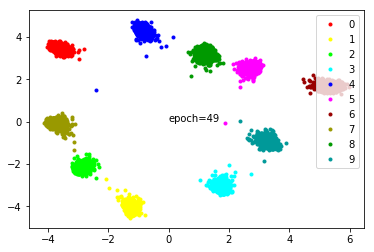

--- epoch 51 ---
--- loss: 0.24053014273444812 % acc: 99.99166666666667 %


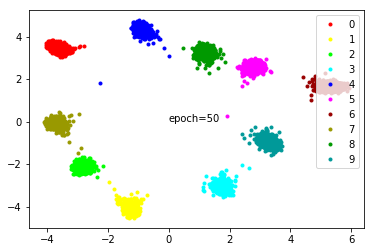

--- epoch 52 ---
--- loss: 0.22936662326256432 % acc: 99.99333333333334 %


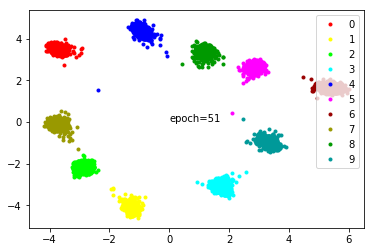

--- epoch 53 ---
--- loss: 0.23504484367867312 % acc: 99.99 %


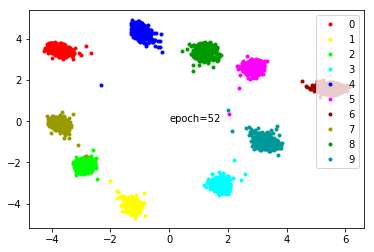

--- epoch 54 ---
--- loss: 0.21761305776735146 % acc: 99.99666666666667 %


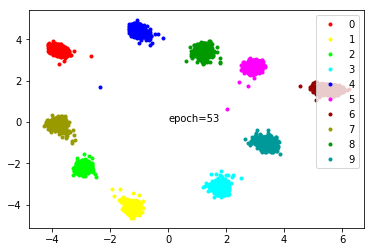

--- epoch 55 ---
--- loss: 0.2142084029316902 % acc: 99.99666666666667 %


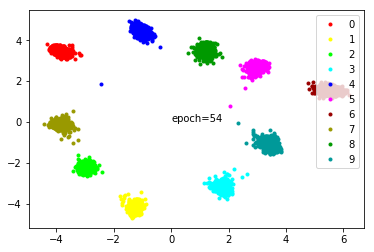

--- epoch 56 ---
--- loss: 0.20850955232977866 % acc: 99.995 %


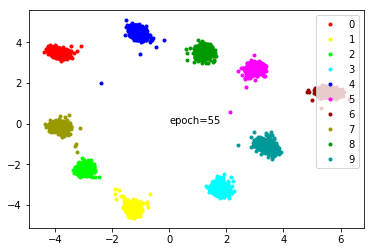

--- epoch 57 ---
--- loss: 0.20141207295159497 % acc: 99.995 %


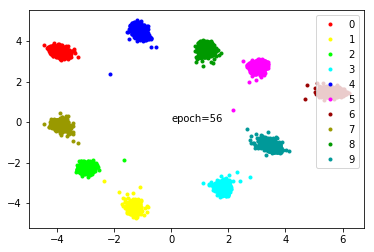

--- epoch 58 ---
--- loss: 0.19460957698523998 % acc: 99.995 %


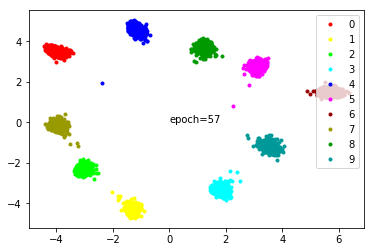

--- epoch 59 ---
--- loss: 0.18850699792305628 % acc: 99.99666666666667 %


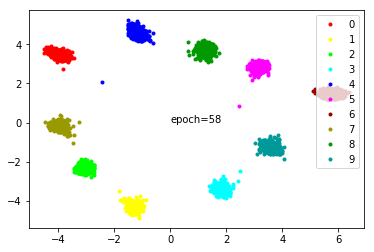

--- epoch 60 ---
--- loss: 0.17876622329155606 % acc: 99.995 %


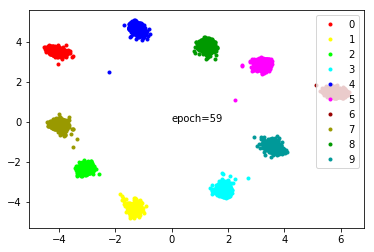

--- epoch 61 ---
--- loss: 0.12056318735082944 % acc: 99.99666666666667 %


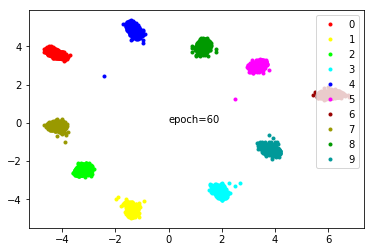

--- epoch 62 ---
--- loss: 0.12668378562976917 % acc: 99.99833333333333 %


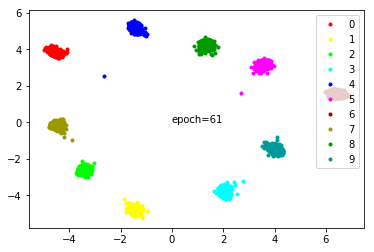

--- epoch 63 ---
--- loss: 0.13309655899802844 % acc: 99.99666666666667 %


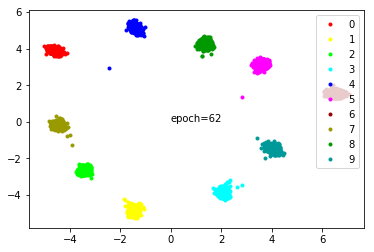

--- epoch 64 ---
--- loss: 0.12455970969051122 % acc: 99.99833333333333 %


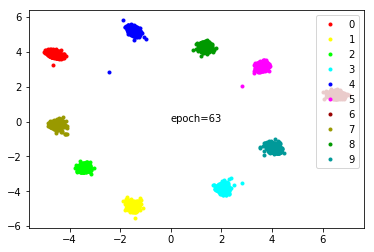

--- epoch 65 ---
--- loss: 0.14323202381531397 % acc: 99.99833333333333 %


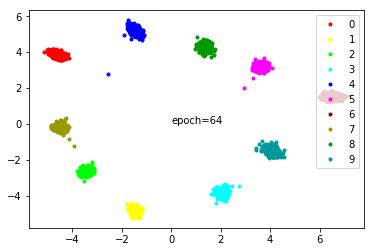

--- epoch 66 ---
--- loss: 0.12185773572574059 % acc: 99.99833333333333 %


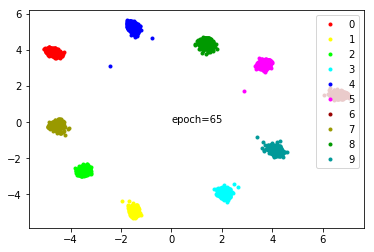

--- epoch 67 ---
--- loss: 0.12879192676395176 % acc: 99.99833333333333 %


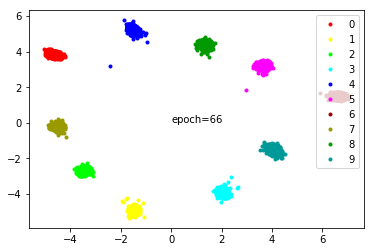

--- epoch 68 ---
--- loss: 0.1221099208916227 % acc: 99.99833333333333 %


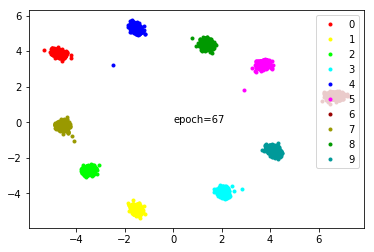

--- epoch 69 ---
--- loss: 0.12237809016058841 % acc: 99.99833333333333 %


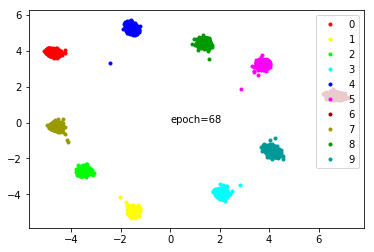

--- epoch 70 ---
--- loss: 0.12172981264690558 % acc: 99.99833333333333 %


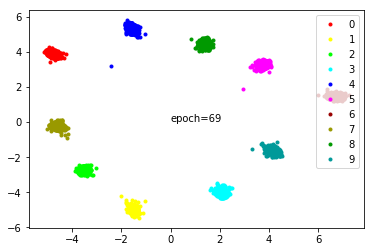

--- epoch 71 ---
--- loss: 0.11300516117364169 % acc: 99.99833333333333 %


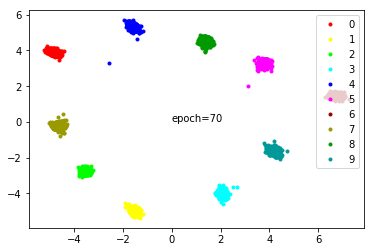

--- epoch 72 ---
--- loss: 0.11095890268683432 % acc: 99.99833333333333 %


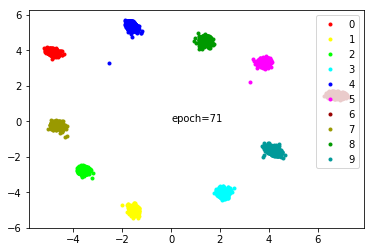

--- epoch 73 ---
--- loss: 0.12320077914744615 % acc: 99.99833333333333 %


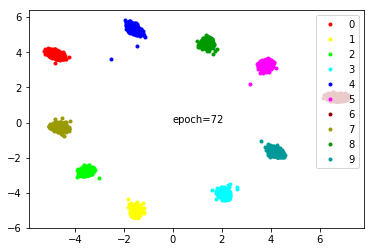

--- epoch 74 ---
--- loss: 0.11601125522206228 % acc: 100.0 %


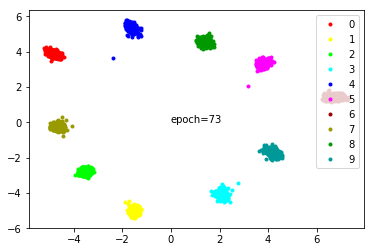

--- epoch 75 ---
--- loss: 0.10687598074475924 % acc: 99.99833333333333 %


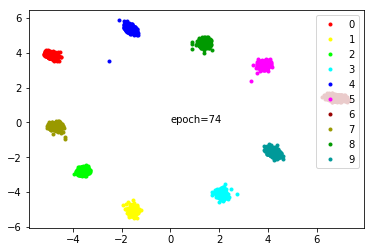

--- epoch 76 ---
--- loss: 0.10342448528856038 % acc: 99.99833333333333 %


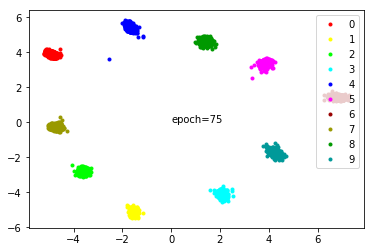

--- epoch 77 ---
--- loss: 0.10328718238820632 % acc: 100.0 %


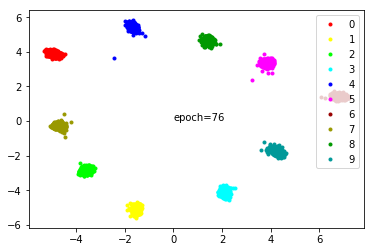

--- epoch 78 ---
--- loss: 0.10501545729736488 % acc: 100.0 %


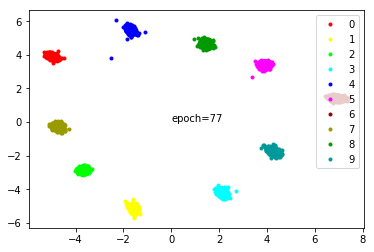

--- epoch 79 ---
--- loss: 0.09678704932332038 % acc: 100.0 %


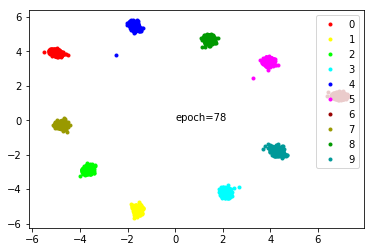

--- epoch 80 ---
--- loss: 0.10057732831686736 % acc: 100.0 %


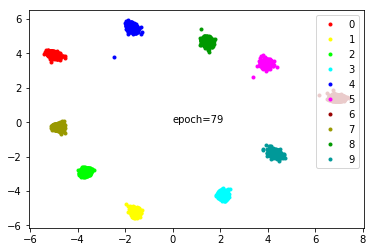

--- epoch 81 ---
--- loss: 0.060428997321675226 % acc: 100.0 %


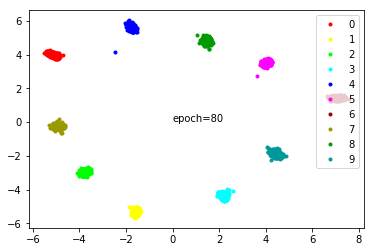

--- epoch 82 ---
--- loss: 0.05251856776575248 % acc: 100.0 %


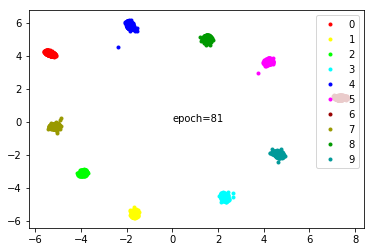

--- epoch 83 ---
--- loss: 0.05304802923773726 % acc: 100.0 %


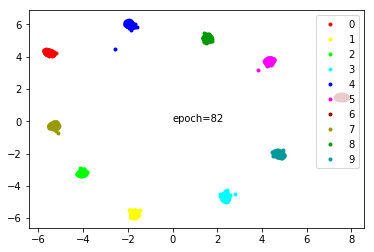

--- epoch 84 ---
--- loss: 0.06936000051597754 % acc: 100.0 %


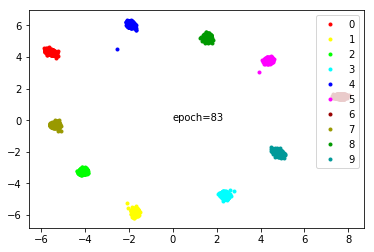

--- epoch 85 ---
--- loss: 0.062293498174597825 % acc: 100.0 %


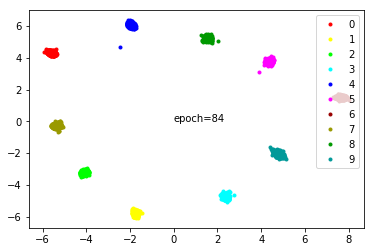

--- epoch 86 ---
--- loss: 0.08194660540670157 % acc: 100.0 %


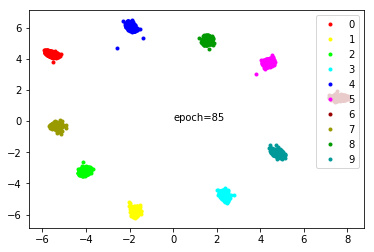

--- epoch 87 ---
--- loss: 0.06625110937282443 % acc: 100.0 %


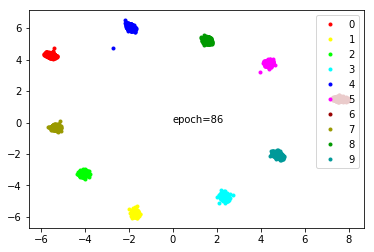

--- epoch 88 ---
--- loss: 0.05770711148157715 % acc: 100.0 %


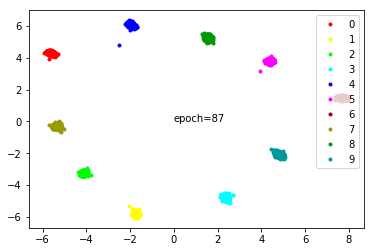

--- epoch 89 ---
--- loss: 0.06574516673882802 % acc: 100.0 %


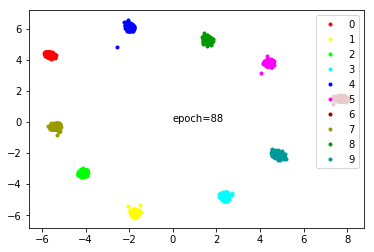

--- epoch 90 ---
--- loss: 0.06777018137276172 % acc: 100.0 %


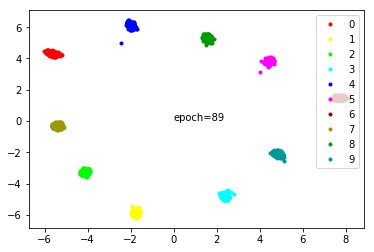

--- epoch 91 ---
--- loss: 0.06947652187819282 % acc: 100.0 %


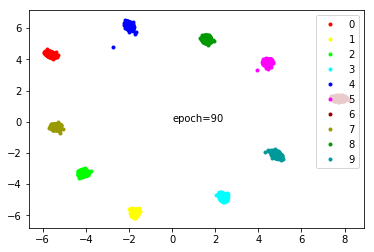

--- epoch 92 ---
--- loss: 0.06302429701512058 % acc: 100.0 %


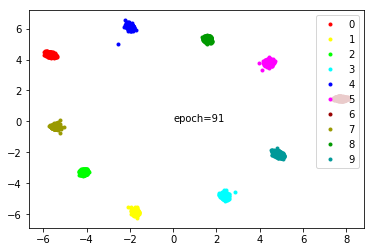

--- epoch 93 ---
--- loss: 0.057763425751278796 % acc: 100.0 %


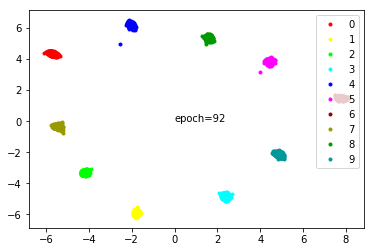

--- epoch 94 ---
--- loss: 0.06879563088218371 % acc: 100.0 %


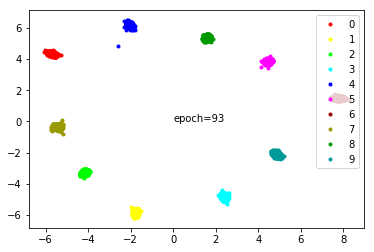

--- epoch 95 ---
--- loss: 0.07294775523866216 % acc: 100.0 %


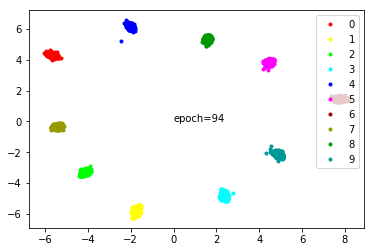

--- epoch 96 ---
--- loss: 0.06368618363514543 % acc: 100.0 %


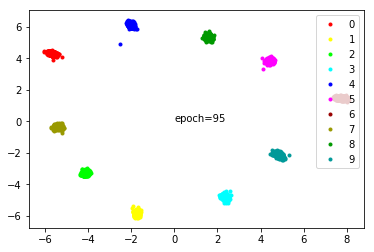

--- epoch 97 ---
--- loss: 0.061503206342458726 % acc: 100.0 %


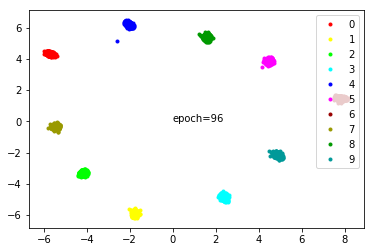

--- epoch 98 ---
--- loss: 0.0566897676512599 % acc: 100.0 %


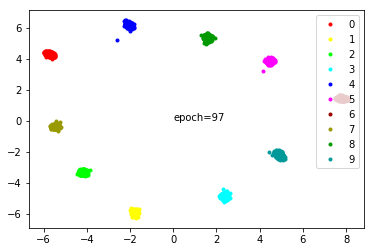

--- epoch 99 ---
--- loss: 0.06725640681261817 % acc: 100.0 %


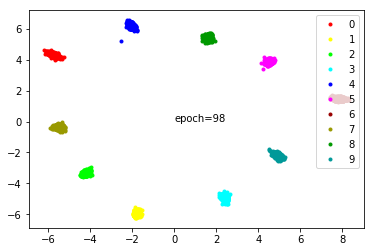

--- epoch 100 ---
--- loss: 0.05956487709656358 % acc: 100.0 %


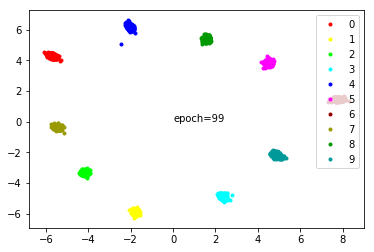

In [7]:
run_model(0.1, CenterLossAutograd(10, 2).to(device), 'auto_0.1')

--- epoch 1 ---
--- loss: 1.8123258856932323 % acc: 10.084999999999999 %


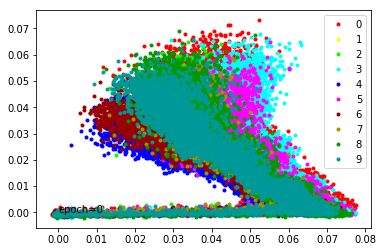

--- epoch 2 ---
--- loss: 1.7882984566688538 % acc: 17.205000000000002 %


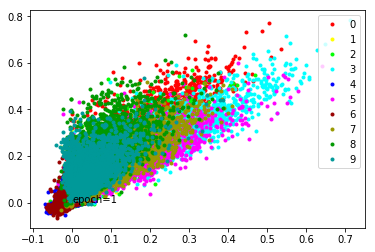

--- epoch 3 ---
--- loss: 1.7132151913642881 % acc: 24.388333333333335 %


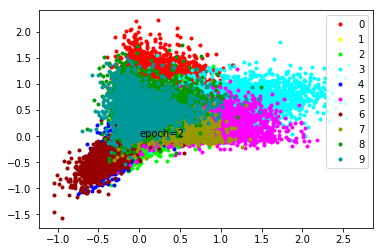

--- epoch 4 ---
--- loss: 1.5010545883576076 % acc: 37.940000000000005 %


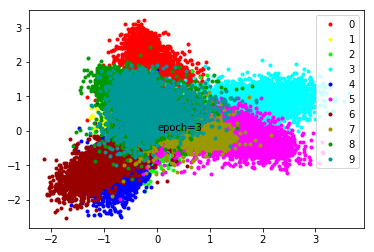

--- epoch 5 ---
--- loss: 1.2556973588466644 % acc: 47.52 %


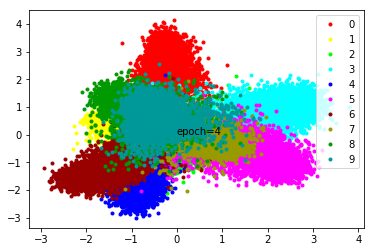

--- epoch 6 ---
--- loss: 1.054784514307976 % acc: 60.351666666666674 %


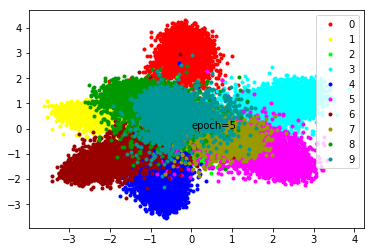

--- epoch 7 ---
--- loss: 0.9150107378760973 % acc: 61.38666666666667 %


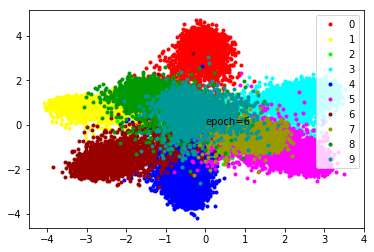

--- epoch 8 ---
--- loss: 0.8255797562996545 % acc: 65.55499999999999 %


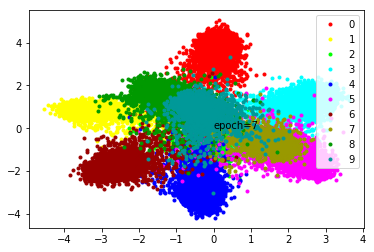

--- epoch 9 ---
--- loss: 0.7515656534830729 % acc: 68.86 %


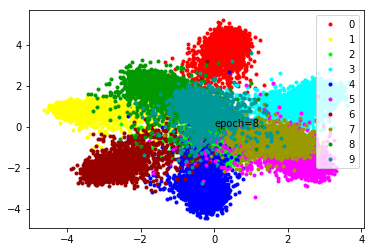

--- epoch 10 ---
--- loss: 0.693290814658006 % acc: 76.80666666666667 %


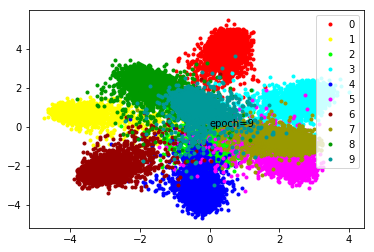

--- epoch 11 ---
--- loss: 0.6401023437579473 % acc: 78.42 %


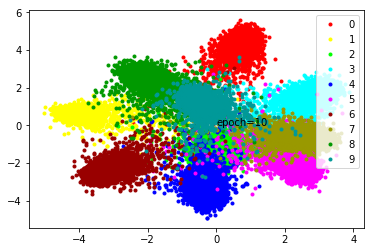

--- epoch 12 ---
--- loss: 0.5914190490047138 % acc: 78.815 %


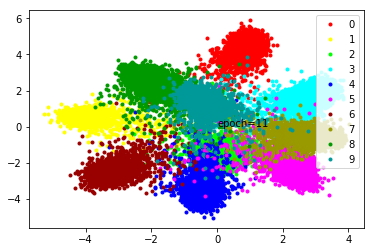

--- epoch 13 ---
--- loss: 0.554259633521239 % acc: 78.99166666666667 %


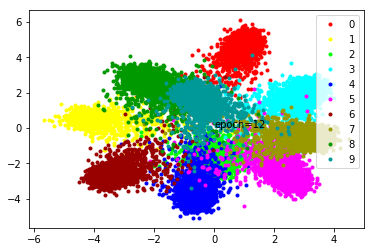

--- epoch 14 ---
--- loss: 0.510867641667525 % acc: 81.42666666666668 %


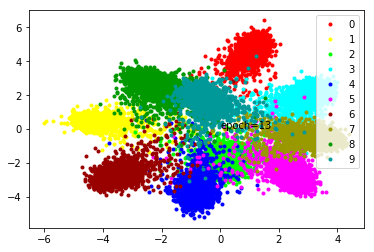

--- epoch 15 ---
--- loss: 0.47369358321030935 % acc: 91.45333333333333 %


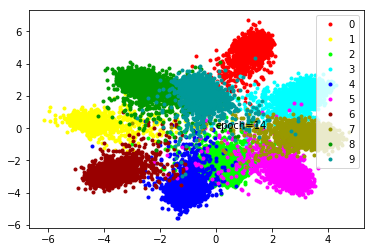

--- epoch 16 ---
--- loss: 0.43842018008232114 % acc: 97.69 %


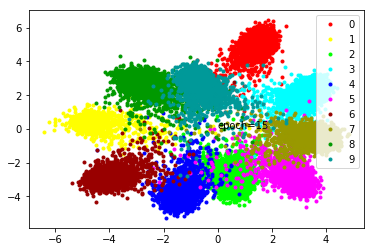

--- epoch 17 ---
--- loss: 0.39675273001194 % acc: 98.42166666666667 %


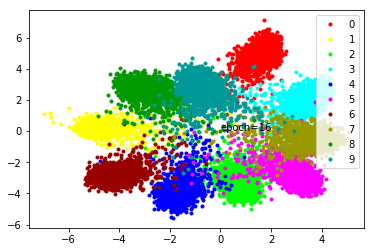

--- epoch 18 ---
--- loss: 0.36901720280448597 % acc: 98.64666666666668 %


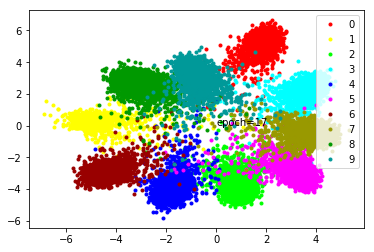

--- epoch 19 ---
--- loss: 0.3336865470310052 % acc: 98.87666666666667 %


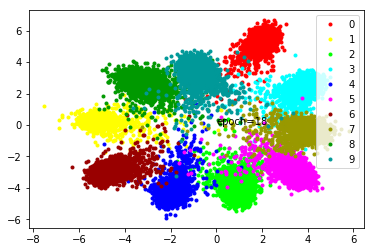

--- epoch 20 ---
--- loss: 0.30883875717719395 % acc: 99.065 %


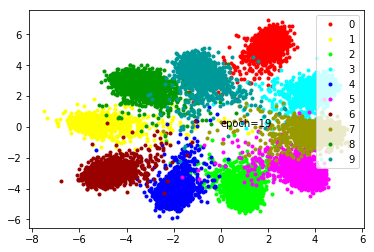

--- epoch 21 ---
--- loss: 0.2683383815238873 % acc: 99.33666666666666 %


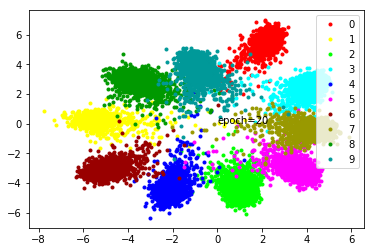

--- epoch 22 ---
--- loss: 0.24765285347898802 % acc: 99.44166666666666 %


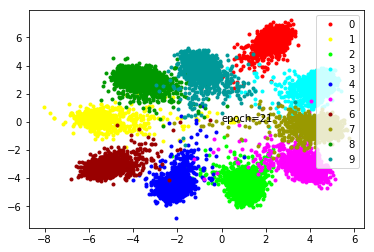

--- epoch 23 ---
--- loss: 0.22973138997952144 % acc: 99.55166666666668 %


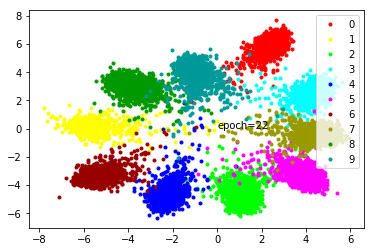

--- epoch 24 ---
--- loss: 0.21568484033147495 % acc: 99.63833333333334 %


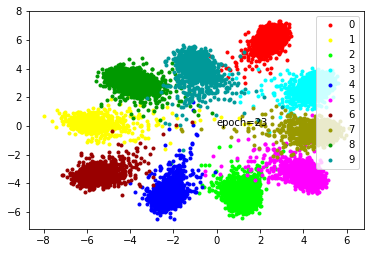

--- epoch 25 ---
--- loss: 0.2028647968173027 % acc: 99.70833333333333 %


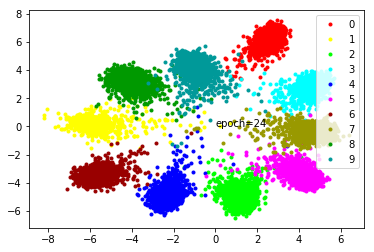

--- epoch 26 ---
--- loss: 0.1878697922080755 % acc: 99.76333333333334 %


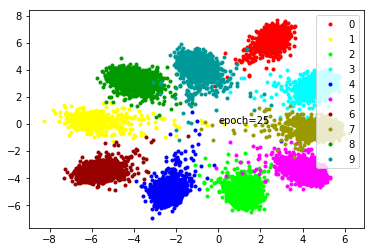

--- epoch 27 ---
--- loss: 0.17633317291736603 % acc: 99.80833333333334 %


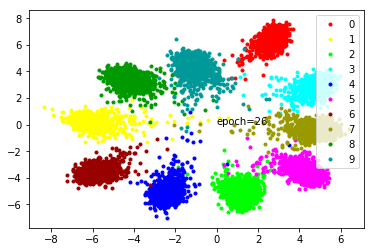

--- epoch 28 ---
--- loss: 0.16257025855282942 % acc: 99.84333333333333 %


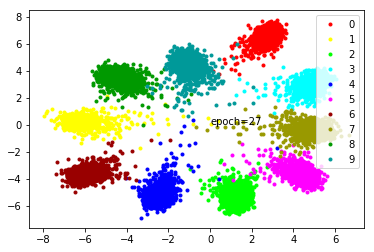

--- epoch 29 ---
--- loss: 0.15000603732963402 % acc: 99.90166666666667 %


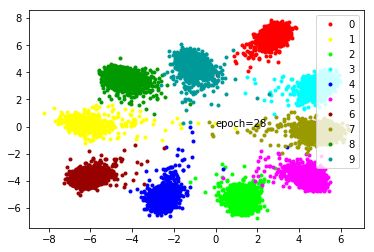

--- epoch 30 ---
--- loss: 0.14193620714048544 % acc: 99.9 %


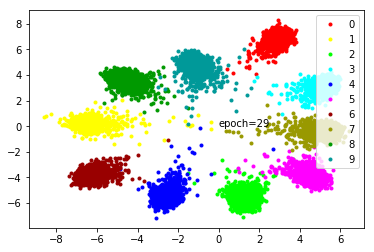

--- epoch 31 ---
--- loss: 0.1317839178070426 % acc: 99.92166666666667 %


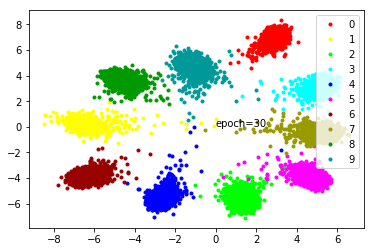

--- epoch 32 ---
--- loss: 0.12749599820623794 % acc: 99.94333333333333 %


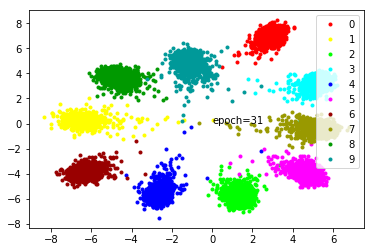

--- epoch 33 ---
--- loss: 0.11188664594044288 % acc: 99.95166666666667 %


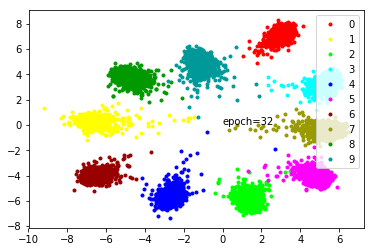

--- epoch 34 ---
--- loss: 0.11032625664025544 % acc: 99.95833333333334 %


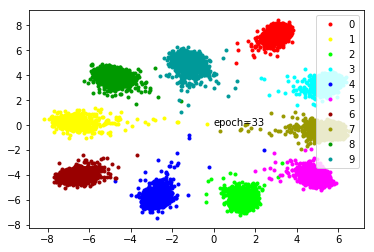

--- epoch 35 ---
--- loss: 0.09943154758463305 % acc: 99.97500000000001 %


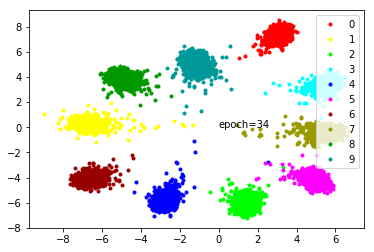

--- epoch 36 ---
--- loss: 0.09462558597326279 % acc: 99.97500000000001 %


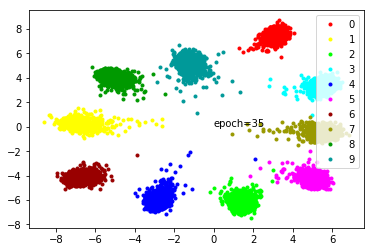

--- epoch 37 ---
--- loss: 0.08960255052894353 % acc: 99.98333333333333 %


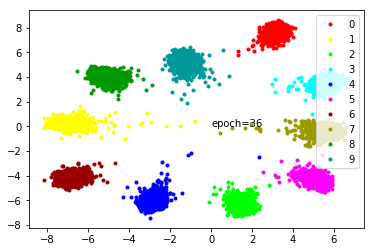

--- epoch 38 ---
--- loss: 0.08520495957384507 % acc: 99.98666666666666 %


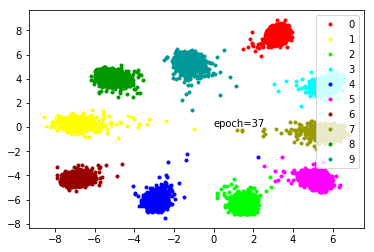

--- epoch 39 ---
--- loss: 0.08045697492857774 % acc: 99.985 %


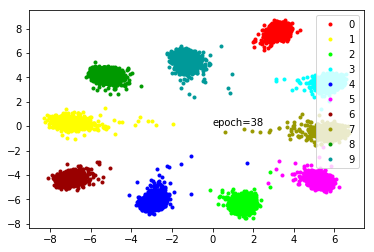

--- epoch 40 ---
--- loss: 0.07578575535366933 % acc: 99.98833333333333 %


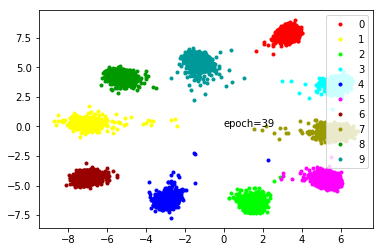

--- epoch 41 ---
--- loss: 0.06198076476032536 % acc: 99.99833333333333 %


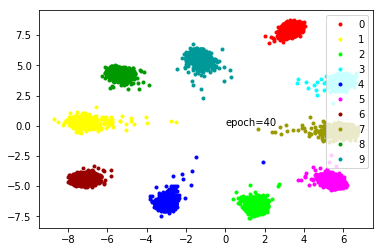

--- epoch 42 ---
--- loss: 0.058405372252066934 % acc: 99.99666666666667 %


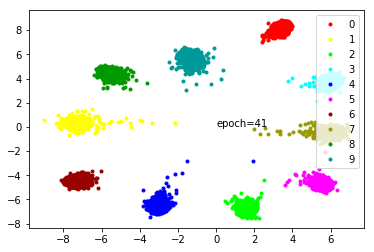

--- epoch 43 ---
--- loss: 0.053232438613971075 % acc: 99.995 %


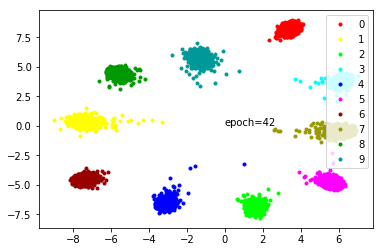

--- epoch 44 ---
--- loss: 0.053538534690936404 % acc: 99.99666666666667 %


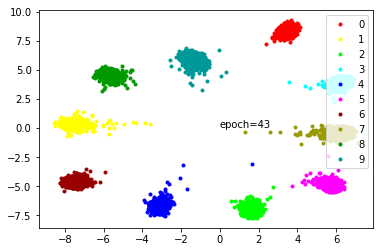

--- epoch 45 ---
--- loss: 0.04972291278963288 % acc: 99.99666666666667 %


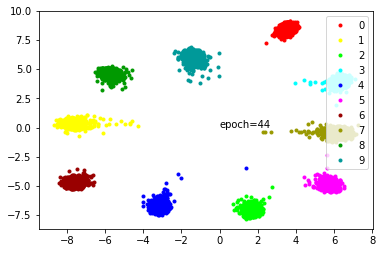

--- epoch 46 ---
--- loss: 0.048798216115683316 % acc: 99.99833333333333 %


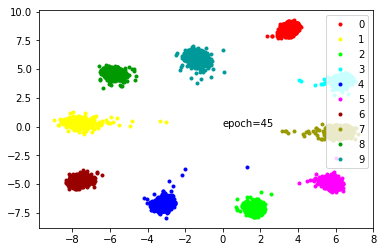

--- epoch 47 ---
--- loss: 0.04599931412686904 % acc: 99.99833333333333 %


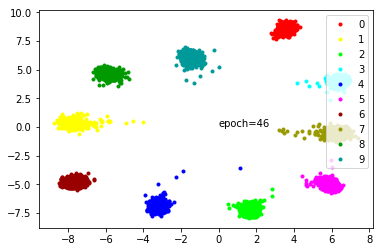

--- epoch 48 ---
--- loss: 0.044341438269863524 % acc: 99.99833333333333 %


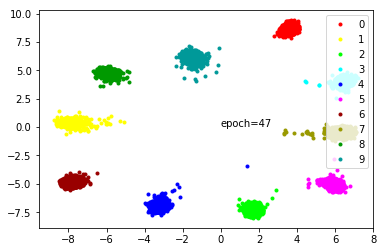

--- epoch 49 ---
--- loss: 0.044610721630354726 % acc: 99.99833333333333 %


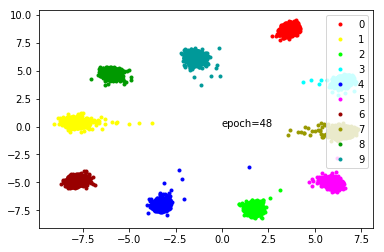

--- epoch 50 ---
--- loss: 0.04205061041439573 % acc: 99.99833333333333 %


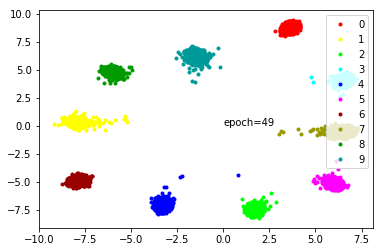

--- epoch 51 ---
--- loss: 0.04077837260439992 % acc: 99.99833333333333 %


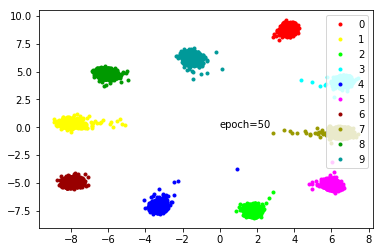

--- epoch 52 ---
--- loss: 0.0393652034116288 % acc: 99.99833333333333 %


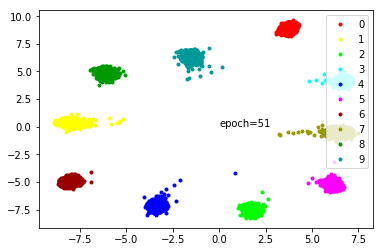

--- epoch 53 ---
--- loss: 0.038899138960987324 % acc: 99.99833333333333 %


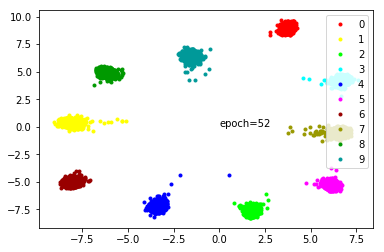

--- epoch 54 ---
--- loss: 0.03679462424168984 % acc: 99.99833333333333 %


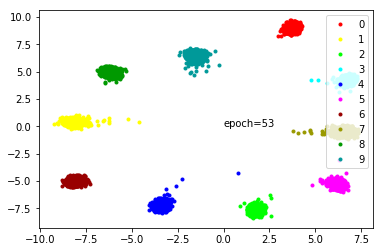

--- epoch 55 ---
--- loss: 0.03477136787648002 % acc: 99.99833333333333 %


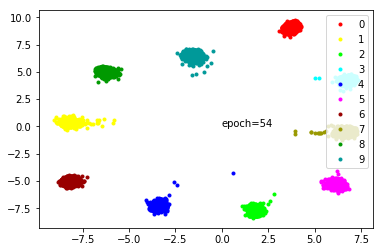

--- epoch 56 ---
--- loss: 0.03375225617239872 % acc: 99.99833333333333 %


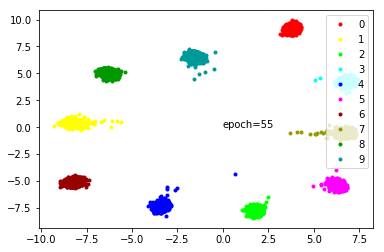

--- epoch 57 ---
--- loss: 0.03406666751330098 % acc: 99.99833333333333 %


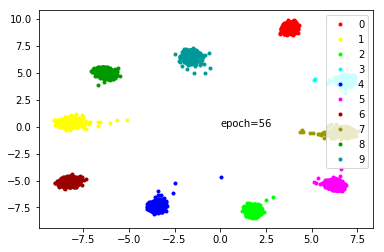

--- epoch 58 ---
--- loss: 0.03209634710724155 % acc: 99.99833333333333 %


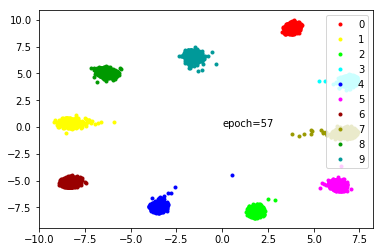

--- epoch 59 ---
--- loss: 0.030924787493422628 % acc: 99.99833333333333 %


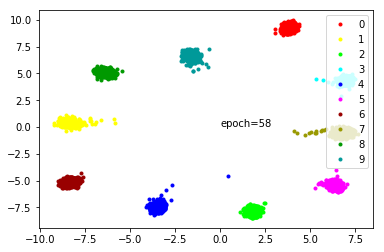

--- epoch 60 ---
--- loss: 0.029805729187404116 % acc: 99.99833333333333 %


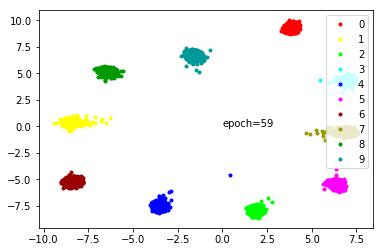

--- epoch 61 ---
--- loss: 0.024091463377699258 % acc: 100.0 %


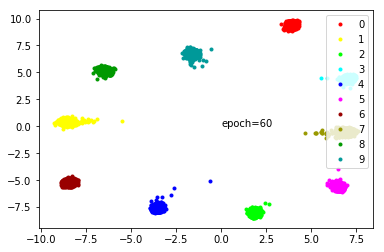

--- epoch 62 ---
--- loss: 0.022065175122891863 % acc: 99.99833333333333 %


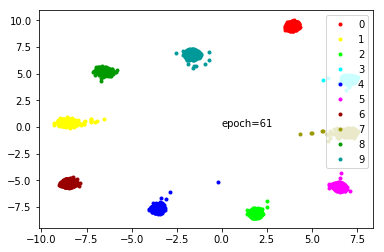

--- epoch 63 ---
--- loss: 0.020938344057649376 % acc: 99.99833333333333 %


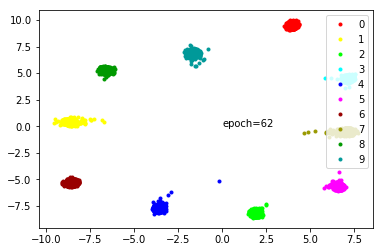

--- epoch 64 ---
--- loss: 0.02049400259119769 % acc: 99.99833333333333 %


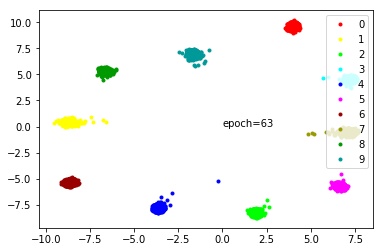

--- epoch 65 ---
--- loss: 0.02027993567287922 % acc: 100.0 %


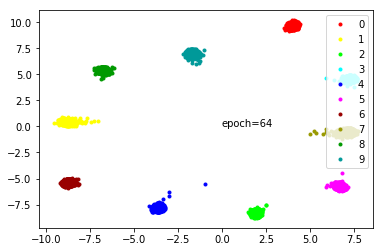

--- epoch 66 ---
--- loss: 0.019575546309351922 % acc: 99.99833333333333 %


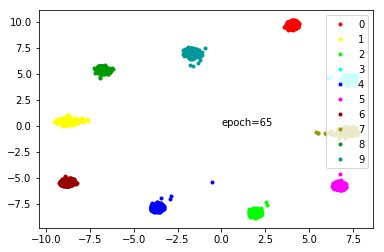

--- epoch 67 ---
--- loss: 0.019179429076611996 % acc: 100.0 %


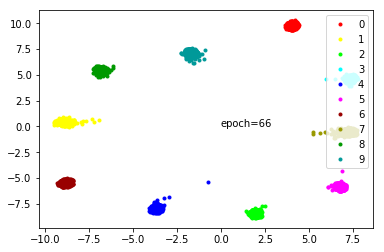

--- epoch 68 ---
--- loss: 0.019395341748992604 % acc: 100.0 %


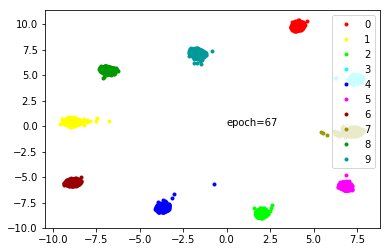

--- epoch 69 ---
--- loss: 0.018487147434304158 % acc: 100.0 %


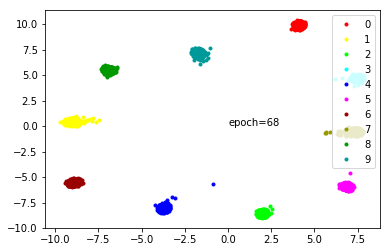

--- epoch 70 ---
--- loss: 0.017690665544942023 % acc: 100.0 %


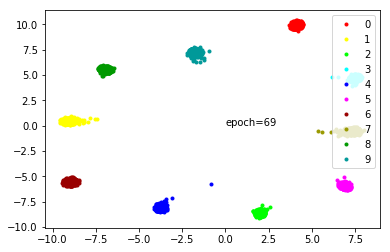

--- epoch 71 ---
--- loss: 0.017663716127475103 % acc: 100.0 %


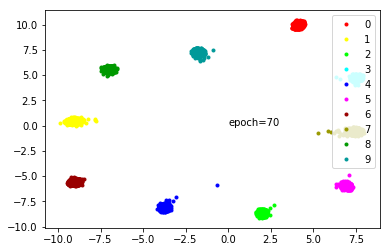

--- epoch 72 ---
--- loss: 0.017393738407020767 % acc: 100.0 %


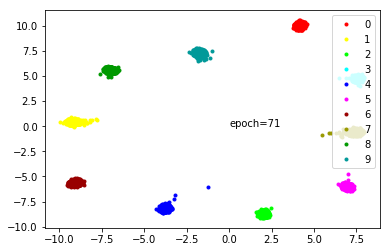

--- epoch 73 ---
--- loss: 0.017432375603045027 % acc: 100.0 %


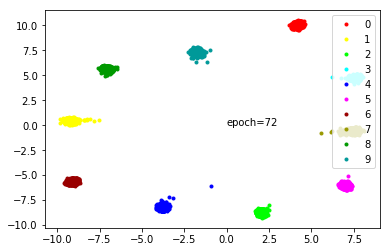

--- epoch 74 ---
--- loss: 0.0165759912909319 % acc: 100.0 %


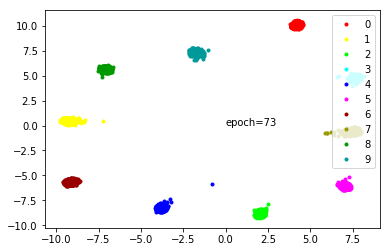

--- epoch 75 ---
--- loss: 0.016521634710952637 % acc: 100.0 %


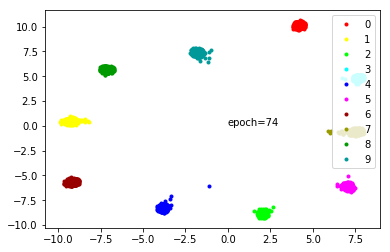

--- epoch 76 ---
--- loss: 0.01611361143644899 % acc: 100.0 %


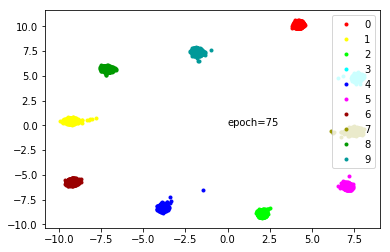

--- epoch 77 ---
--- loss: 0.015753940045833588 % acc: 100.0 %


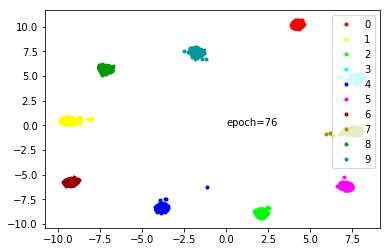

--- epoch 78 ---
--- loss: 0.015899959341622888 % acc: 100.0 %


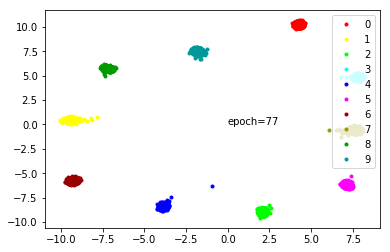

--- epoch 79 ---
--- loss: 0.015443343548104168 % acc: 100.0 %


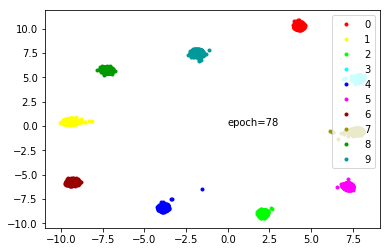

--- epoch 80 ---
--- loss: 0.01539244900457561 % acc: 100.0 %


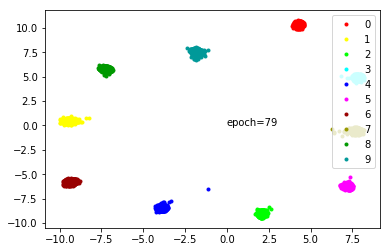

--- epoch 81 ---
--- loss: 0.012104488159529865 % acc: 100.0 %


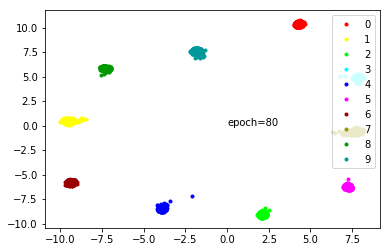

--- epoch 82 ---
--- loss: 0.011094078050615887 % acc: 100.0 %


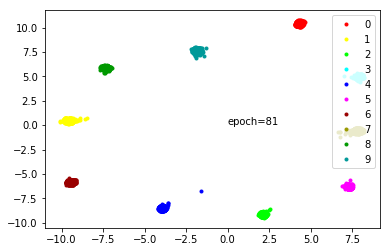

--- epoch 83 ---
--- loss: 0.010702333993588884 % acc: 100.0 %


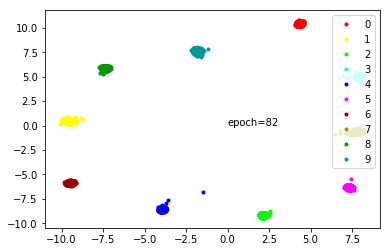

--- epoch 84 ---
--- loss: 0.010565746788245936 % acc: 100.0 %


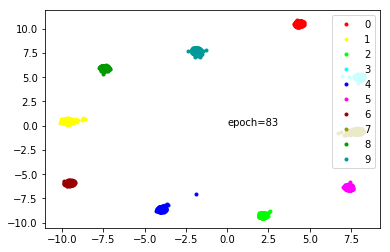

--- epoch 85 ---
--- loss: 0.010536887962371112 % acc: 100.0 %


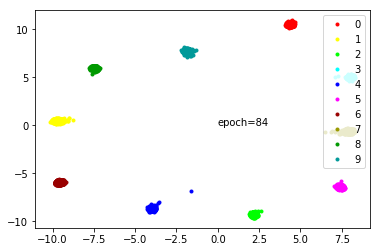

--- epoch 86 ---
--- loss: 0.010381798629338542 % acc: 100.0 %


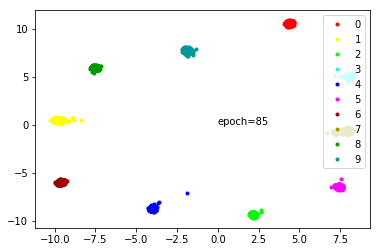

--- epoch 87 ---
--- loss: 0.01002187560002009 % acc: 100.0 %


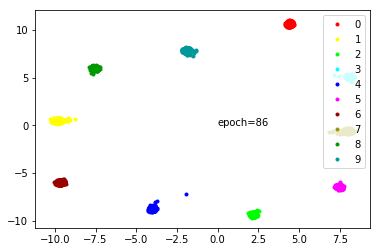

--- epoch 88 ---
--- loss: 0.009795197454902033 % acc: 100.0 %


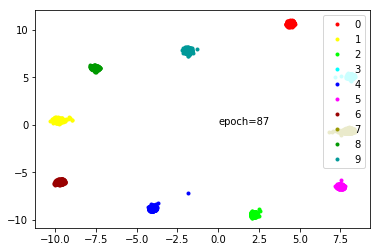

--- epoch 89 ---
--- loss: 0.009869525997589033 % acc: 100.0 %


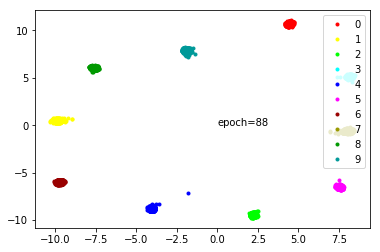

--- epoch 90 ---
--- loss: 0.009770620168807606 % acc: 100.0 %


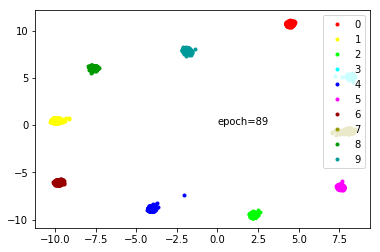

--- epoch 91 ---
--- loss: 0.009953077700920403 % acc: 100.0 %


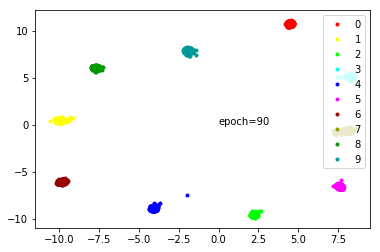

--- epoch 92 ---
--- loss: 0.009446992898980777 % acc: 100.0 %


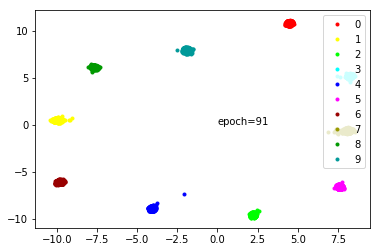

--- epoch 93 ---
--- loss: 0.009101517503149808 % acc: 100.0 %


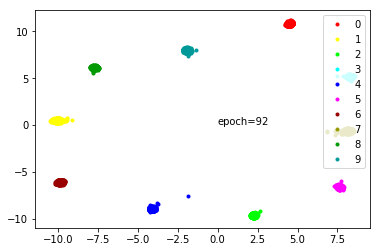

--- epoch 94 ---
--- loss: 0.009086402260387937 % acc: 100.0 %


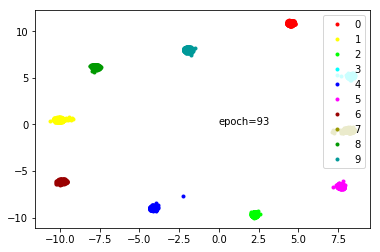

--- epoch 95 ---
--- loss: 0.008618108512212834 % acc: 100.0 %


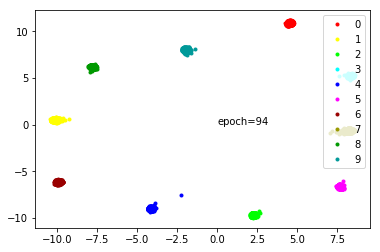

--- epoch 96 ---
--- loss: 0.008559555336832999 % acc: 100.0 %


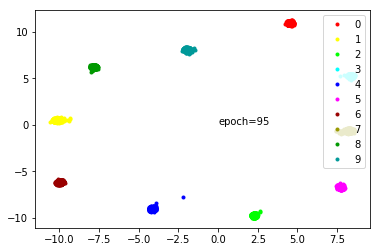

--- epoch 97 ---
--- loss: 0.008880914497810106 % acc: 100.0 %


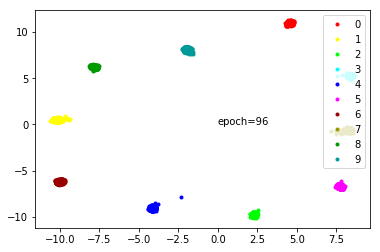

--- epoch 98 ---
--- loss: 0.008877920067558687 % acc: 100.0 %


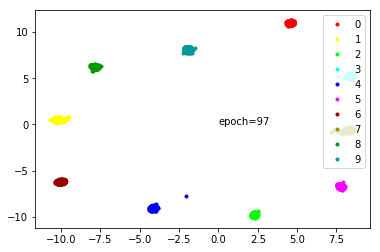

--- epoch 99 ---
--- loss: 0.008858586268809934 % acc: 100.0 %


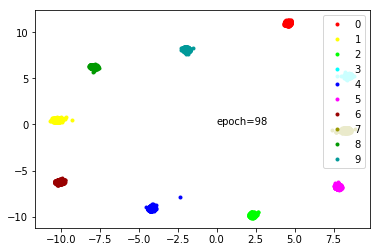

--- epoch 100 ---
--- loss: 0.008418022939004004 % acc: 100.0 %


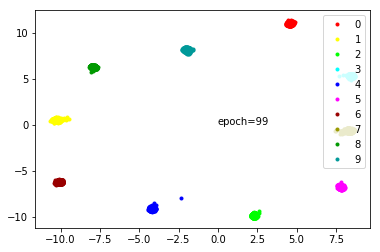

In [15]:
run_model(1, CenterLossAutograd(10, 2).to(device), 'auto_1')

--- epoch 1 ---
--- loss: 1.8211040993531546 % acc: 9.09 %


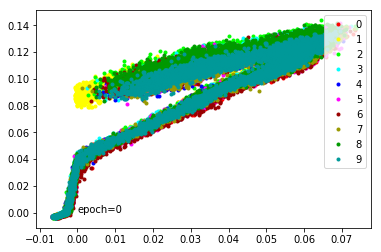

--- epoch 2 ---
--- loss: 1.7966204611460368 % acc: 9.188333333333333 %


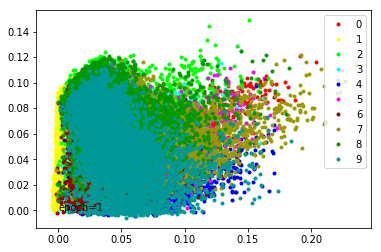

--- epoch 3 ---
--- loss: 1.7175379536549251 % acc: 19.535 %


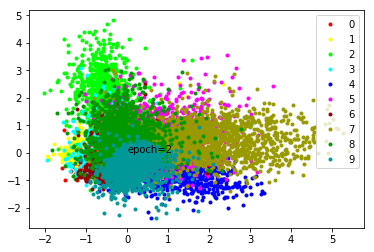

--- epoch 4 ---
--- loss: 1.2591757176319758 % acc: 44.641666666666666 %


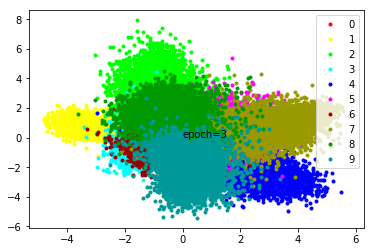

--- epoch 5 ---
--- loss: 0.9456810207168261 % acc: 50.87166666666667 %


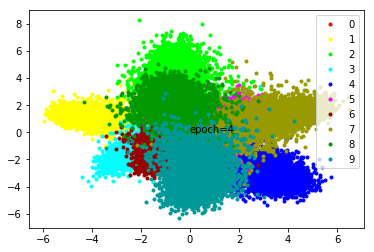

--- epoch 6 ---
--- loss: 0.7804506534337997 % acc: 61.53666666666666 %


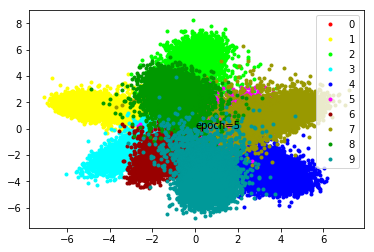

--- epoch 7 ---
--- loss: 0.6545387961467107 % acc: 74.665 %


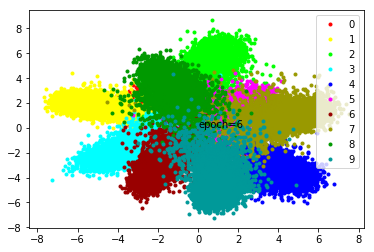

--- epoch 8 ---
--- loss: 0.5528927151362101 % acc: 86.31666666666666 %


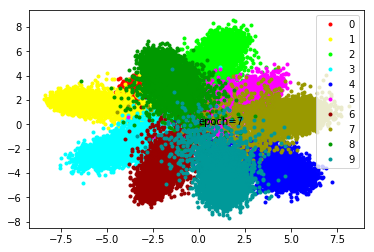

--- epoch 9 ---
--- loss: 0.47279279495279 % acc: 93.53666666666666 %


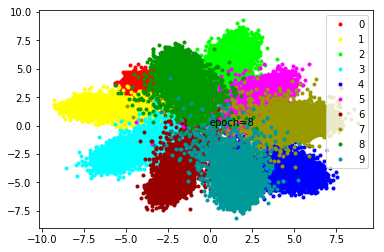

--- epoch 10 ---
--- loss: 0.40894269719719883 % acc: 95.16666666666667 %


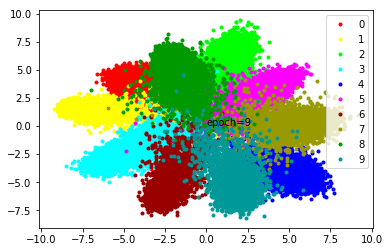

--- epoch 11 ---
--- loss: 0.35554095069567365 % acc: 96.09833333333333 %


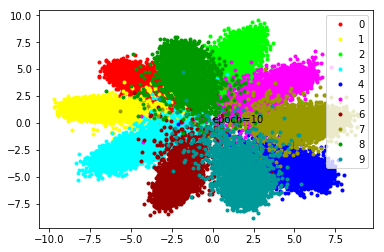

--- epoch 12 ---
--- loss: 0.3172682000199954 % acc: 96.665 %


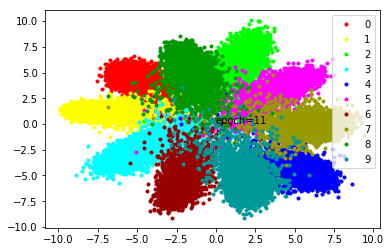

--- epoch 13 ---
--- loss: 0.2829886929442485 % acc: 97.15333333333334 %


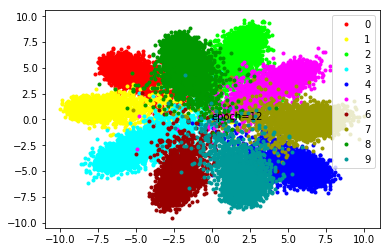

--- epoch 14 ---
--- loss: 0.25113623127341267 % acc: 97.62666666666667 %


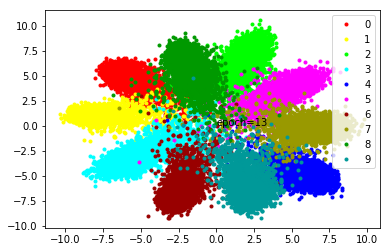

--- epoch 15 ---
--- loss: 0.22899453180531662 % acc: 97.97833333333334 %


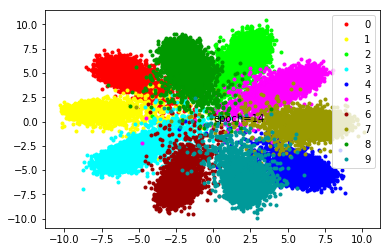

--- epoch 16 ---
--- loss: 0.20469527865449588 % acc: 98.335 %


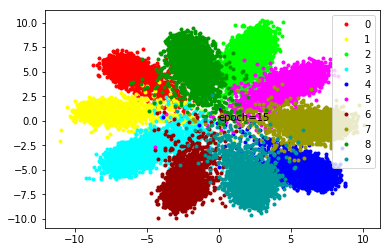

--- epoch 17 ---
--- loss: 0.18475333298246066 % acc: 98.605 %


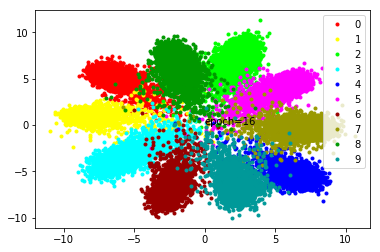

--- epoch 18 ---
--- loss: 0.16801682896912098 % acc: 98.81833333333333 %


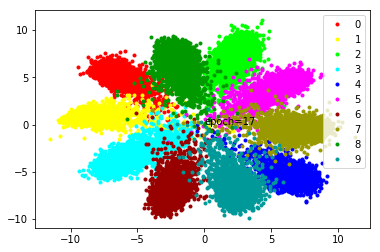

--- epoch 19 ---
--- loss: 0.15295879803597928 % acc: 99.01666666666667 %


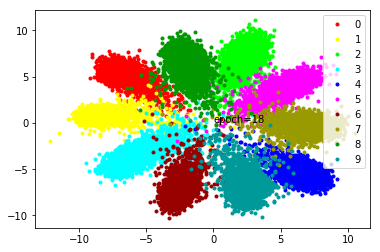

--- epoch 20 ---
--- loss: 0.13848920228580633 % acc: 99.22166666666666 %


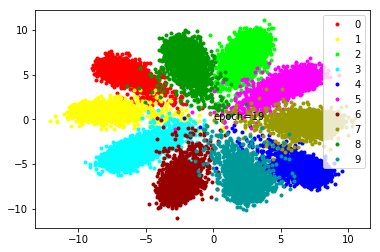

--- epoch 21 ---
--- loss: 0.11993894396970668 % acc: 99.43166666666666 %


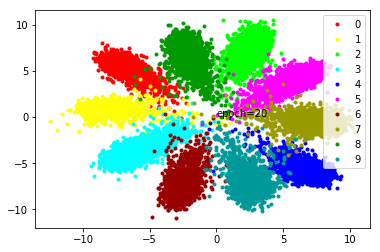

--- epoch 22 ---
--- loss: 0.10971042489012083 % acc: 99.52833333333334 %


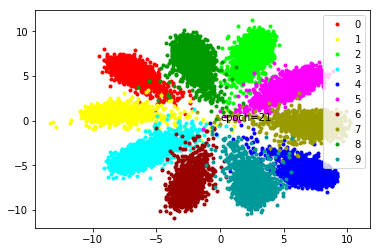

--- epoch 23 ---
--- loss: 0.10241845219085613 % acc: 99.65333333333334 %


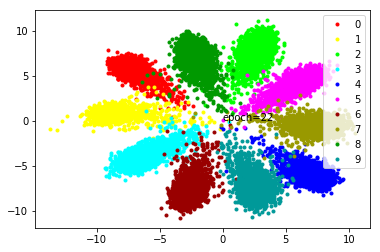

--- epoch 24 ---
--- loss: 0.09374180054912964 % acc: 99.71 %


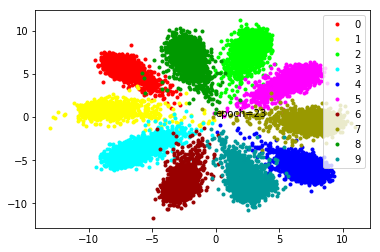

--- epoch 25 ---
--- loss: 0.08817664828151464 % acc: 99.76666666666667 %


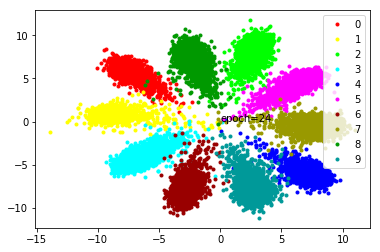

--- epoch 26 ---
--- loss: 0.08393100266655286 % acc: 99.79333333333334 %


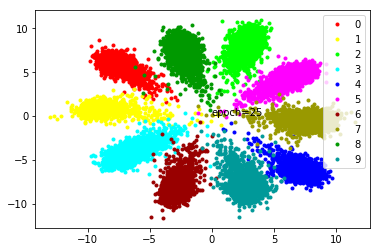

--- epoch 27 ---
--- loss: 0.07742549382150174 % acc: 99.84333333333333 %


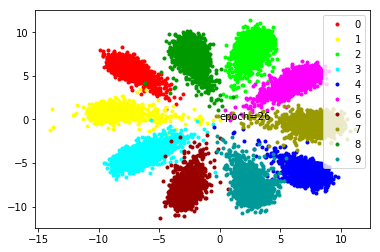

--- epoch 28 ---
--- loss: 0.07290642984211446 % acc: 99.88333333333334 %


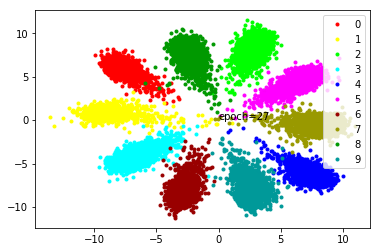

--- epoch 29 ---
--- loss: 0.0683187326292197 % acc: 99.9 %


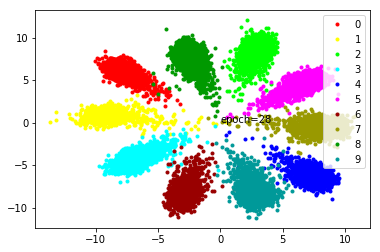

--- epoch 30 ---
--- loss: 0.06582295795281728 % acc: 99.92833333333333 %


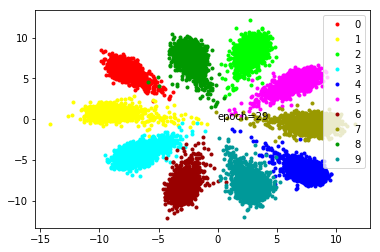

--- epoch 31 ---
--- loss: 0.061656833930561934 % acc: 99.92999999999999 %


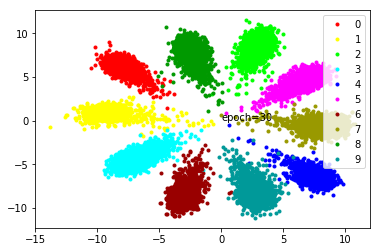

--- epoch 32 ---
--- loss: 0.05773761479804913 % acc: 99.95333333333333 %


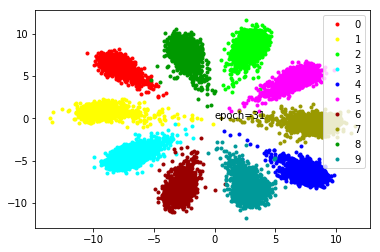

--- epoch 33 ---
--- loss: 0.0545362068216006 % acc: 99.96166666666667 %


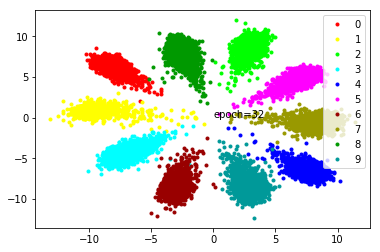

--- epoch 34 ---
--- loss: 0.05185387828697761 % acc: 99.96333333333334 %


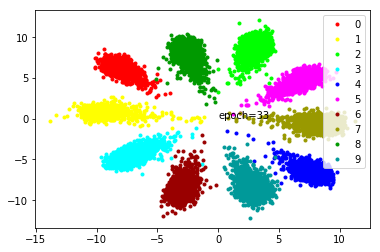

--- epoch 35 ---
--- loss: 0.04983155395214756 % acc: 99.97 %


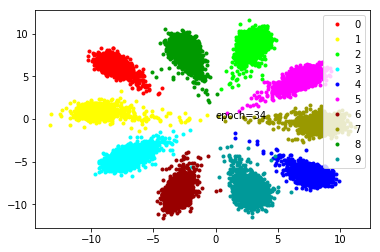

--- epoch 36 ---
--- loss: 0.04702904548496008 % acc: 99.98166666666667 %


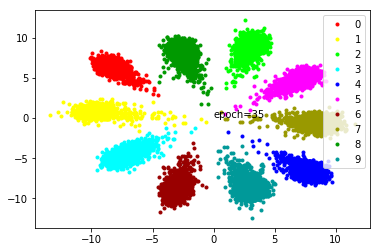

--- epoch 37 ---
--- loss: 0.045456643011420966 % acc: 99.98 %


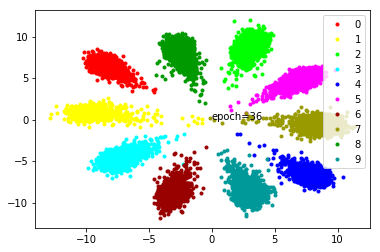

--- epoch 38 ---
--- loss: 0.04348075882221262 % acc: 99.98833333333333 %


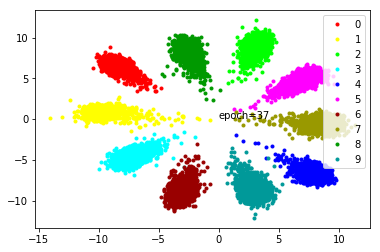

--- epoch 39 ---
--- loss: 0.04105914946645499 % acc: 99.98833333333333 %


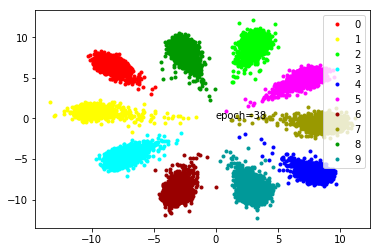

--- epoch 40 ---
--- loss: 0.04014483243227005 % acc: 99.98833333333333 %


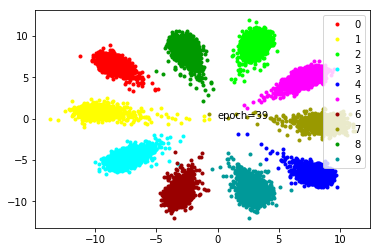

--- epoch 41 ---
--- loss: 0.03620970801760753 % acc: 99.995 %


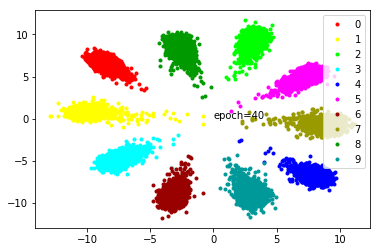

--- epoch 42 ---
--- loss: 0.03388799459052583 % acc: 99.99666666666667 %


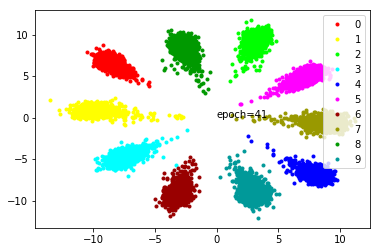

--- epoch 43 ---
--- loss: 0.032807131422062714 % acc: 100.0 %


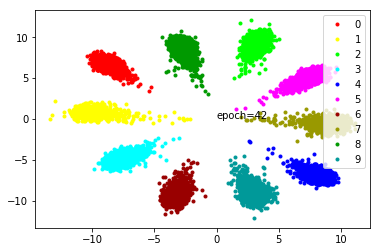

--- epoch 44 ---
--- loss: 0.03181375252082944 % acc: 99.99666666666667 %


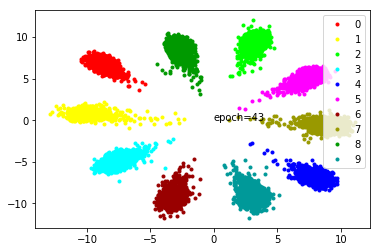

--- epoch 45 ---
--- loss: 0.03081596209978064 % acc: 99.99833333333333 %


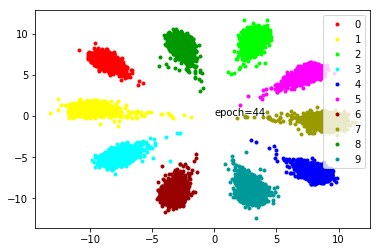

--- epoch 46 ---
--- loss: 0.02974130665572981 % acc: 100.0 %


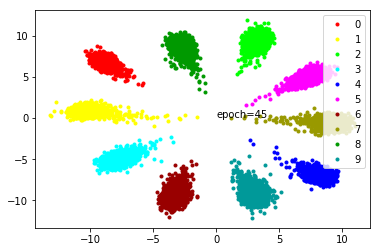

--- epoch 47 ---
--- loss: 0.02902525790656606 % acc: 100.0 %


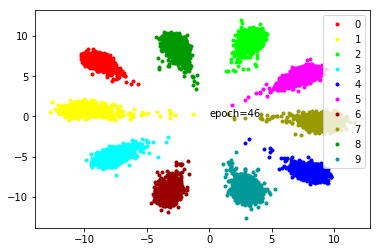

--- epoch 48 ---
--- loss: 0.028111357465386393 % acc: 99.99833333333333 %


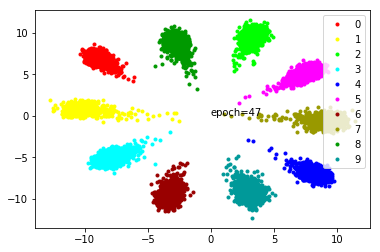

--- epoch 49 ---
--- loss: 0.027147961603477596 % acc: 100.0 %


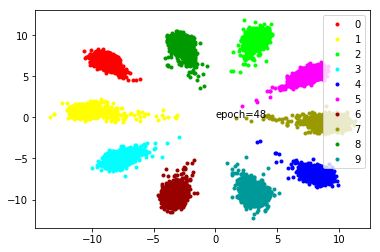

--- epoch 50 ---
--- loss: 0.026361171404520673 % acc: 99.99833333333333 %


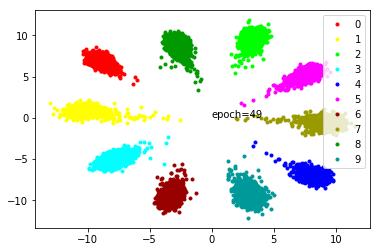

--- epoch 51 ---
--- loss: 0.025369614514832693 % acc: 100.0 %


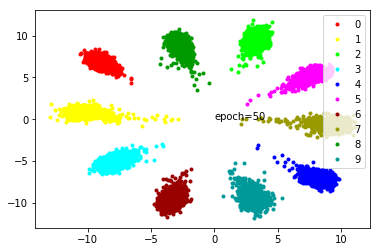

--- epoch 52 ---
--- loss: 0.0245097768958658 % acc: 100.0 %


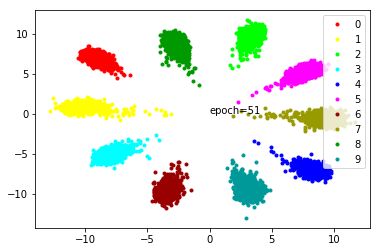

--- epoch 53 ---
--- loss: 0.02409629926706354 % acc: 100.0 %


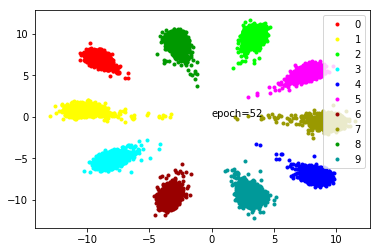

--- epoch 54 ---
--- loss: 0.023387822148700554 % acc: 100.0 %


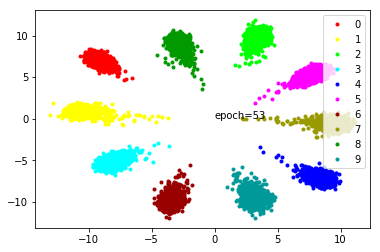

--- epoch 55 ---
--- loss: 0.02296903304134806 % acc: 100.0 %


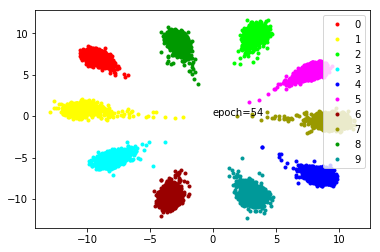

--- epoch 56 ---
--- loss: 0.02219176319738229 % acc: 100.0 %


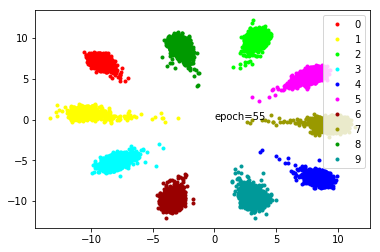

--- epoch 57 ---
--- loss: 0.021966103976592422 % acc: 100.0 %


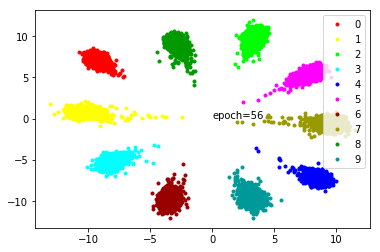

--- epoch 58 ---
--- loss: 0.021371300080791116 % acc: 100.0 %


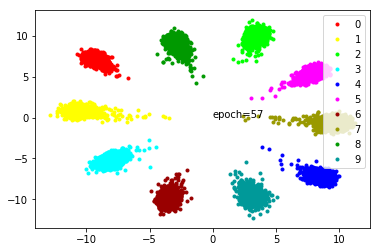

--- epoch 59 ---
--- loss: 0.02097077725144724 % acc: 100.0 %


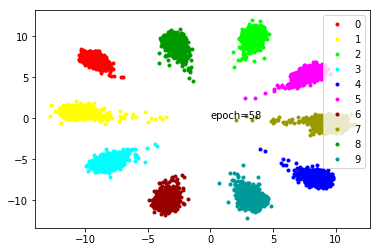

--- epoch 60 ---
--- loss: 0.01995695950773855 % acc: 100.0 %


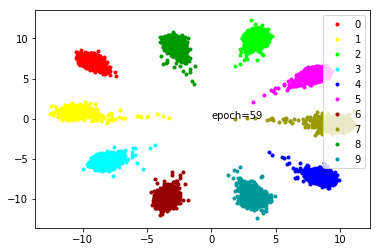

--- epoch 61 ---
--- loss: 0.018451181600491206 % acc: 100.0 %


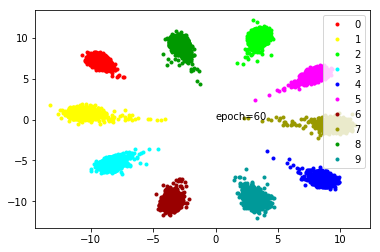

--- epoch 62 ---
--- loss: 0.01795536085963249 % acc: 100.0 %


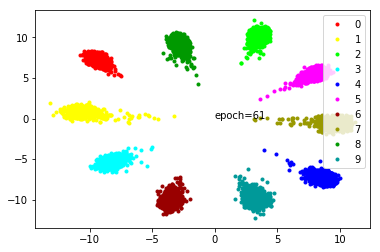

--- epoch 63 ---
--- loss: 0.01751604673763116 % acc: 100.0 %


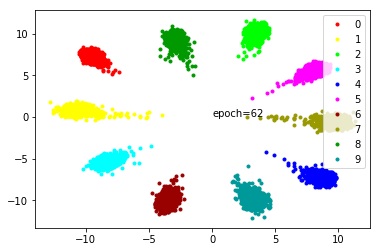

--- epoch 64 ---
--- loss: 0.017264512504140538 % acc: 100.0 %


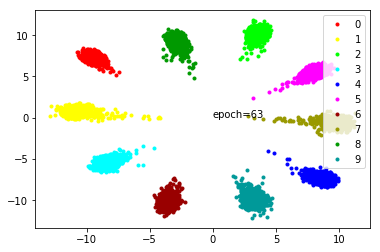

--- epoch 65 ---
--- loss: 0.01673627596658965 % acc: 100.0 %


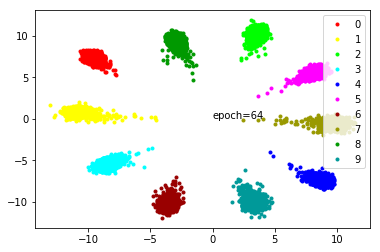

--- epoch 66 ---
--- loss: 0.01640253059876462 % acc: 100.0 %


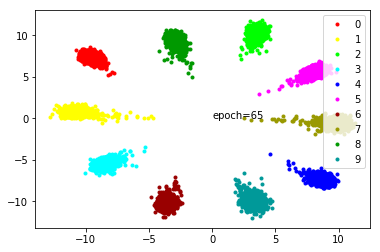

--- epoch 67 ---
--- loss: 0.01632077100686729 % acc: 100.0 %


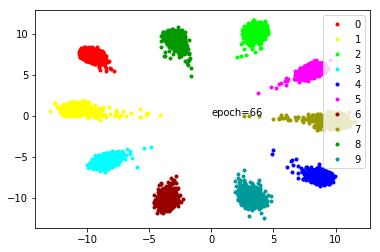

--- epoch 68 ---
--- loss: 0.015837227689723173 % acc: 100.0 %


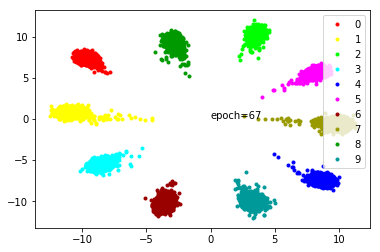

--- epoch 69 ---
--- loss: 0.01557716692487399 % acc: 100.0 %


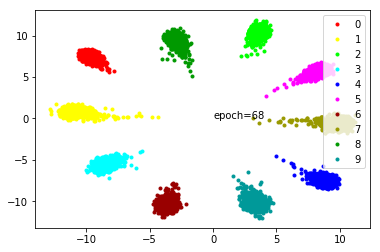

--- epoch 70 ---
--- loss: 0.01507251366196821 % acc: 100.0 %


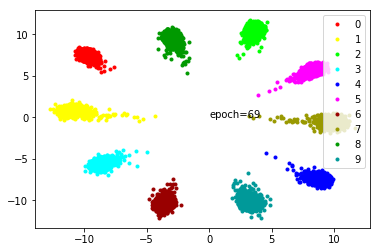

--- epoch 71 ---
--- loss: 0.015113654675272602 % acc: 100.0 %


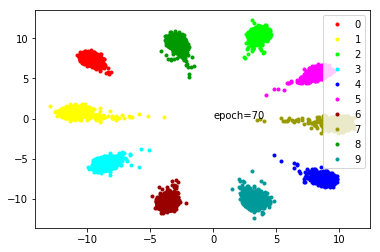

--- epoch 72 ---
--- loss: 0.0146233471777911 % acc: 100.0 %


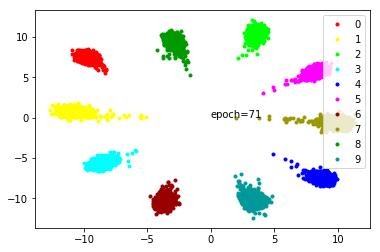

--- epoch 73 ---
--- loss: 0.014456505396713814 % acc: 100.0 %


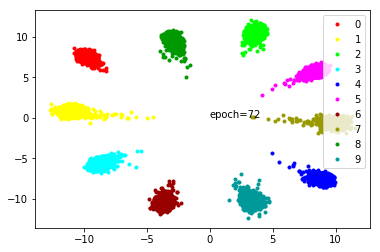

--- epoch 74 ---
--- loss: 0.014221419625294704 % acc: 100.0 %


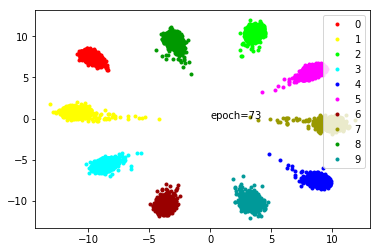

--- epoch 75 ---
--- loss: 0.014030487847824891 % acc: 100.0 %


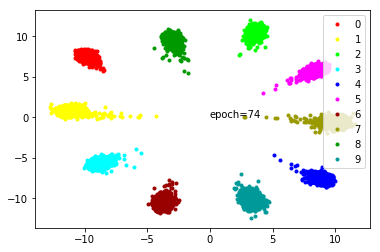

--- epoch 76 ---
--- loss: 0.013661115925448636 % acc: 100.0 %


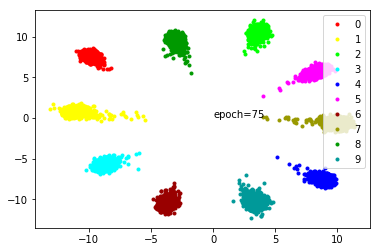

--- epoch 77 ---
--- loss: 0.013359364019706844 % acc: 100.0 %


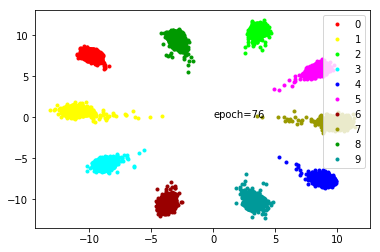

--- epoch 78 ---
--- loss: 0.013347738380543888 % acc: 100.0 %


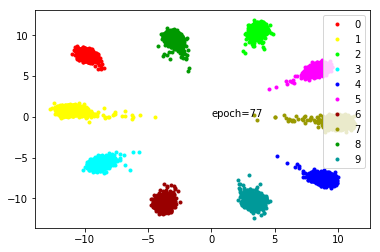

--- epoch 79 ---
--- loss: 0.012995996445727845 % acc: 100.0 %


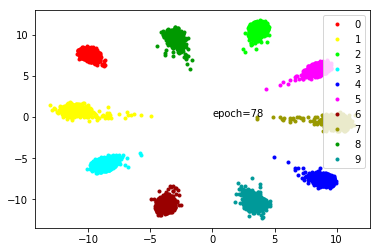

--- epoch 80 ---
--- loss: 0.012854280788451432 % acc: 100.0 %


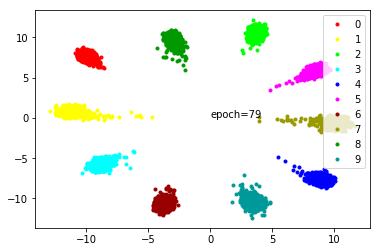

--- epoch 81 ---
--- loss: 0.011936832605861128 % acc: 100.0 %


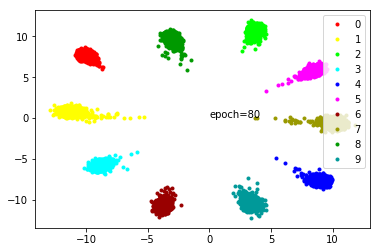

--- epoch 82 ---
--- loss: 0.01156164813786745 % acc: 100.0 %


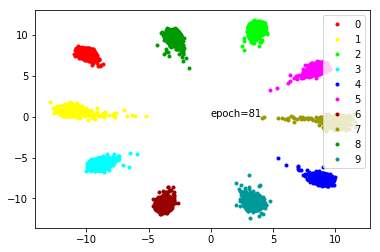

--- epoch 83 ---
--- loss: 0.01142209431932618 % acc: 100.0 %


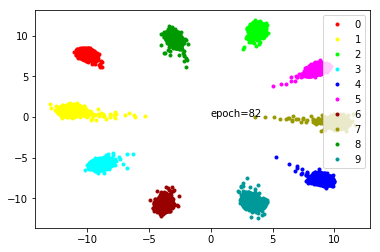

--- epoch 84 ---
--- loss: 0.011310589124138157 % acc: 100.0 %


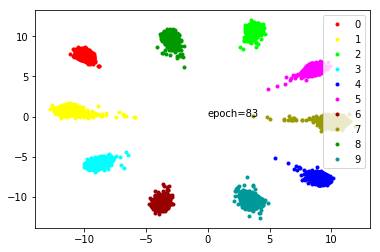

--- epoch 85 ---
--- loss: 0.011166021873553594 % acc: 100.0 %


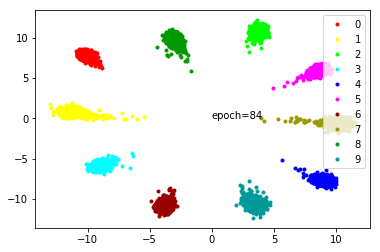

--- epoch 86 ---
--- loss: 0.010898585985414684 % acc: 100.0 %


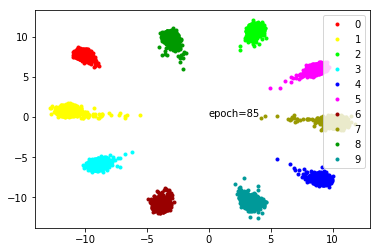

--- epoch 87 ---
--- loss: 0.010902541074901819 % acc: 100.0 %


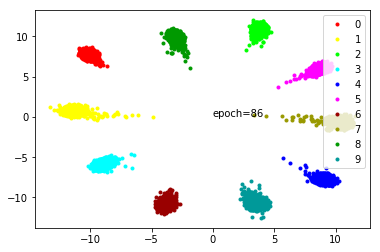

--- epoch 88 ---
--- loss: 0.010660545042095085 % acc: 100.0 %


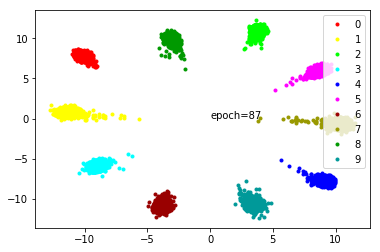

--- epoch 89 ---
--- loss: 0.010542508009821178 % acc: 100.0 %


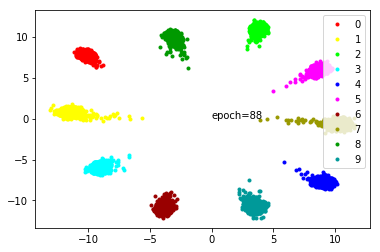

--- epoch 90 ---
--- loss: 0.010324535639956594 % acc: 100.0 %


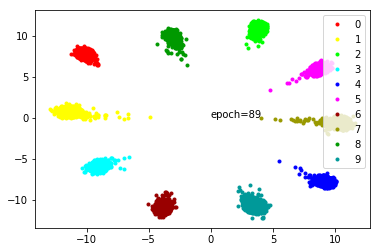

--- epoch 91 ---
--- loss: 0.010181294515108068 % acc: 100.0 %


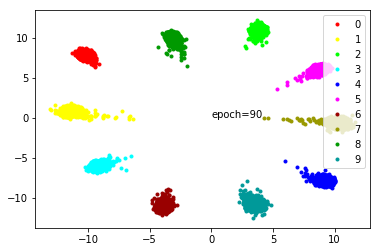

--- epoch 92 ---
--- loss: 0.010075798314064742 % acc: 100.0 %


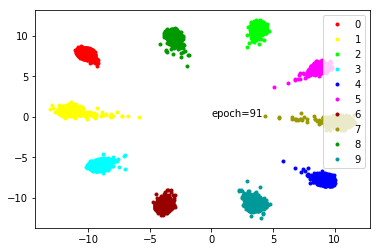

--- epoch 93 ---
--- loss: 0.010059683664391438 % acc: 100.0 %


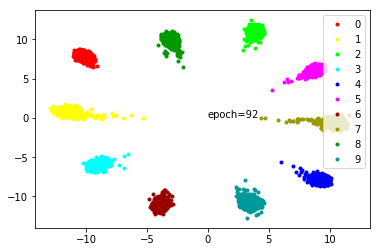

--- epoch 94 ---
--- loss: 0.009908591327257453 % acc: 100.0 %


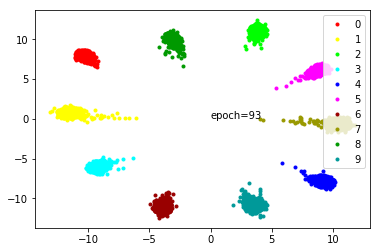

--- epoch 95 ---
--- loss: 0.00964752956914405 % acc: 100.0 %


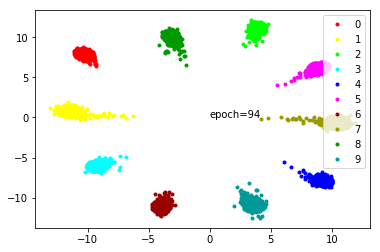

--- epoch 96 ---
--- loss: 0.009678569588189323 % acc: 100.0 %


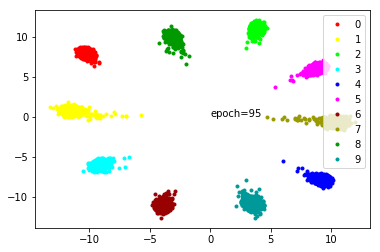

--- epoch 97 ---
--- loss: 0.009428617283701896 % acc: 100.0 %


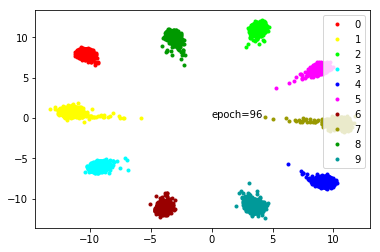

--- epoch 98 ---
--- loss: 0.009314160586024323 % acc: 100.0 %


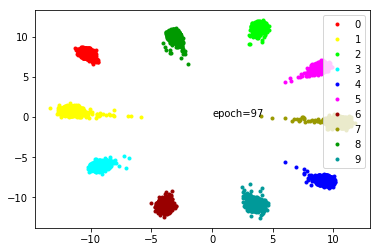

--- epoch 99 ---
--- loss: 0.009306570840999484 % acc: 100.0 %


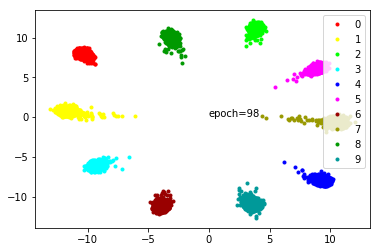

--- epoch 100 ---
--- loss: 0.009012124344396095 % acc: 100.0 %


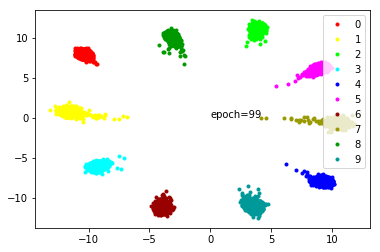

In [11]:
run_model(0.1, CenterLoss(10, 2).to(device), 'paper_0.1')

--- epoch 1 ---
--- loss: 1.8808689785003663 % acc: 9.853333333333333 %


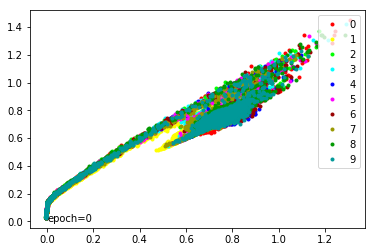

--- epoch 2 ---
--- loss: 1.779426535367966 % acc: 13.191666666666665 %


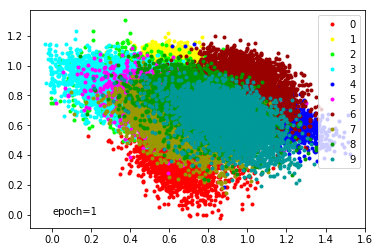

--- epoch 3 ---
--- loss: 1.6821086156368255 % acc: 30.3 %


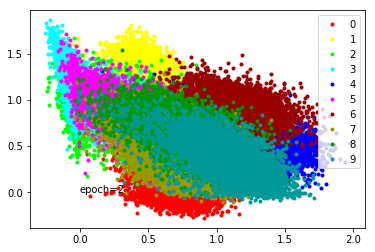

--- epoch 4 ---
--- loss: 1.5423279855648677 % acc: 39.413333333333334 %


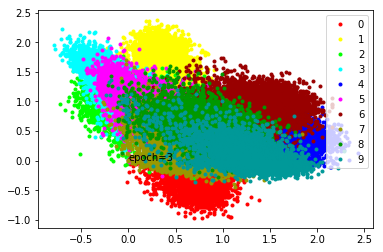

--- epoch 5 ---
--- loss: 1.386500483949979 % acc: 45.90166666666667 %


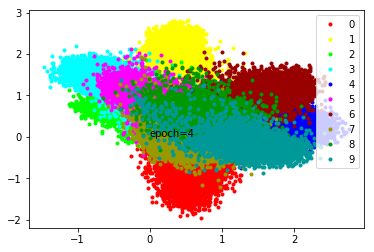

--- epoch 6 ---
--- loss: 1.2170006688435873 % acc: 56.18 %


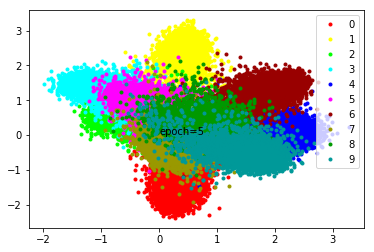

--- epoch 7 ---
--- loss: 1.0661196462313334 % acc: 58.30833333333333 %


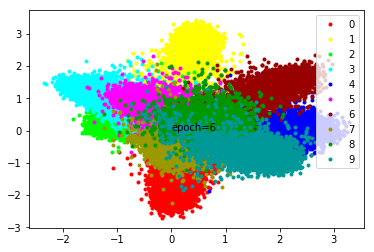

--- epoch 8 ---
--- loss: 0.9517242499192555 % acc: 59.17333333333333 %


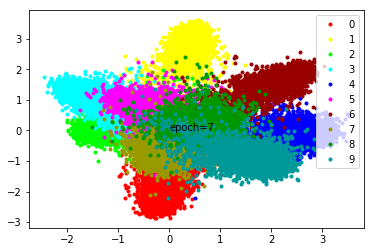

--- epoch 9 ---
--- loss: 0.8583815682927768 % acc: 65.26666666666667 %


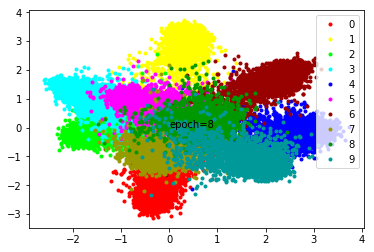

--- epoch 10 ---
--- loss: 0.7797328559557597 % acc: 69.09833333333333 %


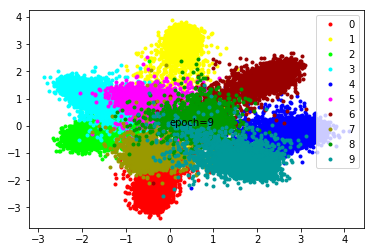

--- epoch 11 ---
--- loss: 0.7173493953545889 % acc: 69.51833333333333 %


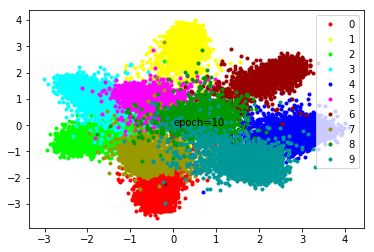

--- epoch 12 ---
--- loss: 0.6616654852032661 % acc: 70.51833333333335 %


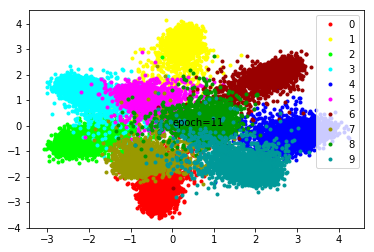

--- epoch 13 ---
--- loss: 0.6145526825388272 % acc: 75.655 %


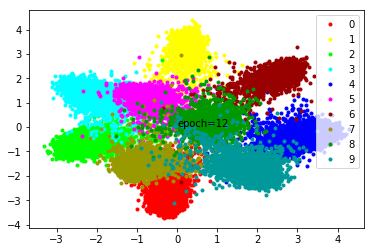

--- epoch 14 ---
--- loss: 0.5730056890845299 % acc: 79.35 %


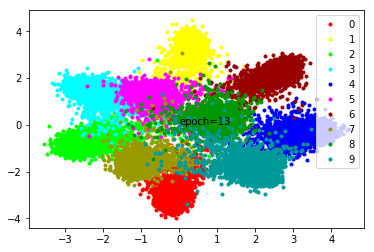

--- epoch 15 ---
--- loss: 0.5348150887091955 % acc: 80.83833333333334 %


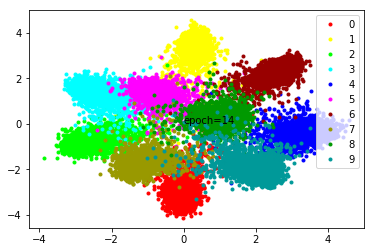

--- epoch 16 ---
--- loss: 0.4977564214666685 % acc: 84.71 %


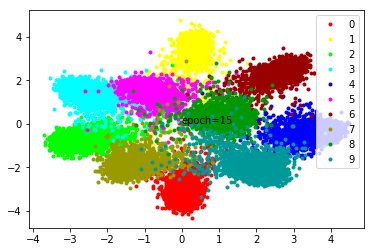

--- epoch 17 ---
--- loss: 0.46505563378334047 % acc: 87.51166666666667 %


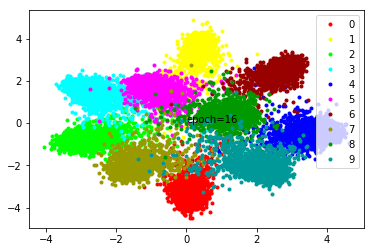

--- epoch 18 ---
--- loss: 0.43549657672643666 % acc: 88.55 %


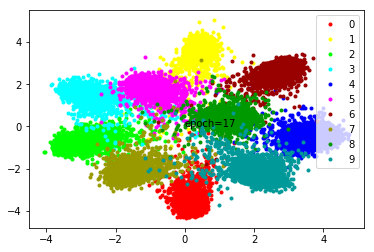

--- epoch 19 ---
--- loss: 0.40930649265646935 % acc: 89.125 %


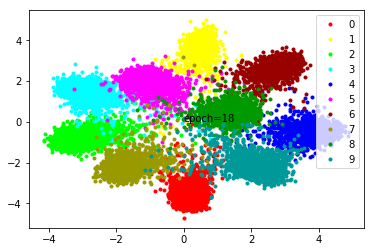

--- epoch 20 ---
--- loss: 0.3840252922475338 % acc: 91.19500000000001 %


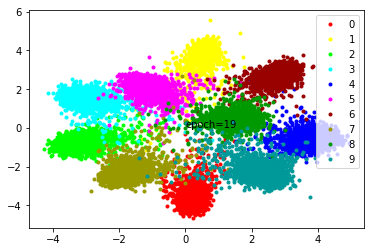

--- epoch 21 ---
--- loss: 0.3525035943587621 % acc: 94.63333333333334 %


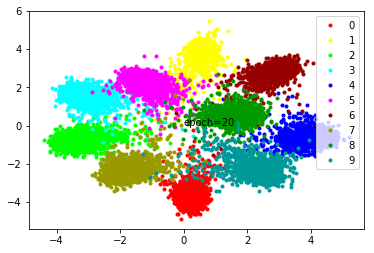

--- epoch 22 ---
--- loss: 0.33244575818379724 % acc: 97.00833333333333 %


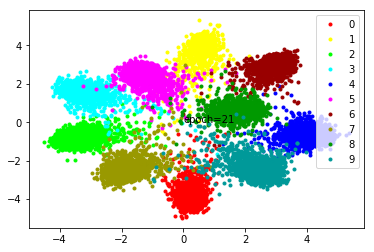

--- epoch 23 ---
--- loss: 0.31259031876921656 % acc: 98.26 %


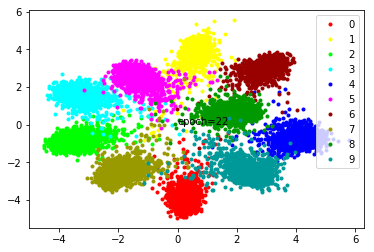

--- epoch 24 ---
--- loss: 0.2989924265940984 % acc: 98.77 %


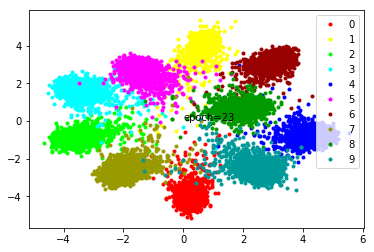

--- epoch 25 ---
--- loss: 0.27892707362771035 % acc: 99.16666666666667 %


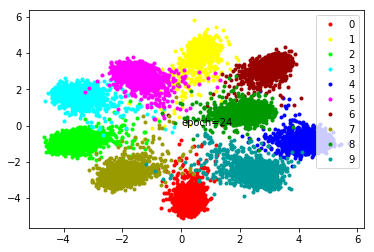

--- epoch 26 ---
--- loss: 0.2629754819472631 % acc: 99.39833333333333 %


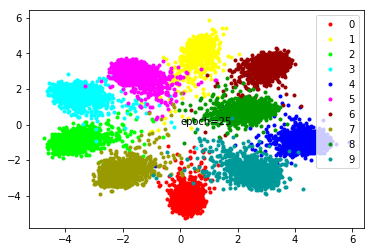

--- epoch 27 ---
--- loss: 0.24787700300415355 % acc: 99.50333333333333 %


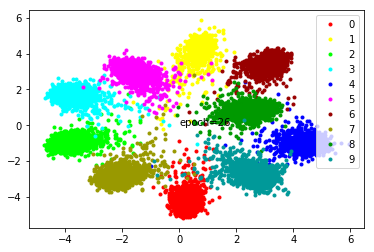

--- epoch 28 ---
--- loss: 0.23421272630492845 % acc: 99.61333333333333 %


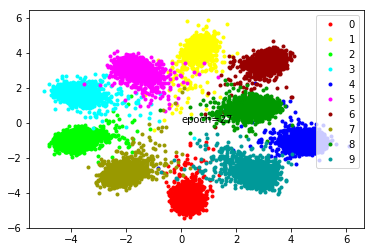

--- epoch 29 ---
--- loss: 0.22069877619544667 % acc: 99.665 %


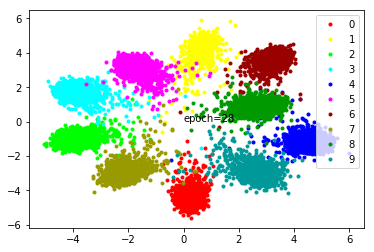

--- epoch 30 ---
--- loss: 0.20878233733276524 % acc: 99.69833333333334 %


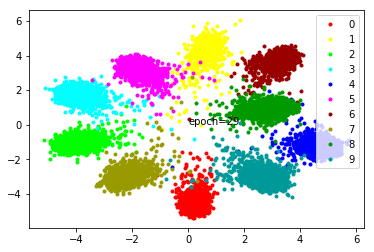

--- epoch 31 ---
--- loss: 0.19557715435822806 % acc: 99.73333333333333 %


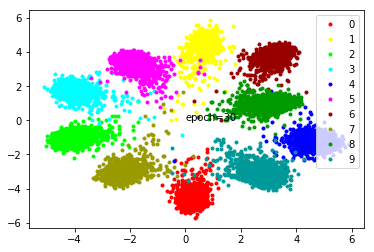

--- epoch 32 ---
--- loss: 0.18456348915894827 % acc: 99.79166666666667 %


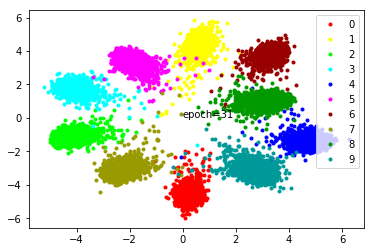

--- epoch 33 ---
--- loss: 0.1746745555847883 % acc: 99.84166666666667 %


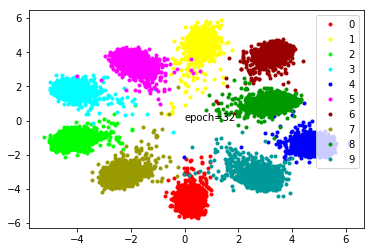

--- epoch 34 ---
--- loss: 0.16622650360067687 % acc: 99.84666666666666 %


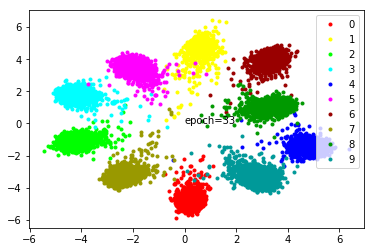

--- epoch 35 ---
--- loss: 0.154308103621006 % acc: 99.87166666666667 %


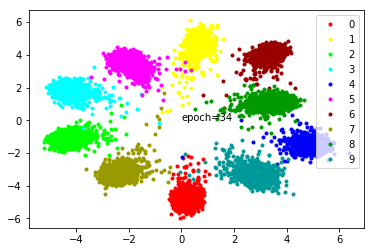

--- epoch 36 ---
--- loss: 0.1465591497719288 % acc: 99.89 %


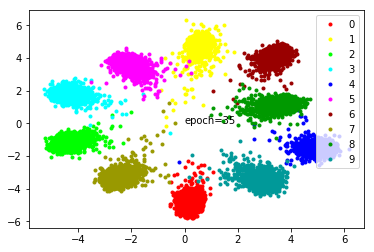

--- epoch 37 ---
--- loss: 0.13902167148888112 % acc: 99.91499999999999 %


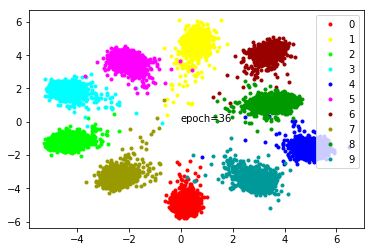

--- epoch 38 ---
--- loss: 0.13197379981478055 % acc: 99.92166666666667 %


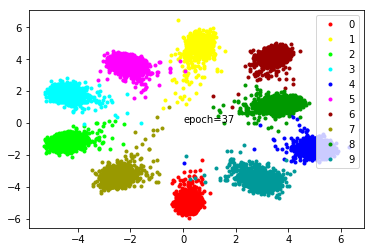

--- epoch 39 ---
--- loss: 0.127903358861804 % acc: 99.92999999999999 %


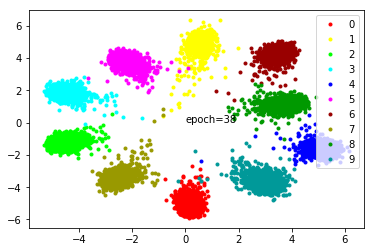

--- epoch 40 ---
--- loss: 0.11887539880971114 % acc: 99.94166666666666 %


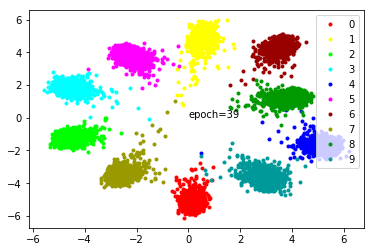

--- epoch 41 ---
--- loss: 0.10656006205826997 % acc: 99.95333333333333 %


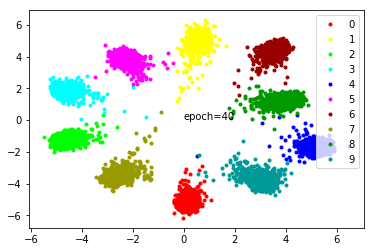

--- epoch 42 ---
--- loss: 0.10178236470868189 % acc: 99.96333333333334 %


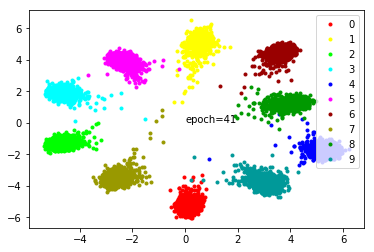

--- epoch 43 ---
--- loss: 0.0952021126821637 % acc: 99.965 %


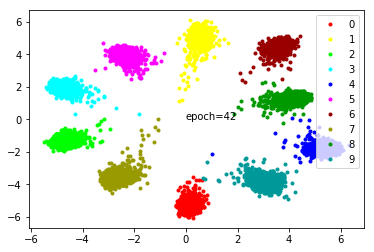

--- epoch 44 ---
--- loss: 0.09192566478004058 % acc: 99.97833333333334 %


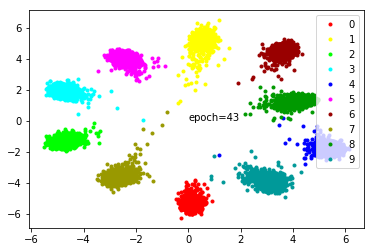

--- epoch 45 ---
--- loss: 0.08782515361905098 % acc: 99.98666666666666 %


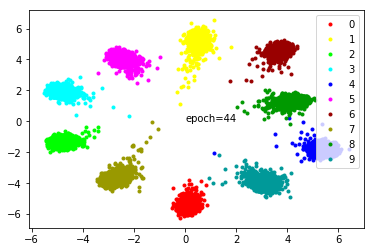

--- epoch 46 ---
--- loss: 0.08422026050587496 % acc: 99.98666666666666 %


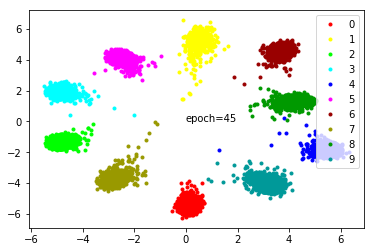

--- epoch 47 ---
--- loss: 0.08081818856298924 % acc: 99.985 %


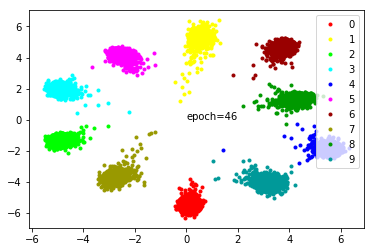

--- epoch 48 ---
--- loss: 0.07783060138424237 % acc: 99.98833333333333 %


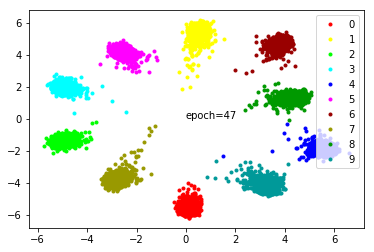

--- epoch 49 ---
--- loss: 0.0749901452784737 % acc: 99.99166666666667 %


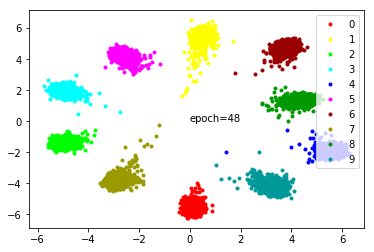

--- epoch 50 ---
--- loss: 0.07185254431019227 % acc: 99.99166666666667 %


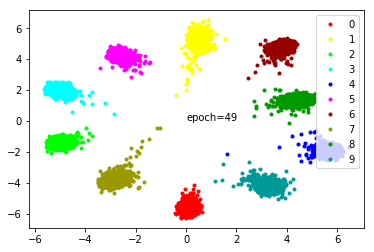

--- epoch 51 ---
--- loss: 0.06971829616775116 % acc: 99.99166666666667 %


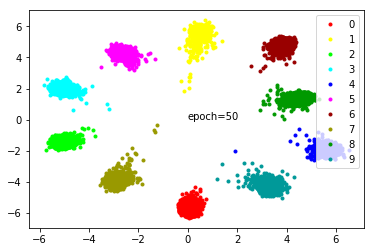

--- epoch 52 ---
--- loss: 0.06681137689699729 % acc: 99.995 %


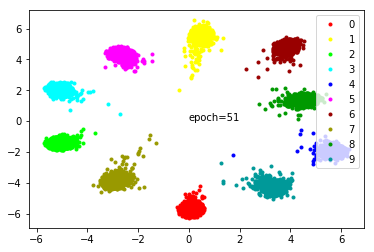

--- epoch 53 ---
--- loss: 0.06470691315829755 % acc: 99.99666666666667 %


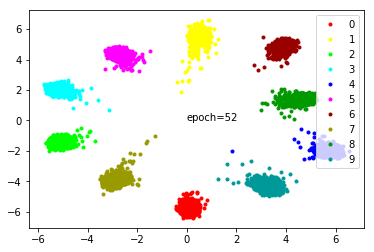

--- epoch 54 ---
--- loss: 0.06252616609136263 % acc: 99.99333333333334 %


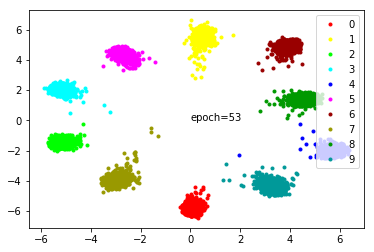

--- epoch 55 ---
--- loss: 0.06083813125888507 % acc: 99.995 %


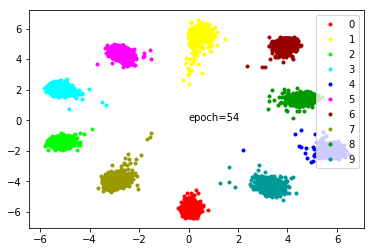

--- epoch 56 ---
--- loss: 0.058059829324483864 % acc: 99.99833333333333 %


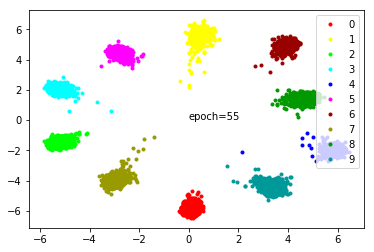

--- epoch 57 ---
--- loss: 0.05679904709880551 % acc: 99.99666666666667 %


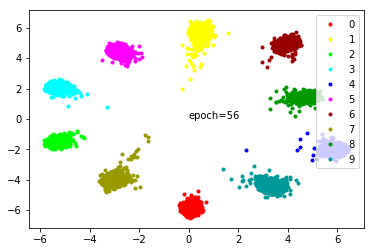

--- epoch 58 ---
--- loss: 0.054542519208043816 % acc: 99.99833333333333 %


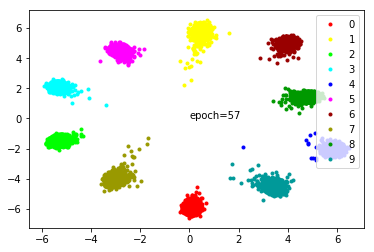

--- epoch 59 ---
--- loss: 0.05230190414314468 % acc: 99.99833333333333 %


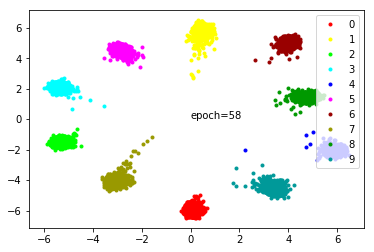

--- epoch 60 ---
--- loss: 0.052848693107565244 % acc: 99.99666666666667 %


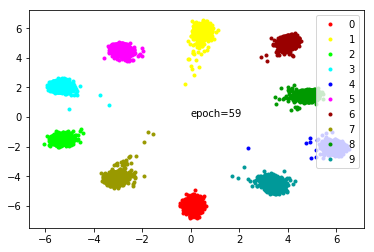

--- epoch 61 ---
--- loss: 0.04621083161483208 % acc: 100.0 %


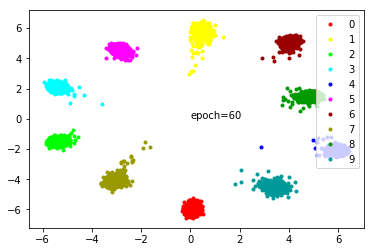

--- epoch 62 ---
--- loss: 0.04418813621625304 % acc: 99.99833333333333 %


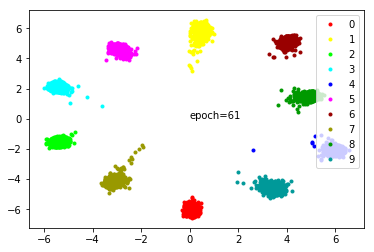

--- epoch 63 ---
--- loss: 0.0423872444840769 % acc: 100.0 %


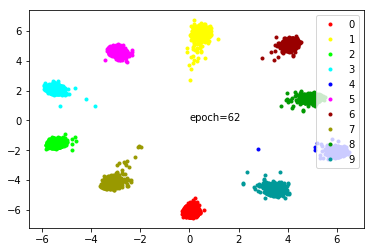

--- epoch 64 ---
--- loss: 0.04204550419002771 % acc: 99.99833333333333 %


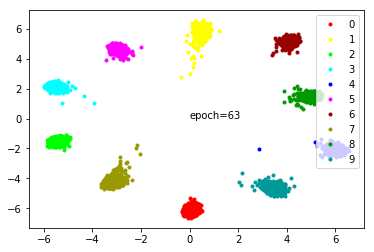

--- epoch 65 ---
--- loss: 0.04049178317189217 % acc: 99.99833333333333 %


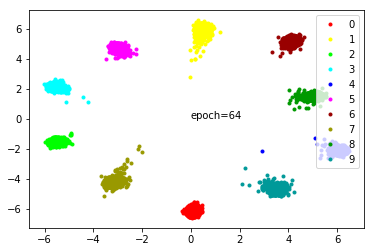

--- epoch 66 ---
--- loss: 0.0392933000313739 % acc: 100.0 %


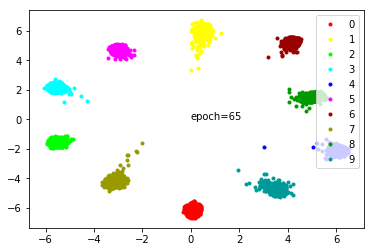

--- epoch 67 ---
--- loss: 0.0384752670985957 % acc: 100.0 %


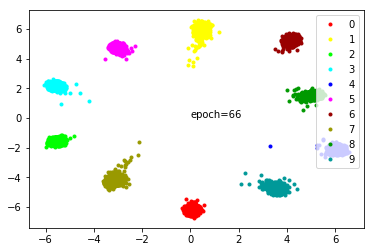

--- epoch 68 ---
--- loss: 0.03741273334249854 % acc: 100.0 %


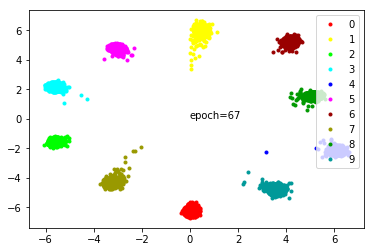

--- epoch 69 ---
--- loss: 0.0364747313161691 % acc: 100.0 %


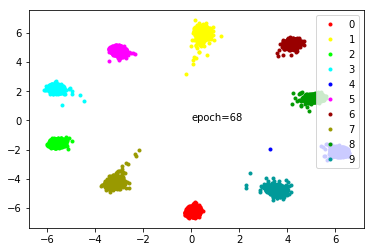

--- epoch 70 ---
--- loss: 0.03518038077900807 % acc: 100.0 %


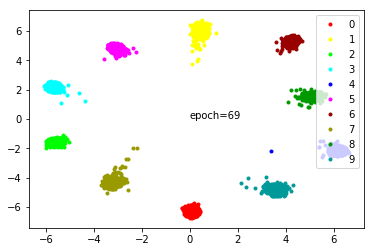

--- epoch 71 ---
--- loss: 0.03449624824648102 % acc: 100.0 %


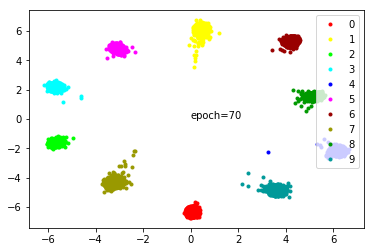

--- epoch 72 ---
--- loss: 0.03353311512619257 % acc: 100.0 %


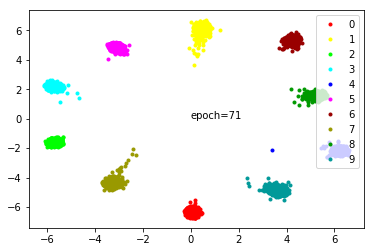

--- epoch 73 ---
--- loss: 0.03348325556765 % acc: 100.0 %


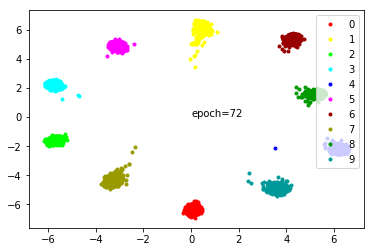

--- epoch 74 ---
--- loss: 0.03251891199499368 % acc: 100.0 %


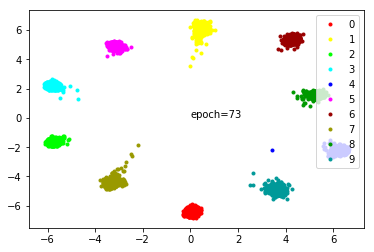

--- epoch 75 ---
--- loss: 0.031823543614397445 % acc: 100.0 %


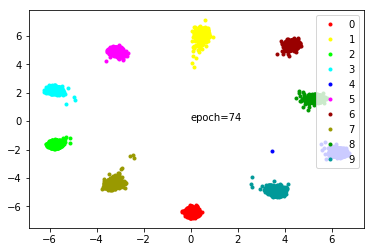

--- epoch 76 ---
--- loss: 0.03108794546375672 % acc: 100.0 %


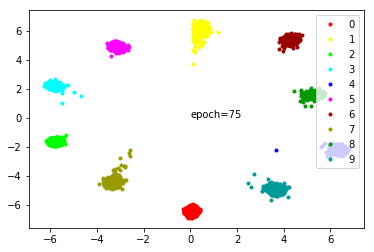

--- epoch 77 ---
--- loss: 0.03058953510597348 % acc: 100.0 %


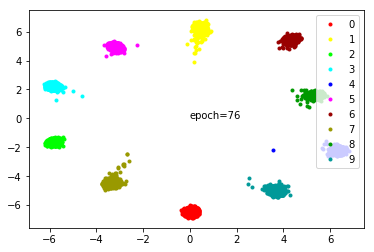

--- epoch 78 ---
--- loss: 0.03030846088503798 % acc: 100.0 %


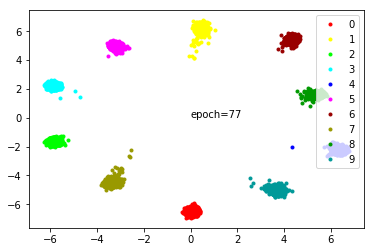

--- epoch 79 ---
--- loss: 0.029418014977127312 % acc: 100.0 %


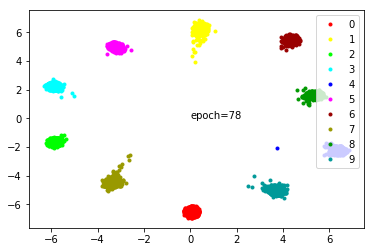

--- epoch 80 ---
--- loss: 0.028774094395339487 % acc: 100.0 %


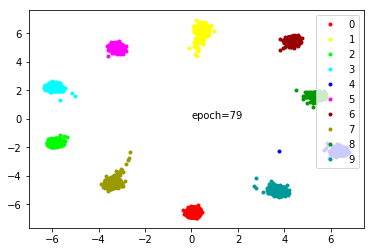

--- epoch 81 ---
--- loss: 0.026659029917791486 % acc: 100.0 %


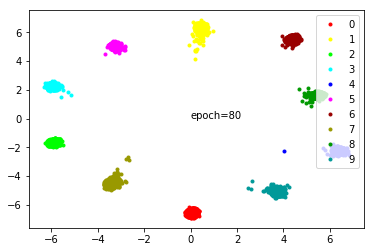

--- epoch 82 ---
--- loss: 0.02539375724891822 % acc: 100.0 %


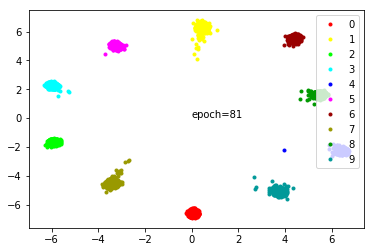

--- epoch 83 ---
--- loss: 0.025423463797196746 % acc: 100.0 %


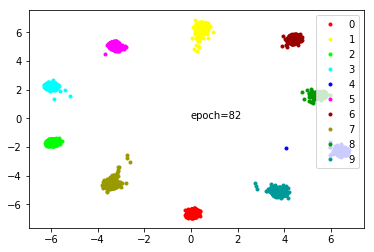

--- epoch 84 ---
--- loss: 0.02442939840257168 % acc: 100.0 %


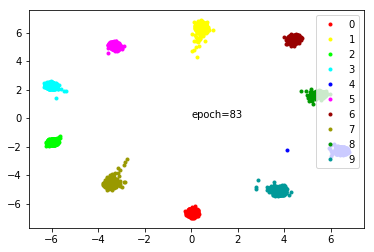

--- epoch 85 ---
--- loss: 0.024295122955615322 % acc: 100.0 %


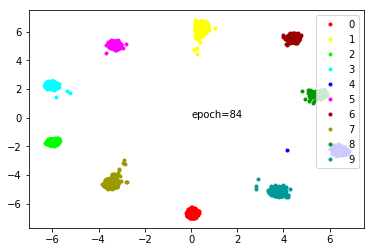

--- epoch 86 ---
--- loss: 0.0237796744517982 % acc: 100.0 %


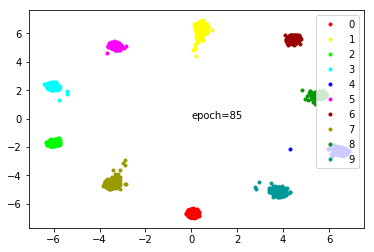

--- epoch 87 ---
--- loss: 0.023309069983661175 % acc: 100.0 %


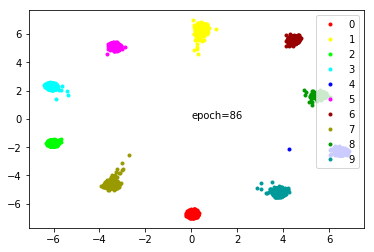

--- epoch 88 ---
--- loss: 0.02297102576432129 % acc: 100.0 %


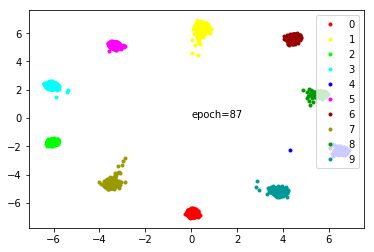

--- epoch 89 ---
--- loss: 0.022617721436545255 % acc: 100.0 %


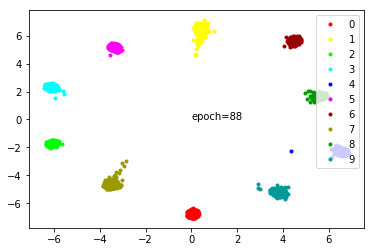

--- epoch 90 ---
--- loss: 0.02226801123159627 % acc: 100.0 %


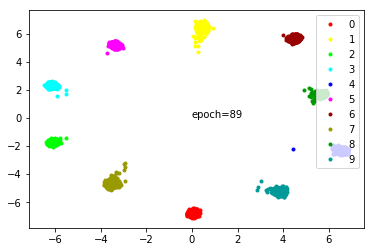

--- epoch 91 ---
--- loss: 0.021822352713594832 % acc: 100.0 %


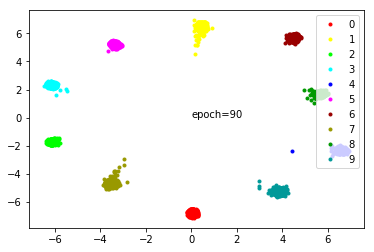

--- epoch 92 ---
--- loss: 0.02147907118933896 % acc: 100.0 %


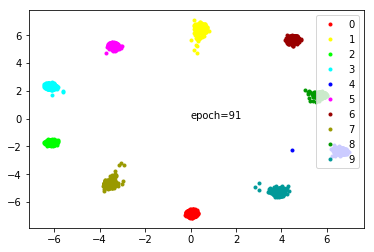

--- epoch 93 ---
--- loss: 0.0209344070777297 % acc: 100.0 %


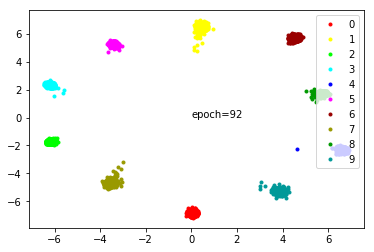

--- epoch 94 ---
--- loss: 0.021214671485746902 % acc: 100.0 %


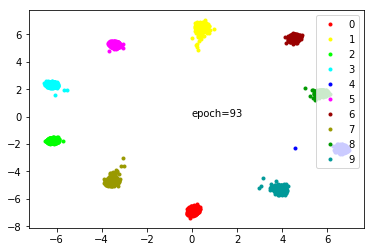

--- epoch 95 ---
--- loss: 0.020581611531476182 % acc: 100.0 %


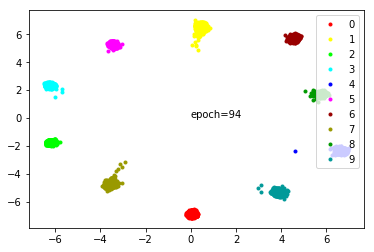

--- epoch 96 ---
--- loss: 0.020187210164343317 % acc: 100.0 %


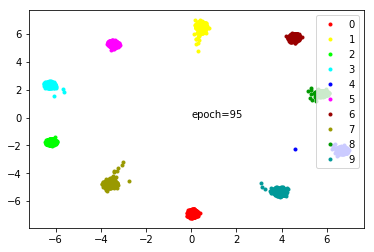

--- epoch 97 ---
--- loss: 0.019856163856262963 % acc: 100.0 %


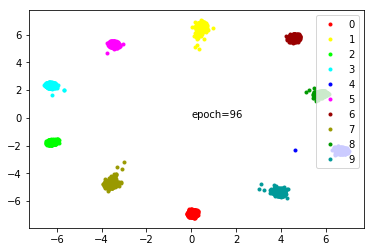

--- epoch 98 ---
--- loss: 0.019792190374185642 % acc: 100.0 %


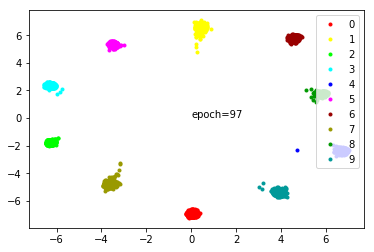

--- epoch 99 ---
--- loss: 0.019452422624453902 % acc: 100.0 %


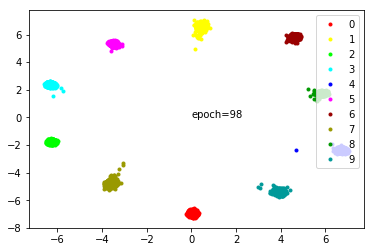

--- epoch 100 ---
--- loss: 0.018889023944114645 % acc: 100.0 %


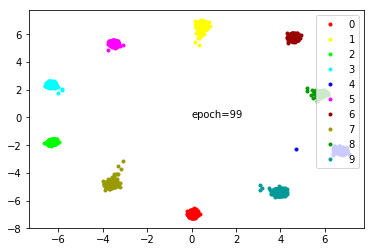

In [10]:
run_model(1, CenterLoss(10, 2).to(device), 'paper_1')

--- epoch 1 ---
--- loss: 1.7941707841555279 % acc: 10.854999999999999 %


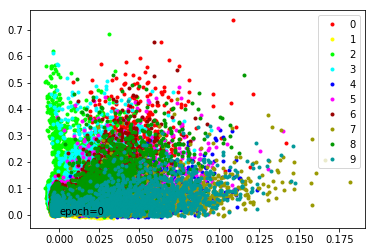

--- epoch 2 ---
--- loss: 1.321783436735471 % acc: 33.28 %


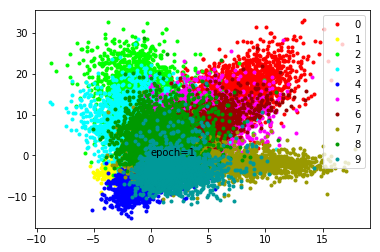

--- epoch 3 ---
--- loss: 0.6362931915620962 % acc: 72.515 %


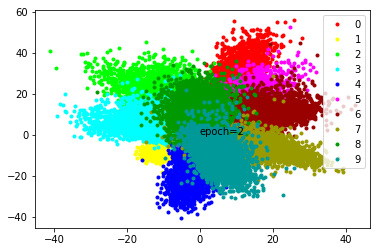

--- epoch 4 ---
--- loss: 0.3712452800571918 % acc: 86.84833333333334 %


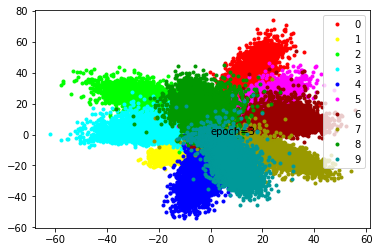

--- epoch 5 ---
--- loss: 0.26463100001215933 % acc: 91.25 %


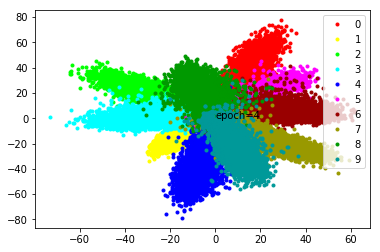

--- epoch 6 ---
--- loss: 0.20190836891531944 % acc: 93.50833333333334 %


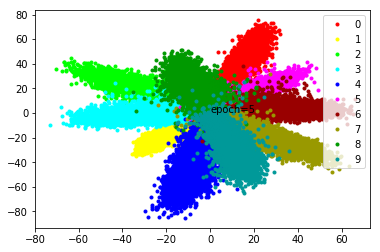

--- epoch 7 ---
--- loss: 0.16623005827267964 % acc: 94.71666666666667 %


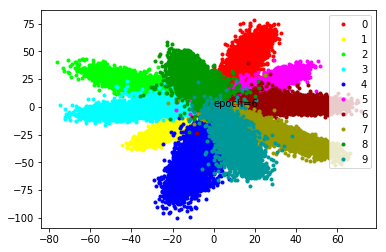

--- epoch 8 ---
--- loss: 0.13530049418409668 % acc: 95.59166666666667 %


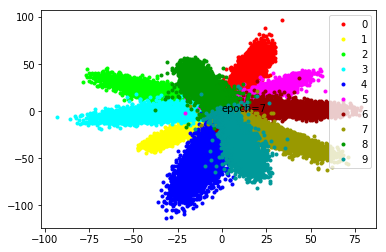

--- epoch 9 ---
--- loss: 0.12155681998779376 % acc: 96.02000000000001 %


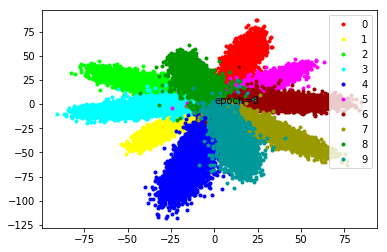

--- epoch 10 ---
--- loss: 0.10257368305698036 % acc: 96.64 %


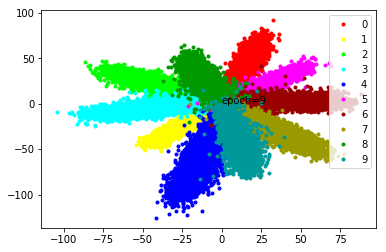

--- epoch 11 ---
--- loss: 0.09243513660505415 % acc: 96.74000000000001 %


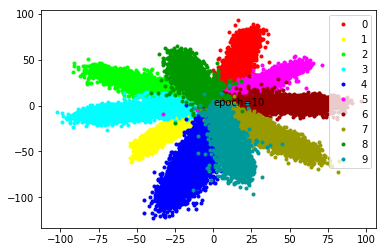

--- epoch 12 ---
--- loss: 0.07915473385403553 % acc: 97.32333333333332 %


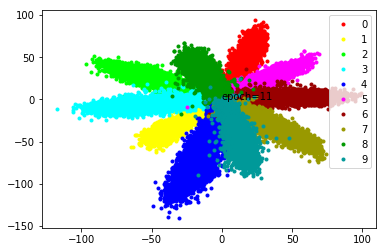

--- epoch 13 ---
--- loss: 0.06999584833780924 % acc: 97.56 %


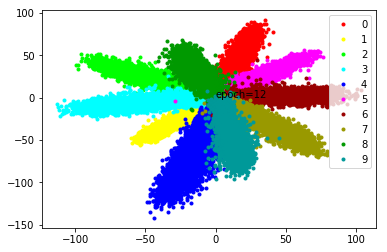

--- epoch 14 ---
--- loss: 0.05942943868227303 % acc: 97.85166666666667 %


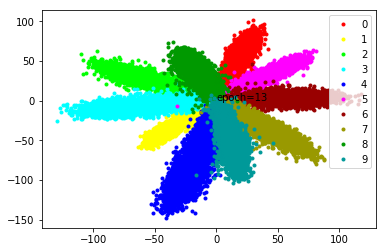

--- epoch 15 ---
--- loss: 0.053005484050760665 % acc: 98.04833333333333 %


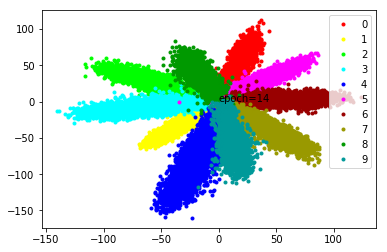

--- epoch 16 ---
--- loss: 0.04801794658415019 % acc: 98.205 %


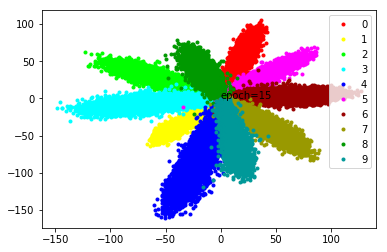

--- epoch 17 ---
--- loss: 0.04153275672035913 % acc: 98.46666666666667 %


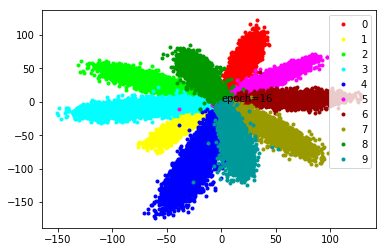

--- epoch 18 ---
--- loss: 0.037303776188443105 % acc: 98.52166666666666 %


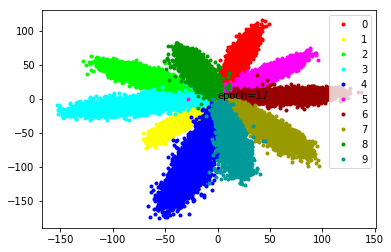

--- epoch 19 ---
--- loss: 0.03363663130439818 % acc: 98.68666666666667 %


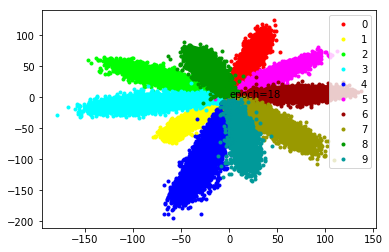

--- epoch 20 ---
--- loss: 0.028138087873036666 % acc: 98.92999999999999 %


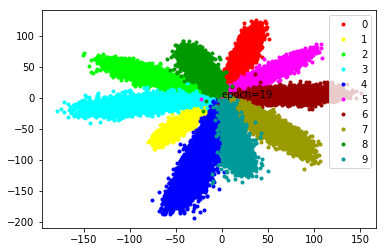

--- epoch 21 ---
--- loss: 0.019100643334289392 % acc: 99.33166666666666 %


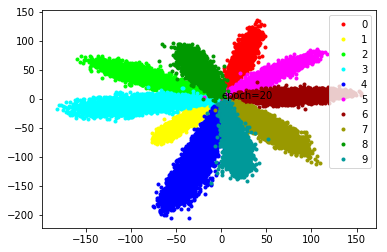

--- epoch 22 ---
--- loss: 0.014048957287644345 % acc: 99.54499999999999 %


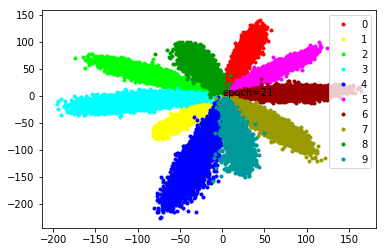

--- epoch 23 ---
--- loss: 0.013286487820247809 % acc: 99.52833333333334 %


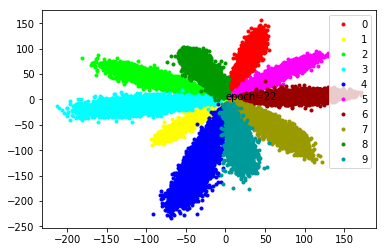

--- epoch 24 ---
--- loss: 0.013434488769077386 % acc: 99.47166666666666 %


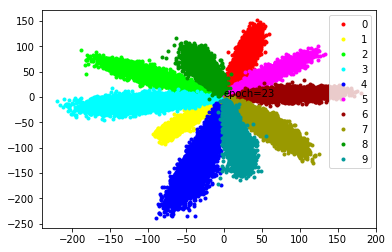

--- epoch 25 ---
--- loss: 0.009467418612912297 % acc: 99.67 %


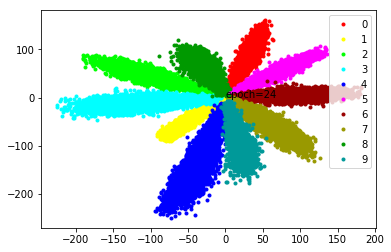

--- epoch 26 ---
--- loss: 0.014985382482409477 % acc: 99.41499999999999 %


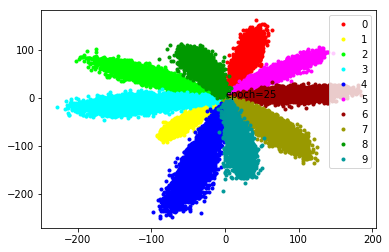

--- epoch 27 ---
--- loss: 0.011882192770717665 % acc: 99.51666666666667 %


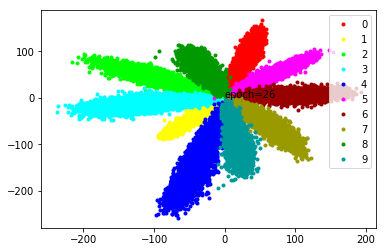

--- epoch 28 ---
--- loss: 0.010277338612650054 % acc: 99.60666666666667 %


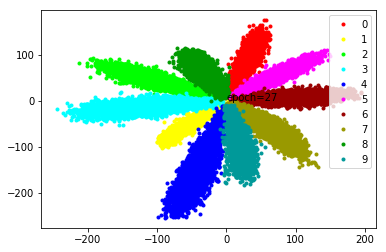

--- epoch 29 ---
--- loss: 0.006069107699440792 % acc: 99.79166666666667 %


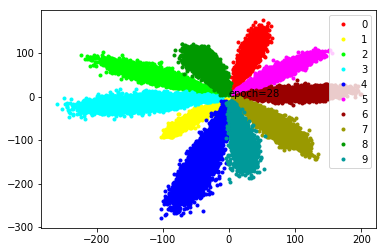

--- epoch 30 ---
--- loss: 0.004519992079585791 % acc: 99.86666666666667 %


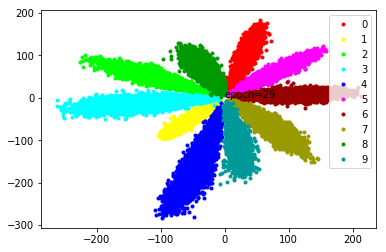

--- epoch 31 ---
--- loss: 0.004508823686240552 % acc: 99.86 %


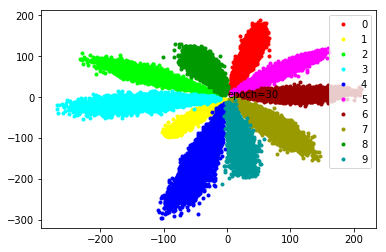

--- epoch 32 ---
--- loss: 0.004127940053391892 % acc: 99.87666666666667 %


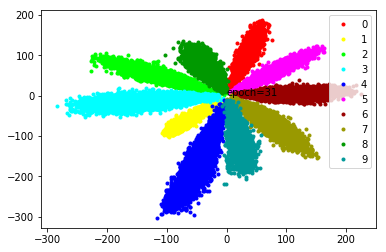

--- epoch 33 ---
--- loss: 0.005451506581157446 % acc: 99.8 %


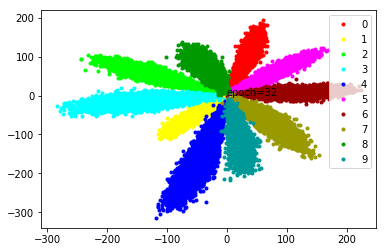

--- epoch 34 ---
--- loss: 0.00530226538151813 % acc: 99.80833333333334 %


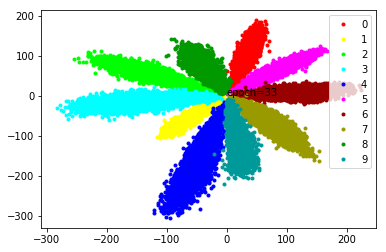

--- epoch 35 ---
--- loss: 0.004868431501090526 % acc: 99.83 %


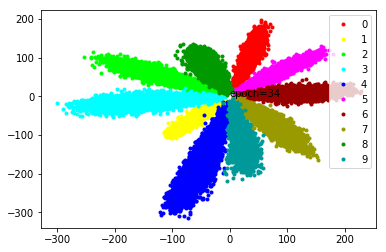

--- epoch 36 ---
--- loss: 0.004359162580221891 % acc: 99.85166666666667 %


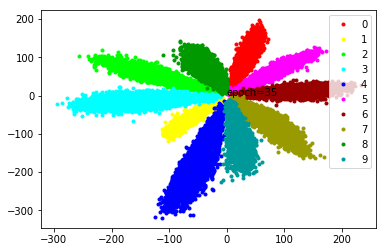

--- epoch 37 ---
--- loss: 0.006833184741359824 % acc: 99.73166666666667 %


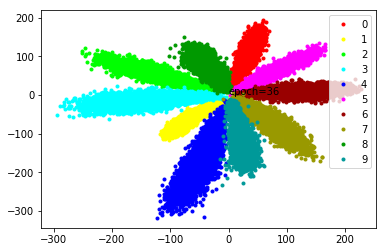

--- epoch 38 ---
--- loss: 0.014162343371038635 % acc: 99.41 %


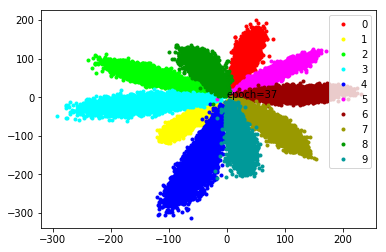

--- epoch 39 ---
--- loss: 0.010955207878723741 % acc: 99.56333333333333 %


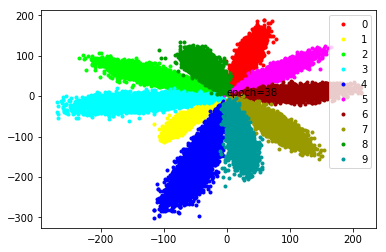

--- epoch 40 ---
--- loss: 0.01290222119957131 % acc: 99.46833333333333 %


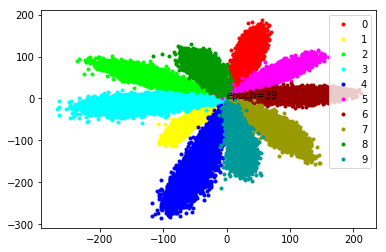

--- epoch 41 ---
--- loss: 0.00493040379951708 % acc: 99.82 %


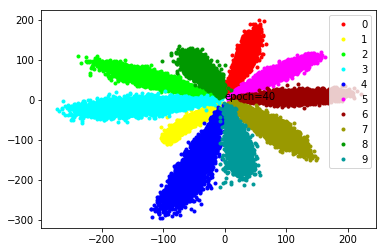

--- epoch 42 ---
--- loss: 0.0019895324090127057 % acc: 99.96166666666667 %


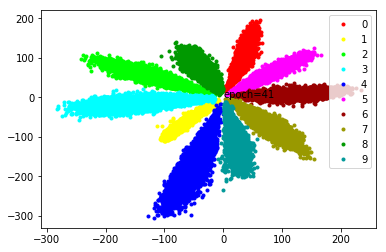

--- epoch 43 ---
--- loss: 0.0010534413614853597 % acc: 99.99333333333334 %


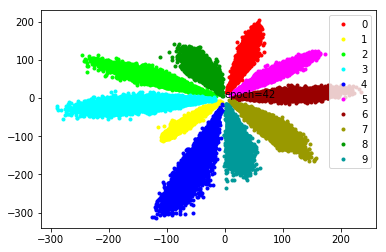

--- epoch 44 ---
--- loss: 0.0007235603014123626 % acc: 100.0 %


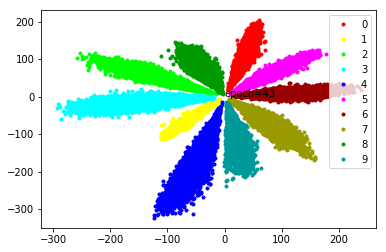

--- epoch 45 ---
--- loss: 0.0006223403289914132 % acc: 100.0 %


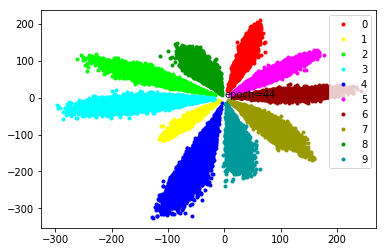

--- epoch 46 ---
--- loss: 0.0005675028637051582 % acc: 100.0 %


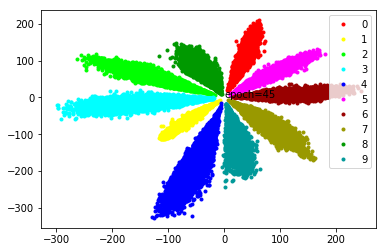

--- epoch 47 ---
--- loss: 0.000535191790064952 % acc: 100.0 %


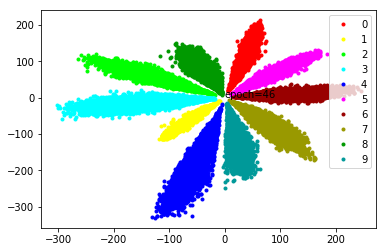

--- epoch 48 ---
--- loss: 0.0005059694457061899 % acc: 100.0 %


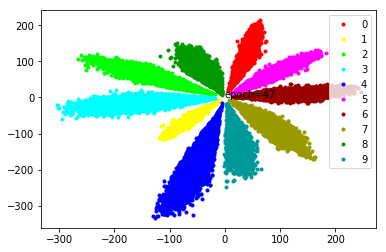

--- epoch 49 ---
--- loss: 0.00048745395421671367 % acc: 100.0 %


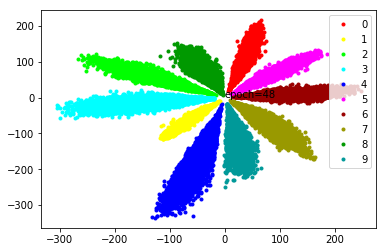

--- epoch 50 ---
--- loss: 0.00046998388648110753 % acc: 100.0 %


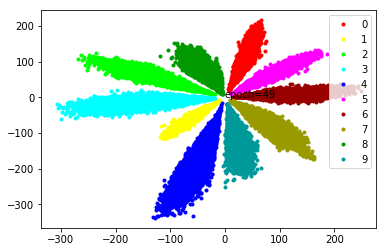

--- epoch 51 ---
--- loss: 0.00045441252902188957 % acc: 100.0 %


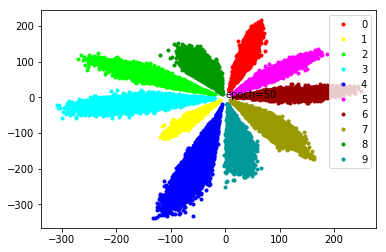

--- epoch 52 ---
--- loss: 0.00044454133341787383 % acc: 100.0 %


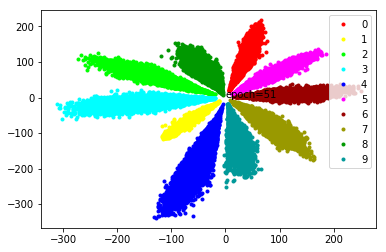

--- epoch 53 ---
--- loss: 0.0004363278257854593 % acc: 100.0 %


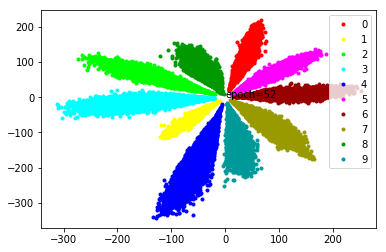

--- epoch 54 ---
--- loss: 0.00042872421036008743 % acc: 100.0 %


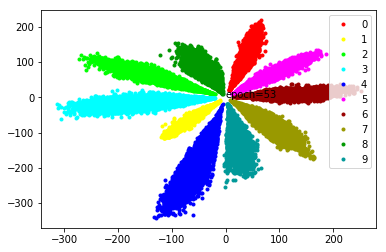

--- epoch 55 ---
--- loss: 0.00042167070011297857 % acc: 100.0 %


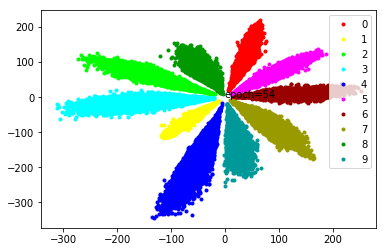

--- epoch 56 ---
--- loss: 0.0004138114013767336 % acc: 100.0 %


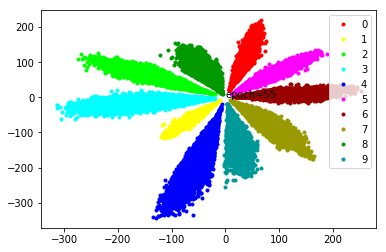

--- epoch 57 ---
--- loss: 0.0004081654424468676 % acc: 100.0 %


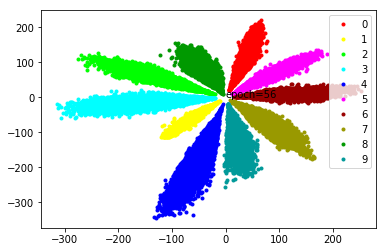

--- epoch 58 ---
--- loss: 0.000404821253468981 % acc: 100.0 %


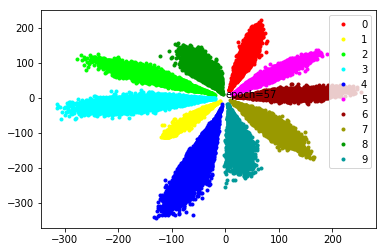

--- epoch 59 ---
--- loss: 0.00039836628158809614 % acc: 100.0 %


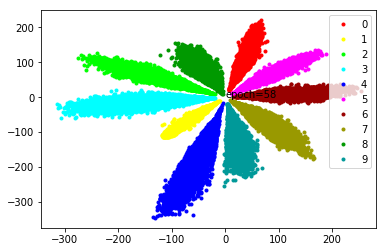

--- epoch 60 ---
--- loss: 0.00039874789203167896 % acc: 100.0 %


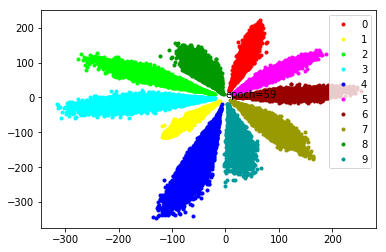

--- epoch 61 ---
--- loss: 0.00039210665146432197 % acc: 100.0 %


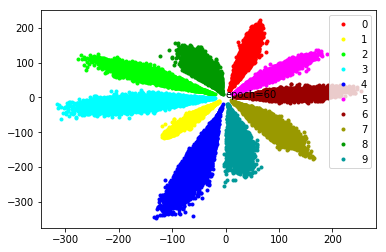

--- epoch 62 ---
--- loss: 0.00038910132730961776 % acc: 100.0 %


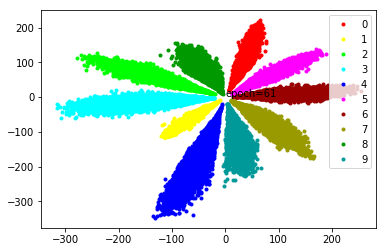

--- epoch 63 ---
--- loss: 0.0003878930045175366 % acc: 100.0 %


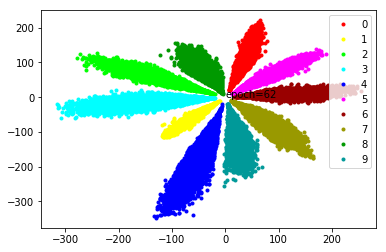

--- epoch 64 ---
--- loss: 0.0003850345437725385 % acc: 100.0 %


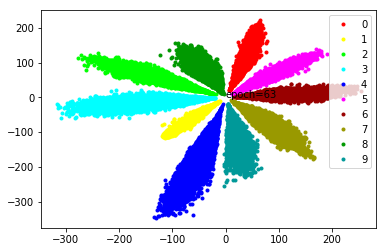

--- epoch 65 ---
--- loss: 0.0003841770233217782 % acc: 100.0 %


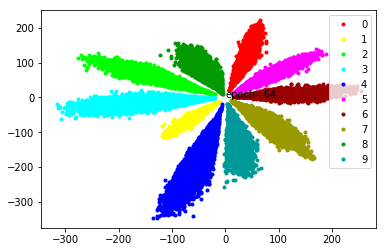

--- epoch 66 ---
--- loss: 0.00038433675964673363 % acc: 100.0 %


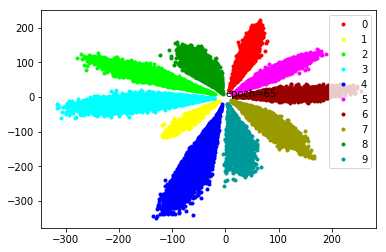

--- epoch 67 ---
--- loss: 0.0003816210520017194 % acc: 100.0 %


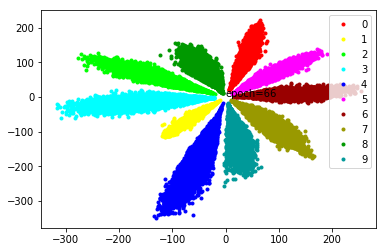

--- epoch 68 ---
--- loss: 0.0003806564584374428 % acc: 100.0 %


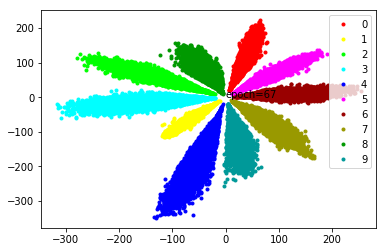

--- epoch 69 ---
--- loss: 0.00038187366391260487 % acc: 100.0 %


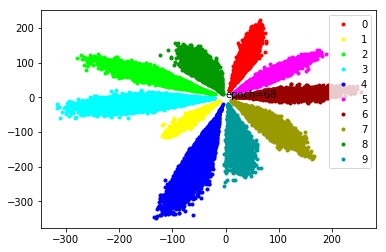

--- epoch 70 ---
--- loss: 0.0003812299751249763 % acc: 100.0 %


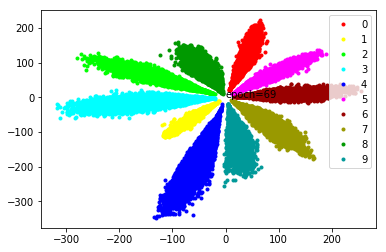

--- epoch 71 ---
--- loss: 0.000379807009473249 % acc: 100.0 %


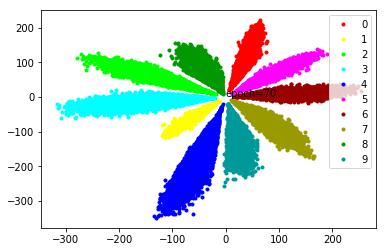

--- epoch 72 ---
--- loss: 0.0003803858326379365 % acc: 100.0 %


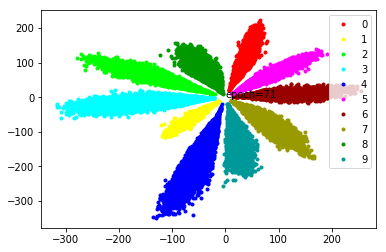

--- epoch 73 ---
--- loss: 0.0003786702123034047 % acc: 100.0 %


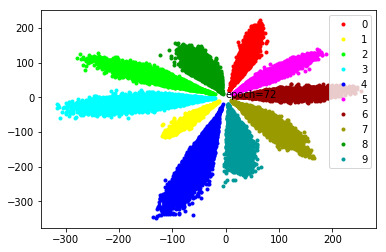

--- epoch 74 ---
--- loss: 0.000379496489961942 % acc: 100.0 %


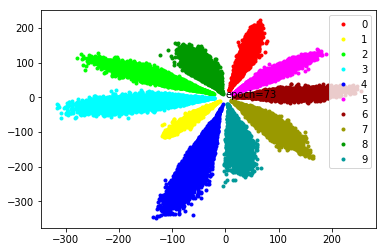

--- epoch 75 ---
--- loss: 0.00038005451361338295 % acc: 100.0 %


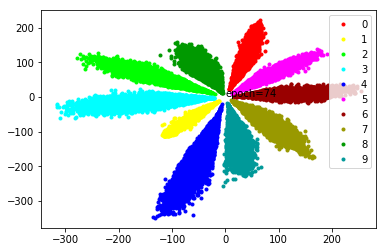

--- epoch 76 ---
--- loss: 0.0003785956071321077 % acc: 100.0 %


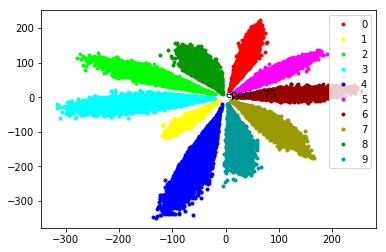

--- epoch 77 ---
--- loss: 0.0003796426248542654 % acc: 100.0 %


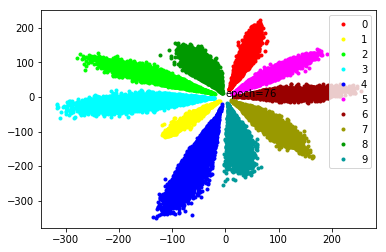

--- epoch 78 ---
--- loss: 0.0003791892610994789 % acc: 100.0 %


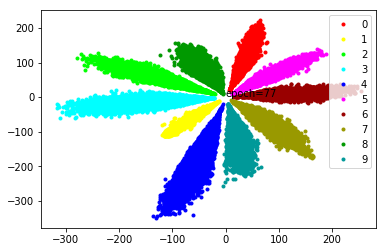

--- epoch 79 ---
--- loss: 0.0003801555186510086 % acc: 100.0 %


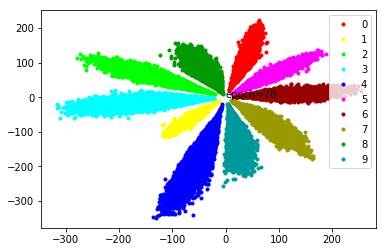

--- epoch 80 ---
--- loss: 0.0003802151191727414 % acc: 100.0 %


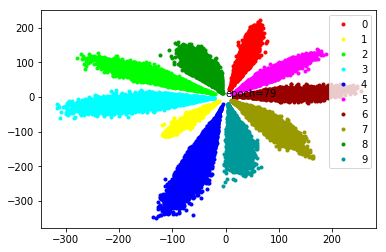

--- epoch 81 ---
--- loss: 0.00037816274076855433 % acc: 100.0 %


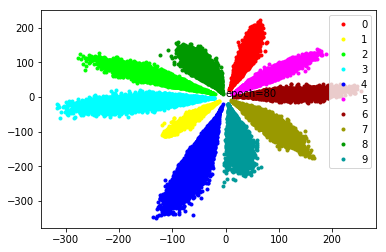

--- epoch 82 ---
--- loss: 0.00037799943655651686 % acc: 100.0 %


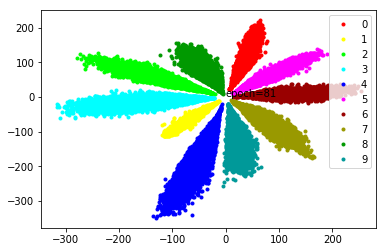

--- epoch 83 ---
--- loss: 0.000377427451312542 % acc: 100.0 %


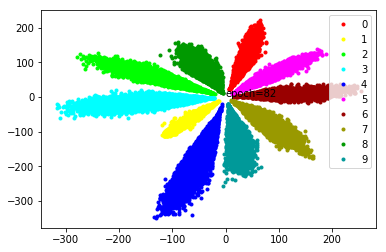

--- epoch 84 ---
--- loss: 0.00037789026896158854 % acc: 100.0 %


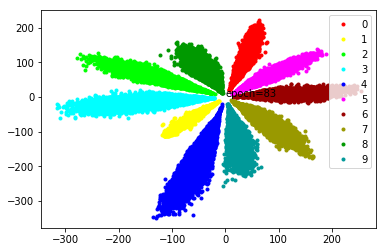

--- epoch 85 ---
--- loss: 0.00037864202012618387 % acc: 100.0 %


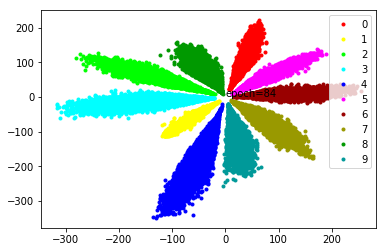

--- epoch 86 ---
--- loss: 0.0003795095367725783 % acc: 100.0 %


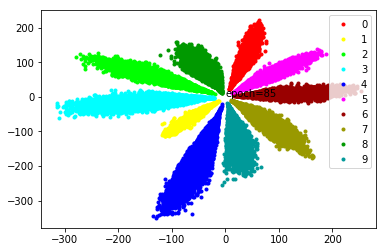

--- epoch 87 ---
--- loss: 0.0003801193833351135 % acc: 100.0 %


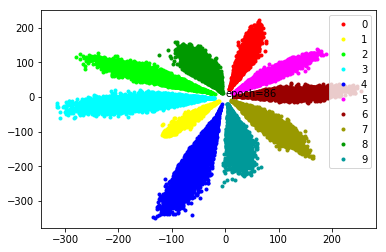

--- epoch 88 ---
--- loss: 0.00037926102264464136 % acc: 100.0 %


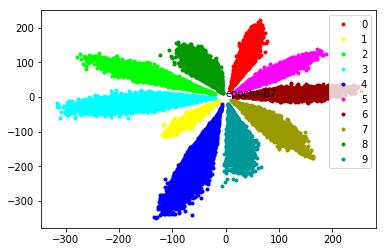

--- epoch 89 ---
--- loss: 0.00038009981731496127 % acc: 100.0 %


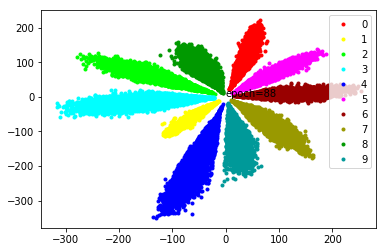

--- epoch 90 ---
--- loss: 0.00038112012463291953 % acc: 100.0 %


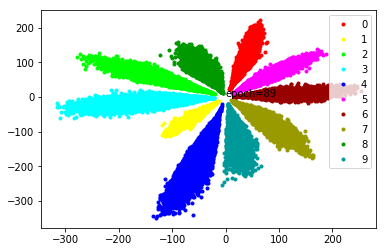

--- epoch 91 ---
--- loss: 0.00038113788183788226 % acc: 100.0 %


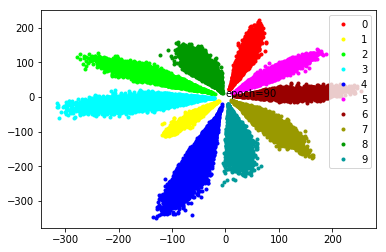

--- epoch 92 ---
--- loss: 0.0003818307196100553 % acc: 100.0 %


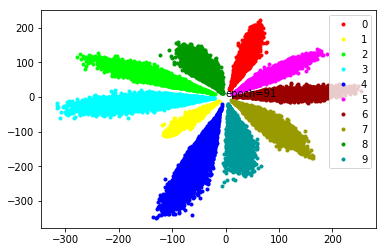

--- epoch 93 ---
--- loss: 0.00038146264851093294 % acc: 100.0 %


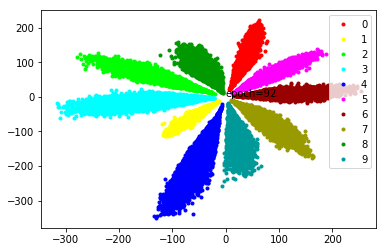

--- epoch 94 ---
--- loss: 0.0003824320601415821 % acc: 100.0 %


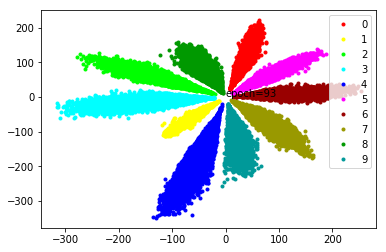

--- epoch 95 ---
--- loss: 0.00038334000448230653 % acc: 100.0 %


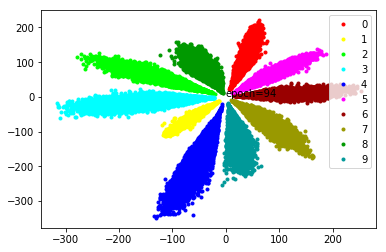

--- epoch 96 ---
--- loss: 0.0003827039856029538 % acc: 100.0 %


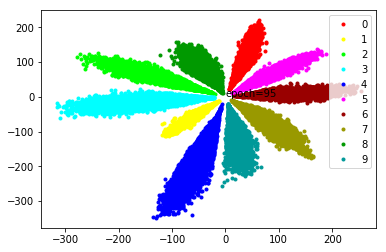

--- epoch 97 ---
--- loss: 0.00038410354405641554 % acc: 100.0 %


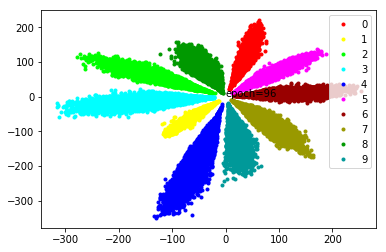

--- epoch 98 ---
--- loss: 0.0003841139541812785 % acc: 100.0 %


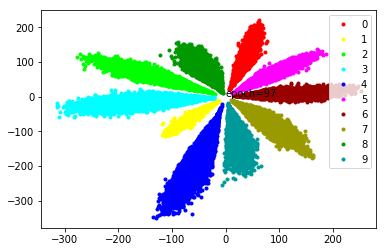

--- epoch 99 ---
--- loss: 0.00038559943020421387 % acc: 100.0 %


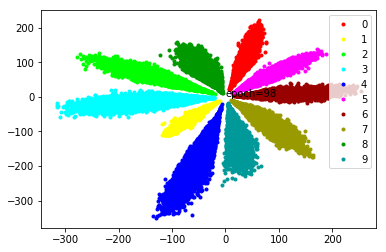

--- epoch 100 ---
--- loss: 0.00038585540314670655 % acc: 100.0 %


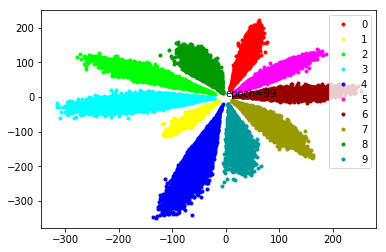

In [12]:
run_model(0, CenterLoss(10, 2).to(device), 'softmax')

## 2. Visualize test set

In [7]:
def run_model_with_test_data(model, loss_center_weight, center_loss, save_path=None):
    optimizer = torch.optim.SGD(model.parameters(),lr=0.001,momentum=0.9, weight_decay=0.0005)
    sheduler = torch.optim.lr_scheduler.StepLR(optimizer,20,gamma=0.8)
    optimzer_center = torch.optim.SGD(center_loss.parameters(), lr =0.5)
    for epoch in range(100):
        print('--- epoch',epoch+1,'---')
        sheduler.step()

        # train
        for i,(data, target) in enumerate(data_loader_train):
            data, target = data.to(device), target.to(device)
            output, vector_embedding = model(data)
            loss = F.cross_entropy(output, target) + loss_center_weight * center_loss(target, vector_embedding)

            optimizer.zero_grad()
            optimzer_center.zero_grad()
            loss.backward()
            optimizer.step()
            optimzer_center.step()

        
        # test
        vector_embedding_all = []
        targe_all = []
        total_loss = 0
        total_correct = 0
        for i,(data, target) in enumerate(data_loader_test):
            data, target = data.to(device), target.to(device)
            output, vector_embedding = model(data)
            loss = F.cross_entropy(output, target) + loss_center_weight * center_loss(target, vector_embedding)
            
            # predict
            pred = output.max(1)[1]  # get the index of the max log-probability
            
            # save data
            targe_all.append((target))
            vector_embedding_all.append(vector_embedding)
            total_correct += pred.eq(target).sum().item()
            total_loss += loss.item()
        print('--- loss:', total_loss/len(data_loader_test.dataset)*100,'%', 'acc:', total_correct/len(data_loader_test.dataset)*100,'%')
        if save_path:
            targe_all = torch.cat(targe_all, 0)
            vector_embedding_all = torch.cat(vector_embedding_all, 0)
            visualize(vector_embedding_all.data.cpu().numpy(),targe_all.data.cpu().numpy(),epoch, save_path)

--- epoch 1 ---
--- loss: 1.8195651936531068 % acc: 11.59 %


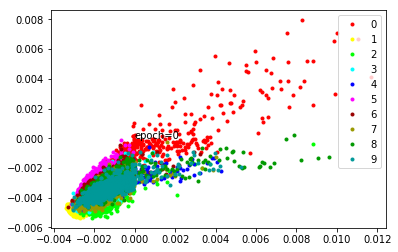

--- epoch 2 ---
--- loss: 1.7404974579811094 % acc: 34.48 %


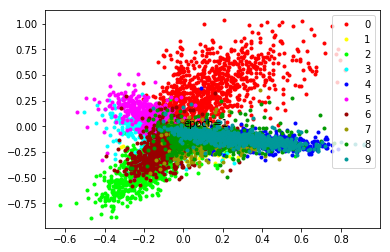

--- epoch 3 ---
--- loss: 1.676971848011017 % acc: 50.99 %


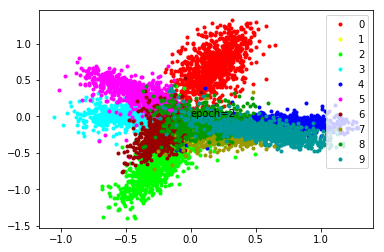

--- epoch 4 ---
--- loss: 1.574079613685608 % acc: 68.67999999999999 %


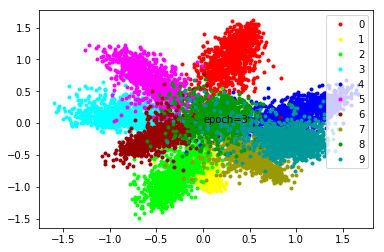

--- epoch 5 ---
--- loss: 1.4948526215553284 % acc: 81.77 %


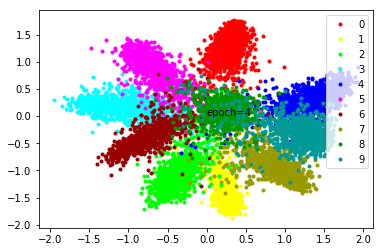

--- epoch 6 ---
--- loss: 1.458257476091385 % acc: 84.88 %


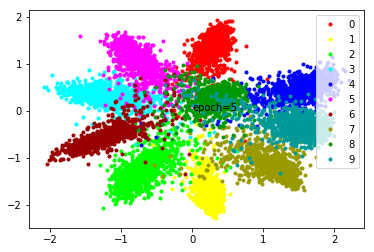

--- epoch 7 ---
--- loss: 1.4288994669914246 % acc: 85.6 %


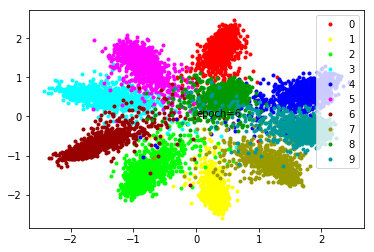

--- epoch 8 ---
--- loss: 1.4244591653347014 % acc: 91.59 %


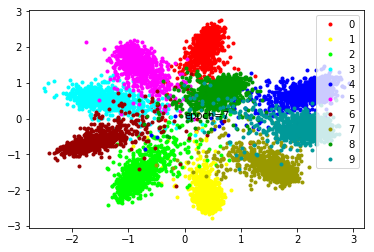

--- epoch 9 ---
--- loss: 1.412533301115036 % acc: 93.66 %


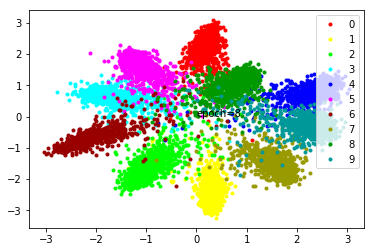

--- epoch 10 ---
--- loss: 1.4345020937919617 % acc: 94.67999999999999 %


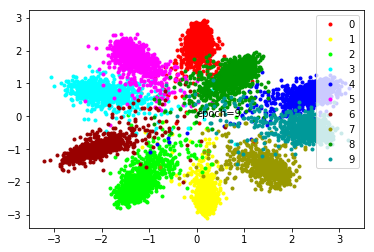

--- epoch 11 ---
--- loss: 1.4356603038311004 % acc: 94.99 %


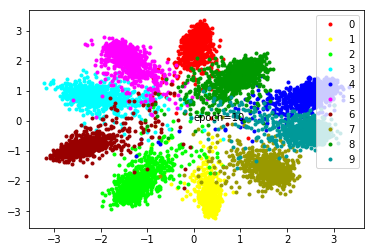

--- epoch 12 ---
--- loss: 1.3656465494632721 % acc: 95.03 %


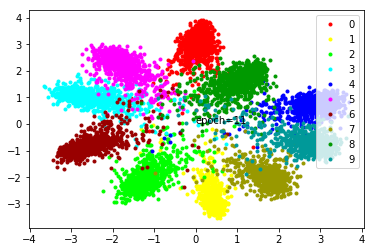

--- epoch 13 ---
--- loss: 1.3454945516586305 % acc: 95.04 %


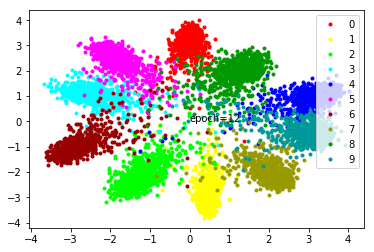

--- epoch 14 ---
--- loss: 1.2780171275138854 % acc: 94.62 %


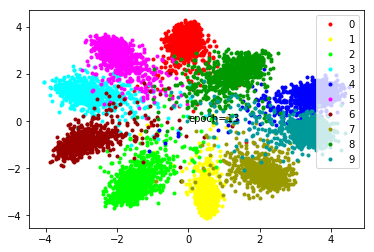

--- epoch 15 ---
--- loss: 1.2218201732635499 % acc: 94.86 %


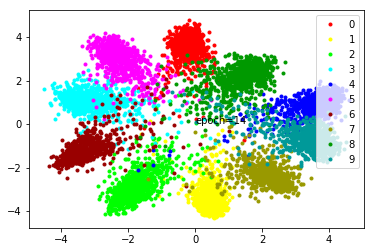

--- epoch 16 ---
--- loss: 1.1866326940059662 % acc: 94.81 %


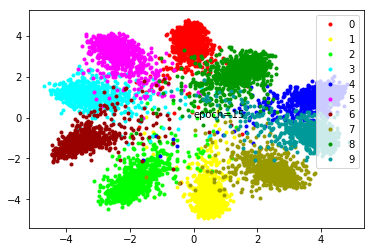

--- epoch 17 ---
--- loss: 1.1561748564243317 % acc: 94.37 %


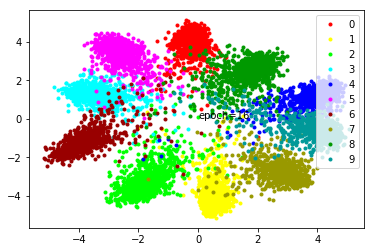

--- epoch 18 ---
--- loss: 1.0684525573253632 % acc: 93.99 %


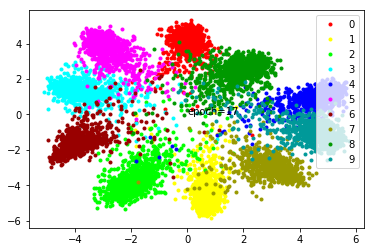

--- epoch 19 ---
--- loss: 1.0355945658683776 % acc: 93.31 %


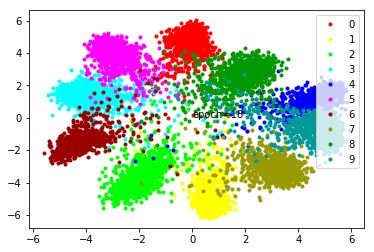

--- epoch 20 ---
--- loss: 0.9915199923515319 % acc: 93.7 %


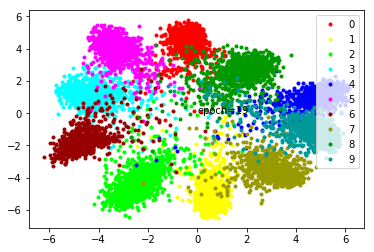

--- epoch 21 ---
--- loss: 0.9879691839218139 % acc: 93.35 %


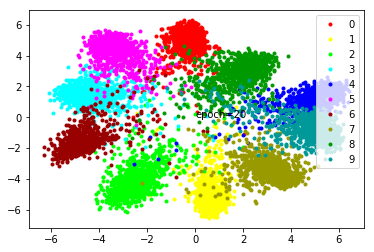

--- epoch 22 ---
--- loss: 0.9676511973142624 % acc: 93.03 %


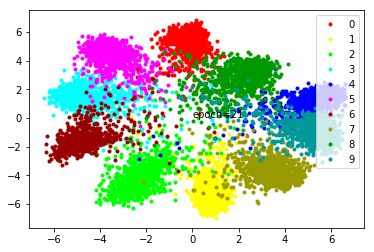

--- epoch 23 ---
--- loss: 0.9752138459682465 % acc: 93.2 %


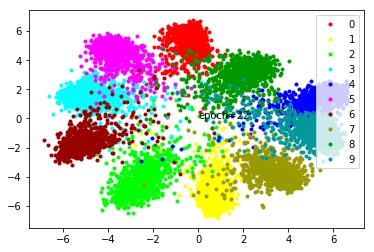

--- epoch 24 ---
--- loss: 0.9834766793251037 % acc: 93.2 %


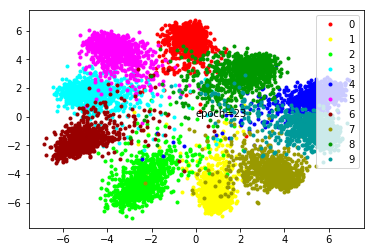

--- epoch 25 ---
--- loss: 0.9706690716743469 % acc: 92.31 %


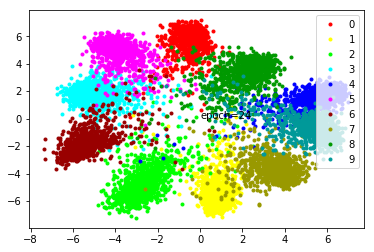

--- epoch 26 ---
--- loss: 0.947327731847763 % acc: 93.06 %


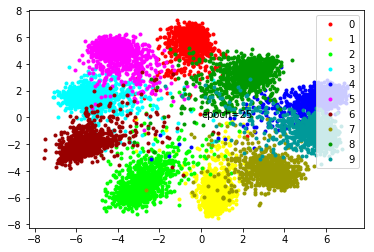

--- epoch 27 ---
--- loss: 0.9399823904037475 % acc: 92.69 %


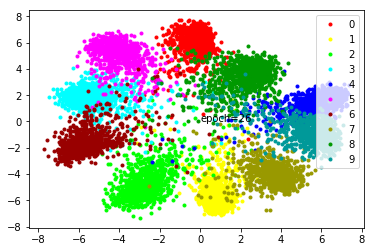

--- epoch 28 ---
--- loss: 0.9569381189346313 % acc: 93.0 %


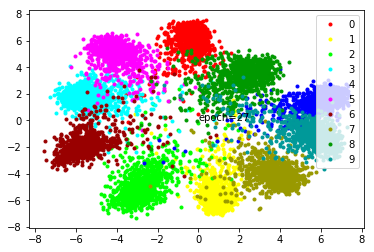

--- epoch 29 ---
--- loss: 0.9620937061309814 % acc: 92.47 %


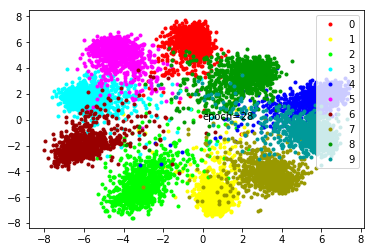

--- epoch 30 ---
--- loss: 0.9236865711212159 % acc: 92.96 %


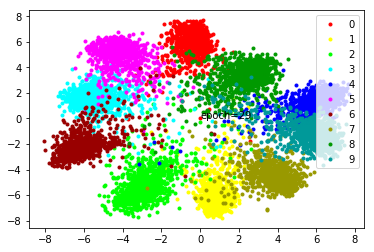

--- epoch 31 ---
--- loss: 0.9022341299057006 % acc: 92.7 %


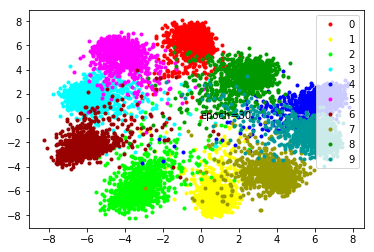

--- epoch 32 ---
--- loss: 0.9526411437988281 % acc: 92.32000000000001 %


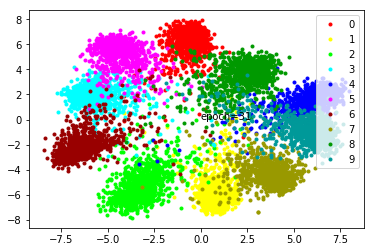

--- epoch 33 ---
--- loss: 0.934277566075325 % acc: 92.67999999999999 %


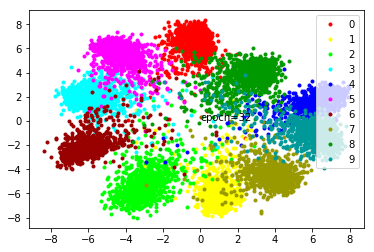

--- epoch 34 ---
--- loss: 0.9268780606985092 % acc: 92.43 %


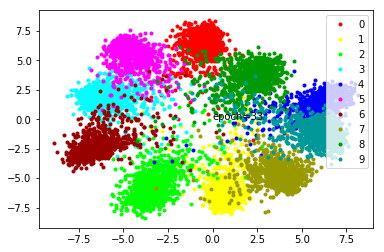

--- epoch 35 ---
--- loss: 0.9367739713191986 % acc: 91.95 %


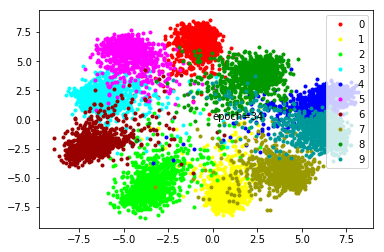

--- epoch 36 ---
--- loss: 0.9173283565044402 % acc: 92.06 %


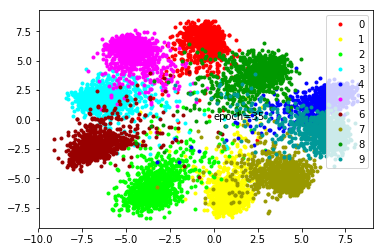

--- epoch 37 ---
--- loss: 0.9236773520708085 % acc: 92.27 %


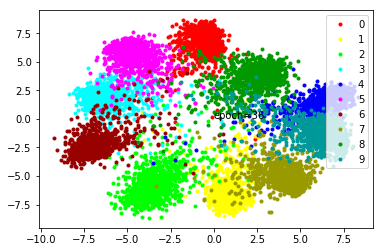

--- epoch 38 ---
--- loss: 0.9474558705091476 % acc: 92.27 %


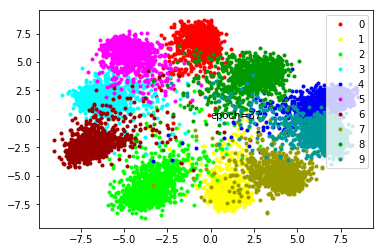

--- epoch 39 ---
--- loss: 0.9256203138828278 % acc: 91.84 %


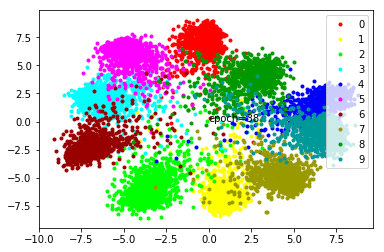

--- epoch 40 ---
--- loss: 0.9425960701704026 % acc: 92.08 %


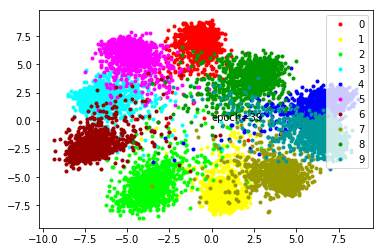

--- epoch 41 ---
--- loss: 0.9137726986408233 % acc: 92.43 %


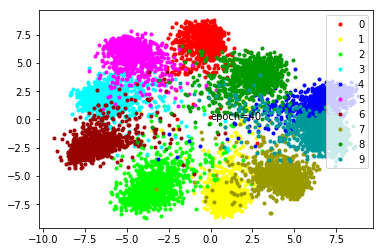

--- epoch 42 ---
--- loss: 0.9324987888336183 % acc: 92.31 %


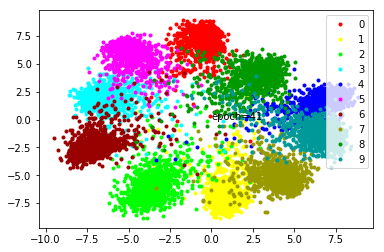

--- epoch 43 ---
--- loss: 0.9203268682956696 % acc: 92.41 %


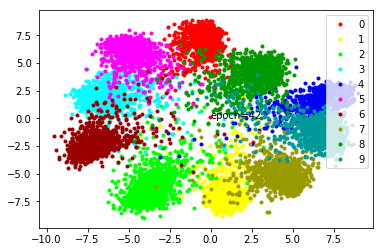

--- epoch 44 ---
--- loss: 0.9311226606369019 % acc: 92.31 %


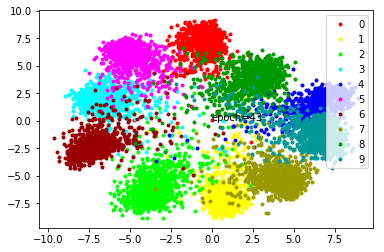

--- epoch 45 ---
--- loss: 0.9362819248437881 % acc: 92.08 %


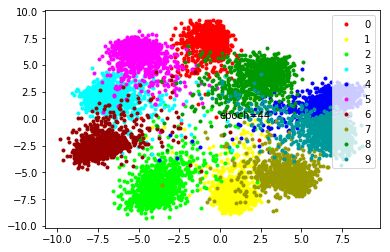

--- epoch 46 ---
--- loss: 0.933212925195694 % acc: 92.33 %


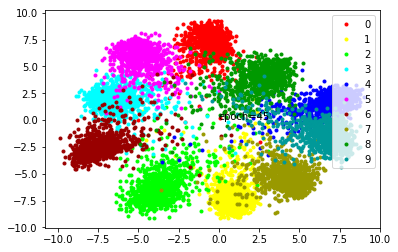

--- epoch 47 ---
--- loss: 0.9207465046644211 % acc: 92.24 %


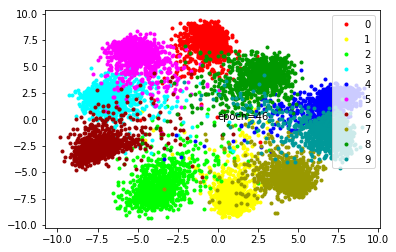

--- epoch 48 ---
--- loss: 0.9560322570800781 % acc: 92.29 %


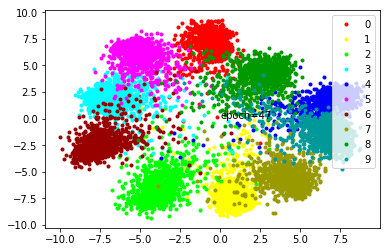

--- epoch 49 ---
--- loss: 0.9586242455244065 % acc: 92.28 %


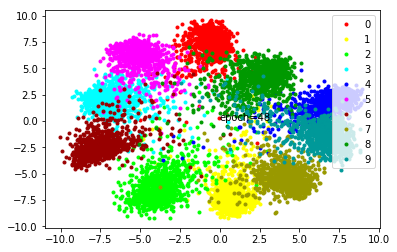

--- epoch 50 ---
--- loss: 0.9506395357847215 % acc: 92.31 %


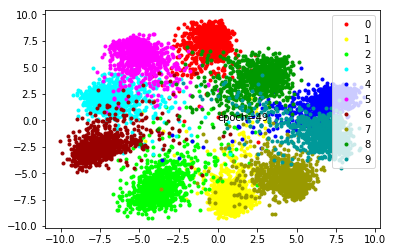

--- epoch 51 ---
--- loss: 0.9154492962360382 % acc: 92.33 %


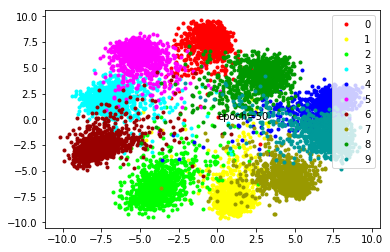

--- epoch 52 ---
--- loss: 0.9382536524534225 % acc: 92.25 %


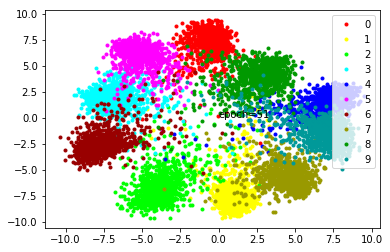

--- epoch 53 ---
--- loss: 0.9711221158504486 % acc: 91.56 %


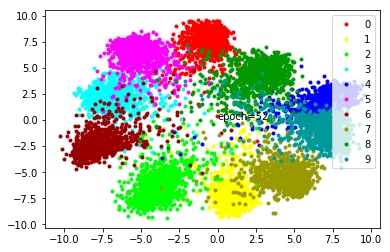

--- epoch 54 ---
--- loss: 0.9561566489934922 % acc: 91.8 %


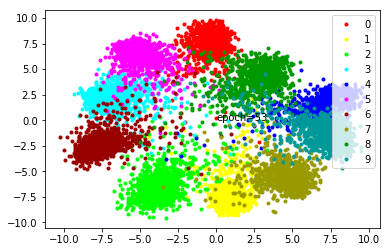

--- epoch 55 ---
--- loss: 0.9601642256975175 % acc: 92.04 %


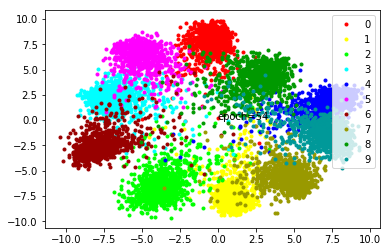

--- epoch 56 ---
--- loss: 0.968240419626236 % acc: 92.01 %


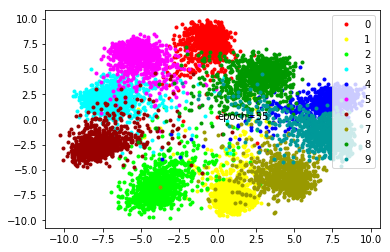

--- epoch 57 ---
--- loss: 0.9631768381595611 % acc: 92.01 %


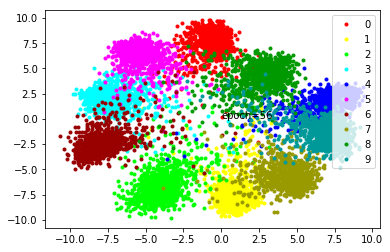

--- epoch 58 ---
--- loss: 0.9694711470603943 % acc: 91.78 %


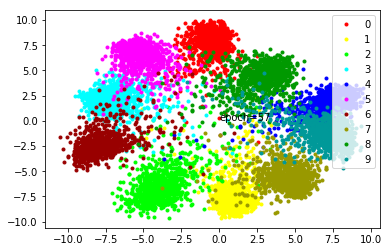

--- epoch 59 ---
--- loss: 0.971768263578415 % acc: 92.03 %


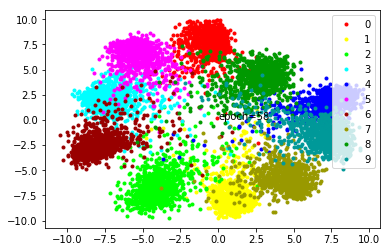

--- epoch 60 ---
--- loss: 0.9839572161436081 % acc: 91.66 %


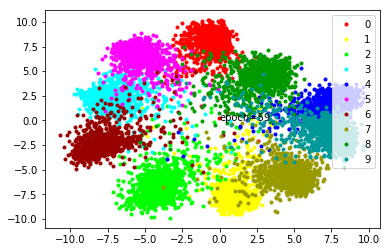

--- epoch 61 ---
--- loss: 0.9679302620887756 % acc: 91.93 %


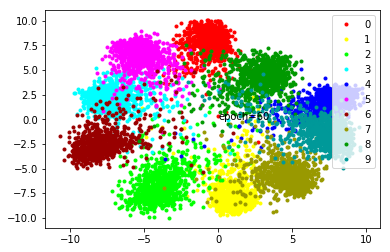

--- epoch 62 ---
--- loss: 0.9889099812507629 % acc: 91.97 %


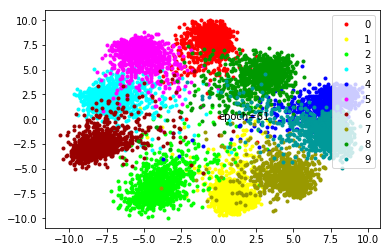

--- epoch 63 ---
--- loss: 0.98517975628376 % acc: 91.86999999999999 %


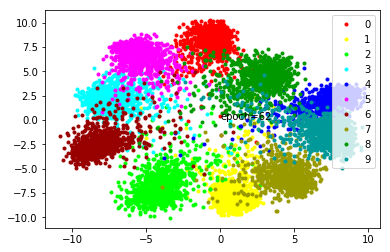

--- epoch 64 ---
--- loss: 0.9851650655269624 % acc: 91.95 %


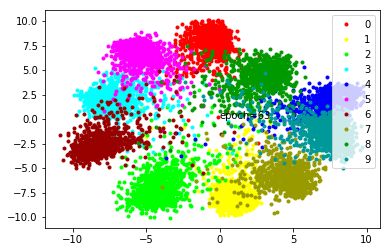

--- epoch 65 ---
--- loss: 0.9903536182641982 % acc: 91.97 %


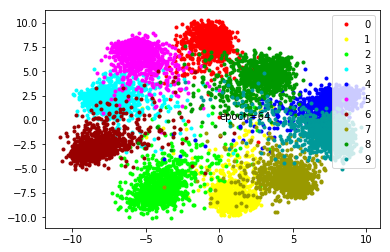

--- epoch 66 ---
--- loss: 0.993029516339302 % acc: 91.96 %


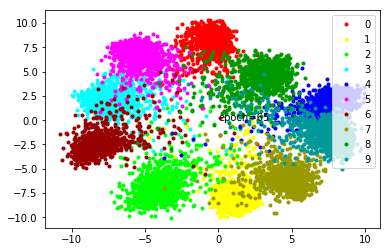

--- epoch 67 ---
--- loss: 1.0048552244901656 % acc: 91.75999999999999 %


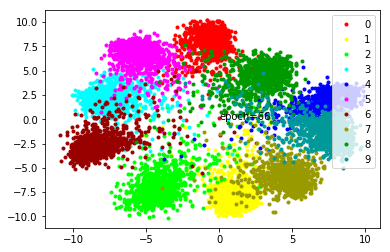

--- epoch 68 ---
--- loss: 1.0070269811153412 % acc: 91.74 %


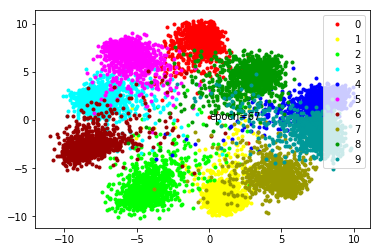

--- epoch 69 ---
--- loss: 1.0026410907506942 % acc: 91.95 %


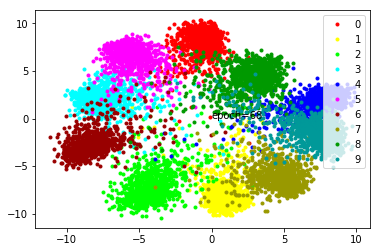

--- epoch 70 ---
--- loss: 1.0183281564712523 % acc: 91.86999999999999 %


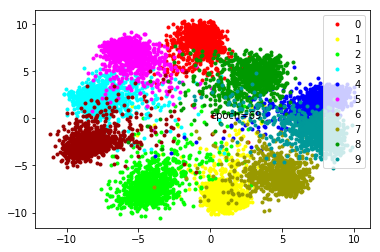

--- epoch 71 ---
--- loss: 1.006024187207222 % acc: 91.67 %


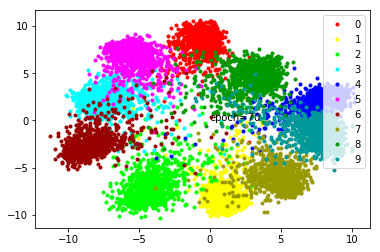

--- epoch 72 ---
--- loss: 1.0054345262050628 % acc: 91.82000000000001 %


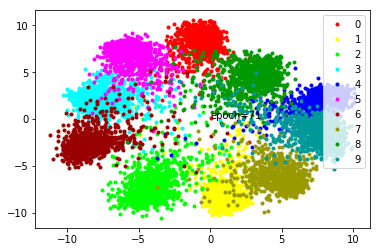

--- epoch 73 ---
--- loss: 1.0211608636379241 % acc: 91.86 %


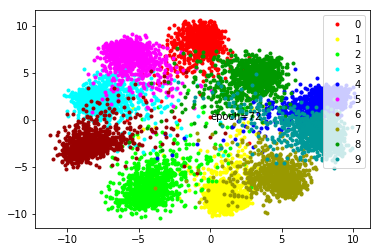

--- epoch 74 ---
--- loss: 1.0076654678583146 % acc: 91.96 %


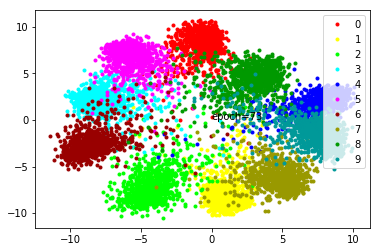

--- epoch 75 ---
--- loss: 1.0272164124250411 % acc: 91.85 %


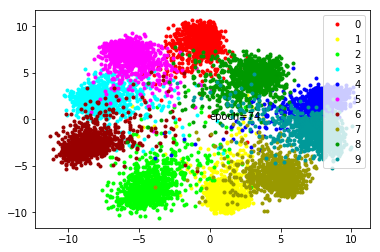

--- epoch 76 ---
--- loss: 1.0142382699251173 % acc: 91.8 %


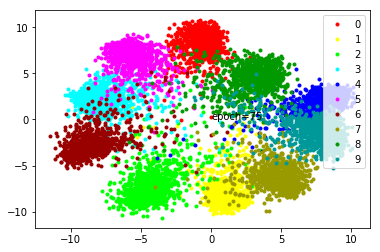

--- epoch 77 ---
--- loss: 1.0251032543182372 % acc: 91.79 %


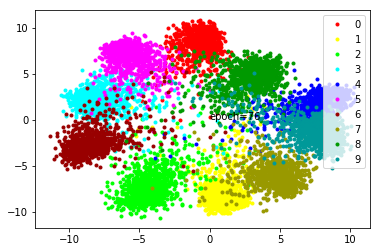

--- epoch 78 ---
--- loss: 1.031149079799652 % acc: 91.71000000000001 %


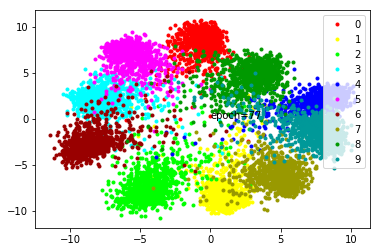

--- epoch 79 ---
--- loss: 1.03820258975029 % acc: 91.62 %


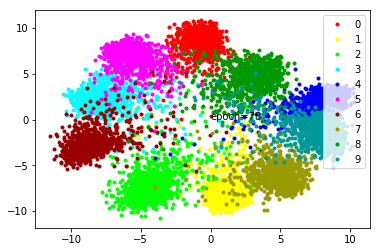

--- epoch 80 ---
--- loss: 1.0431852859258652 % acc: 91.60000000000001 %


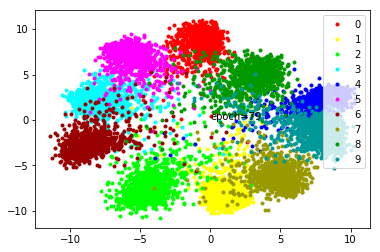

--- epoch 81 ---
--- loss: 1.0417230248451232 % acc: 91.71000000000001 %


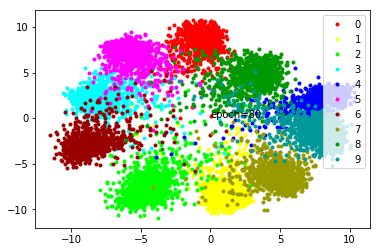

--- epoch 82 ---
--- loss: 1.048295031785965 % acc: 91.56 %


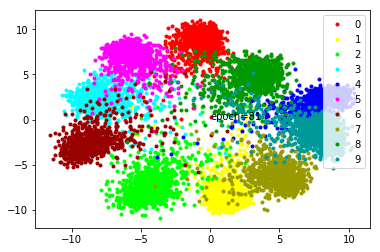

--- epoch 83 ---
--- loss: 1.0484136122465133 % acc: 91.62 %


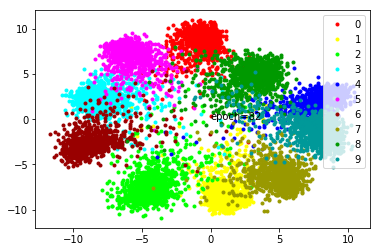

--- epoch 84 ---
--- loss: 1.0457384753227235 % acc: 91.5 %


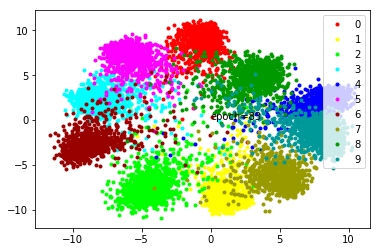

--- epoch 85 ---
--- loss: 1.0605964797735214 % acc: 91.75999999999999 %


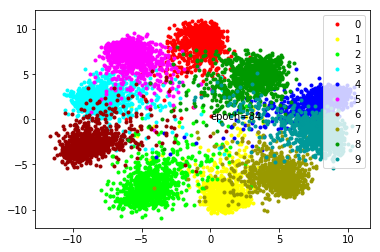

--- epoch 86 ---
--- loss: 1.0552215921878816 % acc: 91.77 %


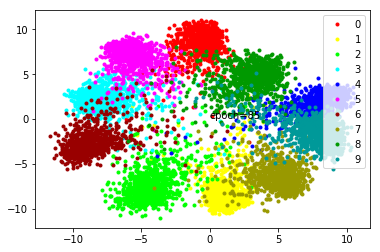

--- epoch 87 ---
--- loss: 1.0549684983491898 % acc: 91.63 %


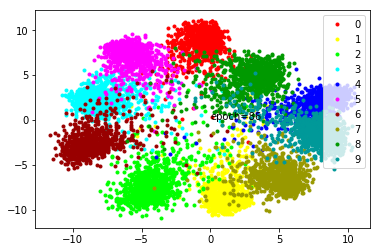

--- epoch 88 ---
--- loss: 1.0573488426208497 % acc: 91.72 %


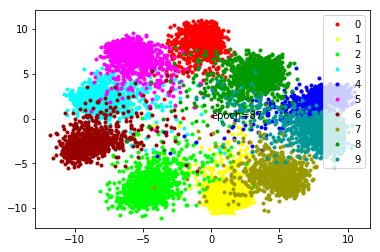

--- epoch 89 ---
--- loss: 1.061035172343254 % acc: 91.64999999999999 %


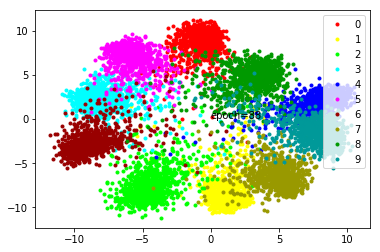

--- epoch 90 ---
--- loss: 1.0839153456687929 % acc: 91.53999999999999 %


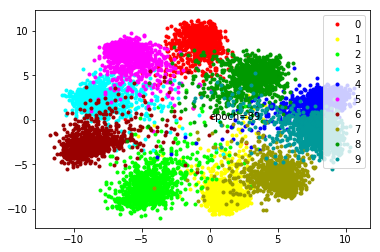

--- epoch 91 ---
--- loss: 1.0674563419818877 % acc: 91.8 %


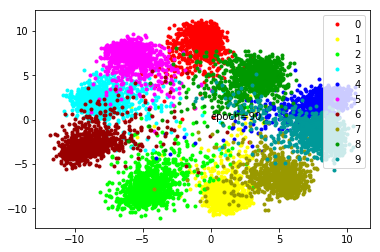

--- epoch 92 ---
--- loss: 1.0695982468128205 % acc: 91.55 %


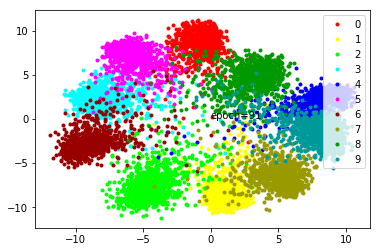

--- epoch 93 ---
--- loss: 1.0813709723949434 % acc: 91.64 %


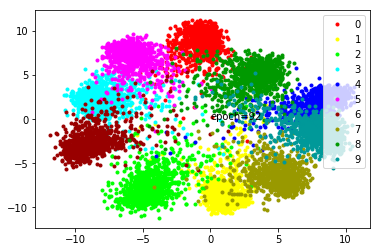

--- epoch 94 ---
--- loss: 1.0706256568431853 % acc: 91.75999999999999 %


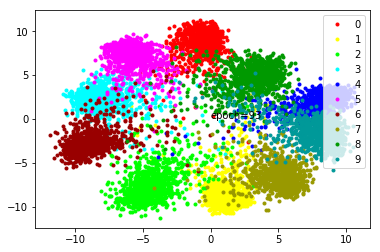

--- epoch 95 ---
--- loss: 1.0789743816852568 % acc: 91.7 %


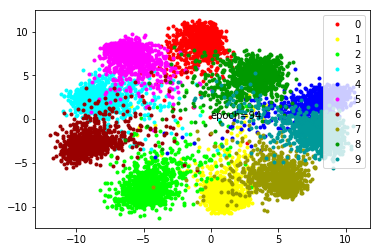

--- epoch 96 ---
--- loss: 1.0749156975746155 % acc: 91.83 %


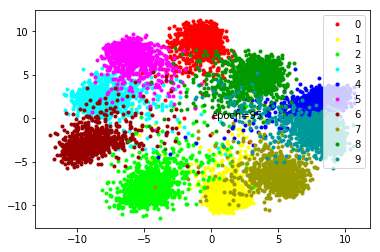

--- epoch 97 ---
--- loss: 1.0759878665208817 % acc: 91.63 %


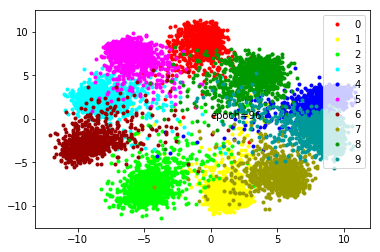

--- epoch 98 ---
--- loss: 1.0837599992752074 % acc: 91.51 %


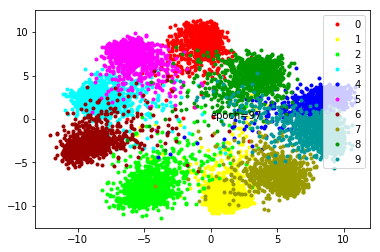

--- epoch 99 ---
--- loss: 1.1040915608406068 % acc: 91.47999999999999 %


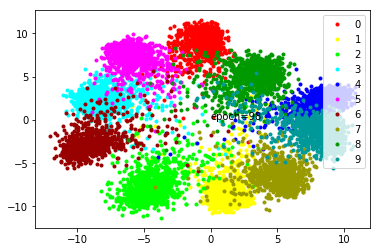

--- epoch 100 ---
--- loss: 1.101892602443695 % acc: 91.57 %


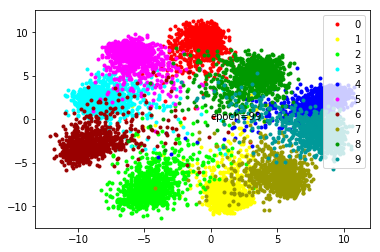

In [10]:
run_model_with_test_data(Net().to(device), 0.1, CenterLossAutograd(10, 2).to(device), 'test_auto_0.1')

--- epoch 1 ---
--- loss: 1.8189511418342592 % acc: 10.09 %


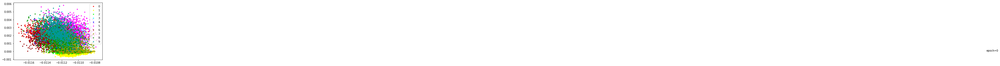

--- epoch 2 ---
--- loss: 1.8199528145790103 % acc: 9.92 %


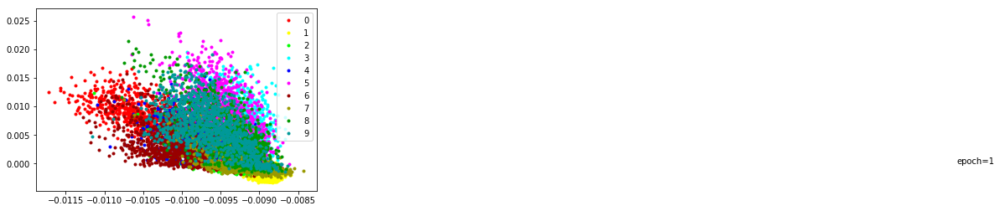

--- epoch 3 ---
--- loss: 1.8231622838973998 % acc: 16.23 %


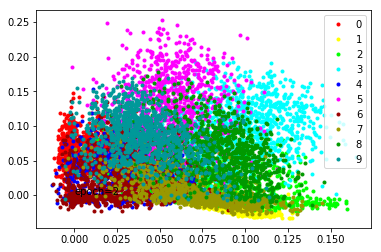

--- epoch 4 ---
--- loss: 2.0116601252555846 % acc: 46.45 %


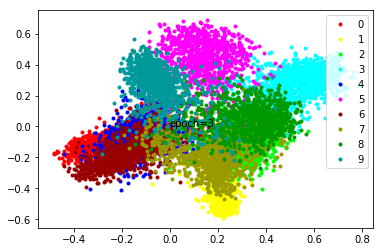

--- epoch 5 ---
--- loss: 2.158910632133484 % acc: 49.91 %


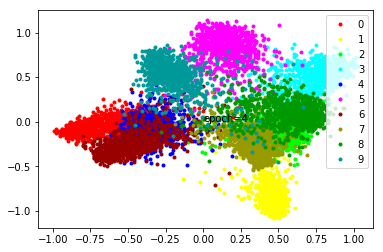

--- epoch 6 ---
--- loss: 2.1971758890151976 % acc: 65.59 %


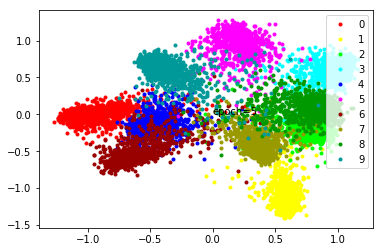

--- epoch 7 ---
--- loss: 2.237264132499695 % acc: 66.7 %


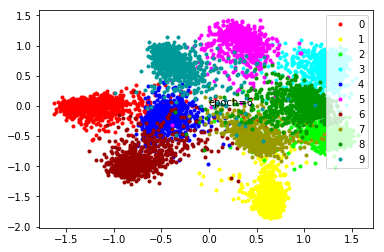

--- epoch 8 ---
--- loss: 2.1001402378082275 % acc: 68.22 %


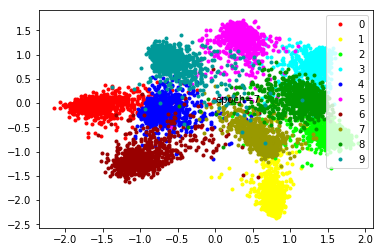

--- epoch 9 ---
--- loss: 1.969996576309204 % acc: 71.34 %


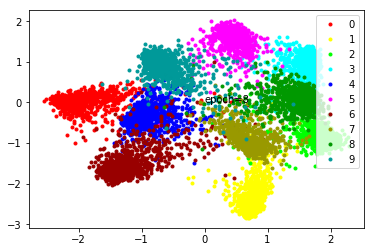

--- epoch 10 ---
--- loss: 1.8552833437919616 % acc: 79.24 %


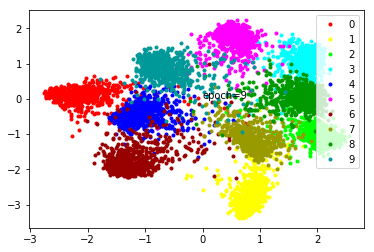

--- epoch 11 ---
--- loss: 1.8065818738937378 % acc: 90.51 %


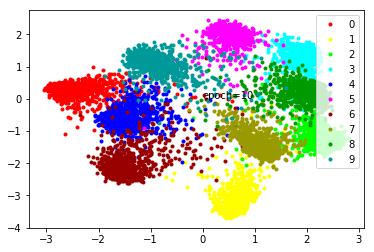

--- epoch 12 ---
--- loss: 1.725941220521927 % acc: 92.55 %


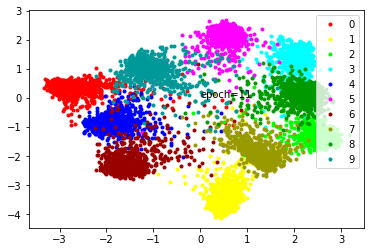

--- epoch 13 ---
--- loss: 1.7374669814109802 % acc: 93.94 %


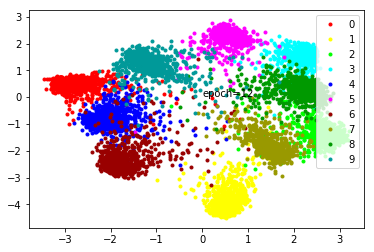

--- epoch 14 ---
--- loss: 1.9544647073745727 % acc: 92.88 %


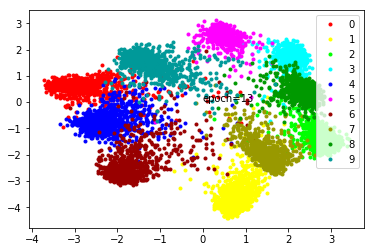

--- epoch 15 ---
--- loss: 1.5445769023895264 % acc: 93.85 %


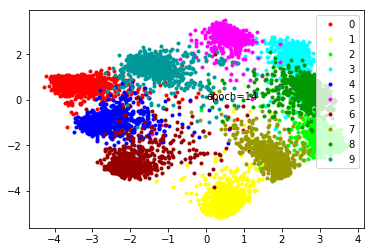

--- epoch 16 ---
--- loss: 1.488714348077774 % acc: 94.37 %


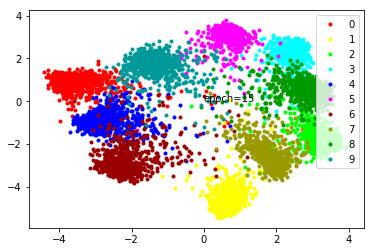

--- epoch 17 ---
--- loss: 1.5520373976230621 % acc: 94.71000000000001 %


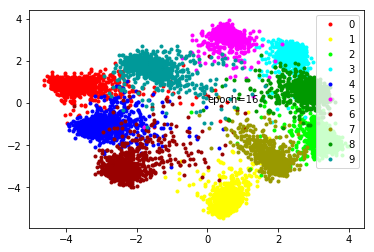

--- epoch 18 ---
--- loss: 1.5141293454170228 % acc: 95.13000000000001 %


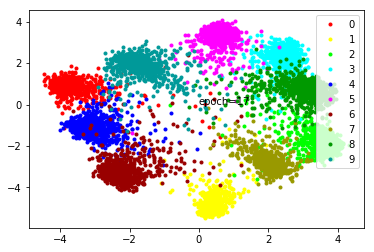

--- epoch 19 ---
--- loss: 1.385055273771286 % acc: 94.88 %


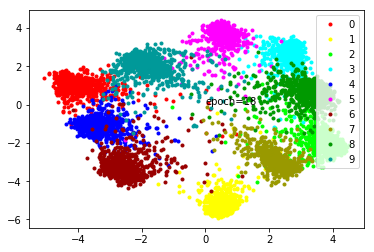

--- epoch 20 ---
--- loss: 1.4853053748607636 % acc: 94.83 %


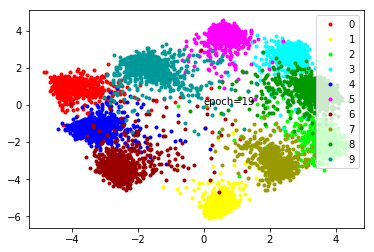

--- epoch 21 ---
--- loss: 1.4203897953033446 % acc: 95.0 %


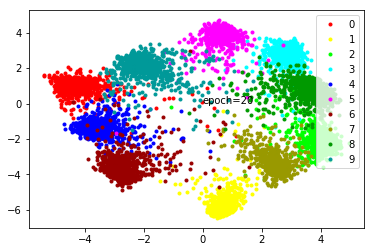

--- epoch 22 ---
--- loss: 1.4394129848480224 % acc: 95.25 %


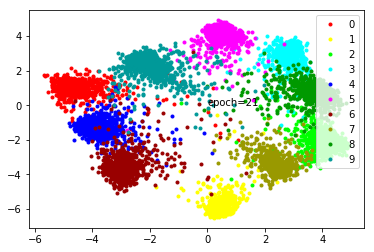

--- epoch 23 ---
--- loss: 1.4819223523139955 % acc: 94.83 %


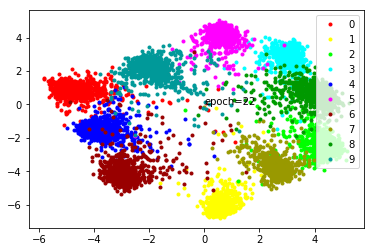

--- epoch 24 ---
--- loss: 1.4631024062633513 % acc: 94.88 %


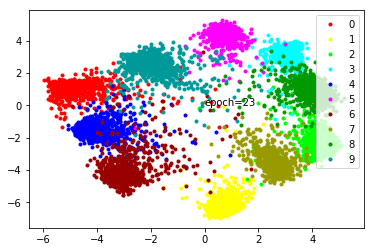

--- epoch 25 ---
--- loss: 1.380239613056183 % acc: 95.13000000000001 %


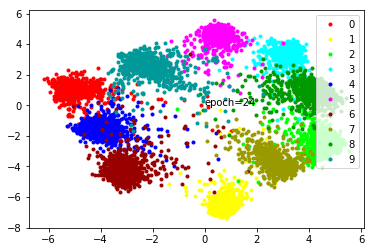

--- epoch 26 ---
--- loss: 1.5206558060646058 % acc: 94.39 %


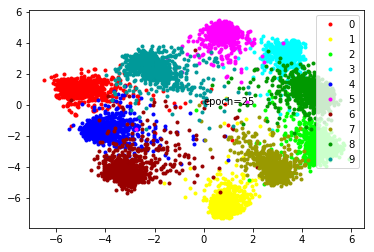

--- epoch 27 ---
--- loss: 1.5202223324775694 % acc: 95.06 %


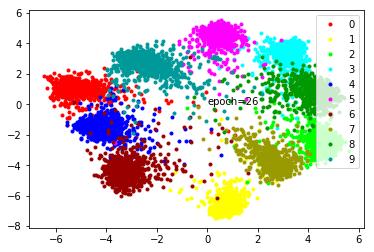

--- epoch 28 ---
--- loss: 1.523010050058365 % acc: 95.1 %


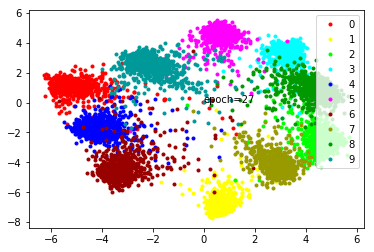

--- epoch 29 ---
--- loss: 1.6263062834739686 % acc: 94.89 %


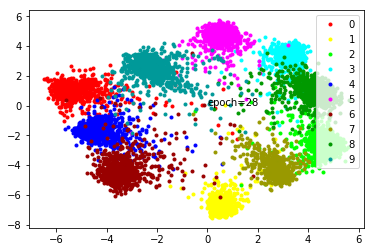

--- epoch 30 ---
--- loss: 1.710037133693695 % acc: 94.38 %


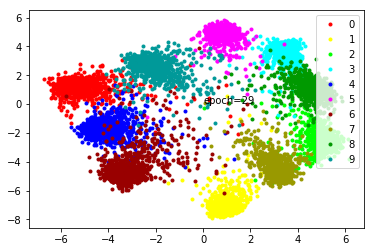

--- epoch 31 ---
--- loss: 1.5461442482471466 % acc: 95.37 %


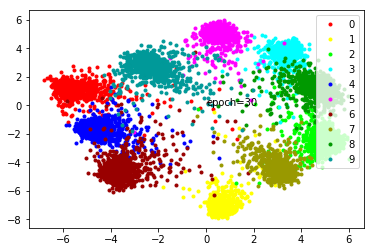

--- epoch 32 ---
--- loss: 1.8144312047958373 % acc: 94.31 %


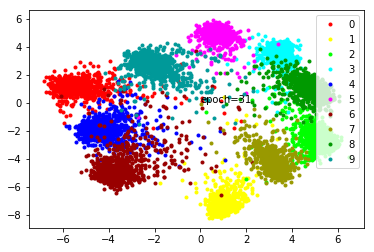

--- epoch 33 ---
--- loss: 1.4945762181282043 % acc: 95.27 %


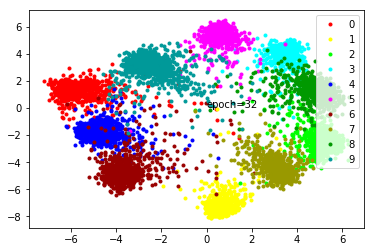

--- epoch 34 ---
--- loss: 1.5765451395511627 % acc: 94.83 %


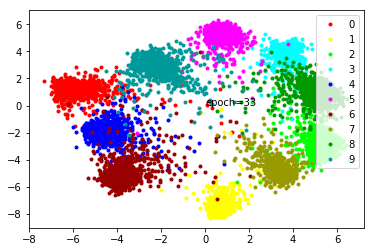

--- epoch 35 ---
--- loss: 1.728470183610916 % acc: 94.17999999999999 %


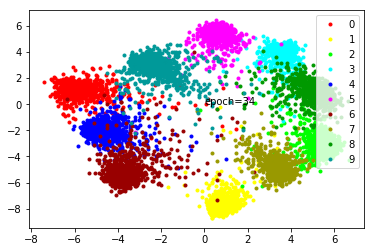

--- epoch 36 ---
--- loss: 1.6228540670871736 % acc: 94.95 %


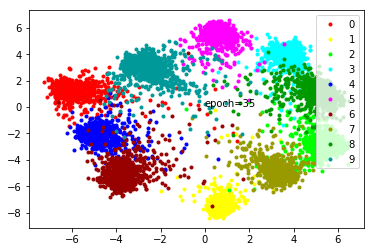

--- epoch 37 ---
--- loss: 1.735142925977707 % acc: 94.78 %


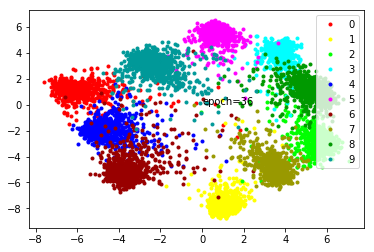

--- epoch 38 ---
--- loss: 1.6676740729808806 % acc: 94.73 %


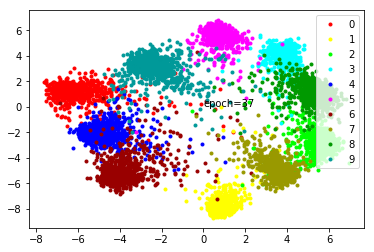

--- epoch 39 ---
--- loss: 1.6579067492485045 % acc: 95.05 %


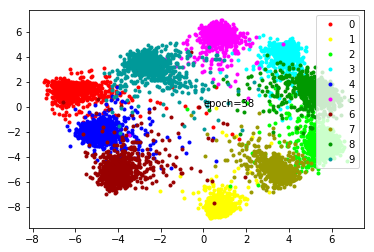

--- epoch 40 ---
--- loss: 1.8064226508140564 % acc: 94.96 %


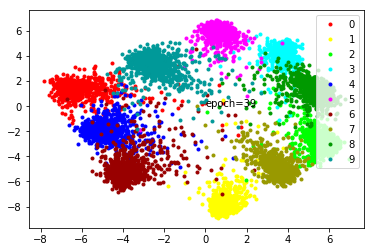

--- epoch 41 ---
--- loss: 1.6542761862277984 % acc: 94.73 %


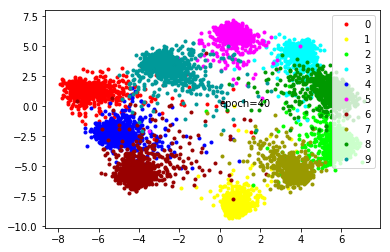

--- epoch 42 ---
--- loss: 1.7819194066524504 % acc: 94.83 %


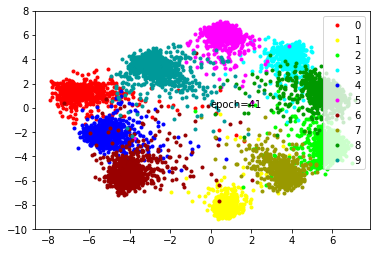

--- epoch 43 ---
--- loss: 1.7452518498897551 % acc: 94.69 %


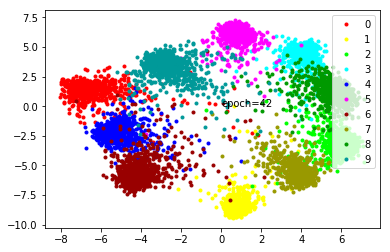

--- epoch 44 ---
--- loss: 1.816965357065201 % acc: 94.8 %


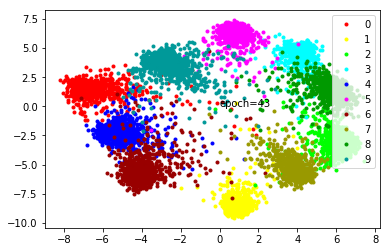

--- epoch 45 ---
--- loss: 1.752402560710907 % acc: 94.83 %


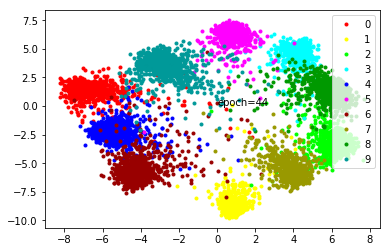

--- epoch 46 ---
--- loss: 1.7671057188510895 % acc: 94.84 %


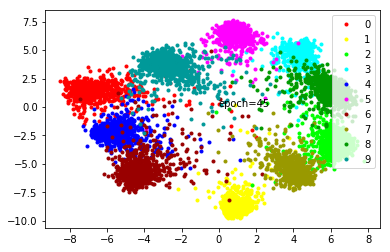

--- epoch 47 ---
--- loss: 1.8018967807292938 % acc: 94.94 %


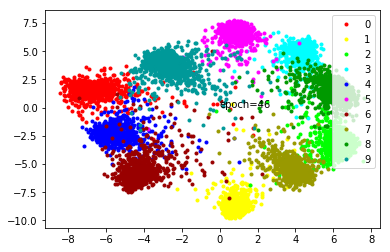

--- epoch 48 ---
--- loss: 1.812261437177658 % acc: 95.14 %


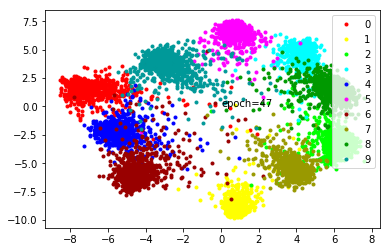

--- epoch 49 ---
--- loss: 1.7699880123138427 % acc: 95.06 %


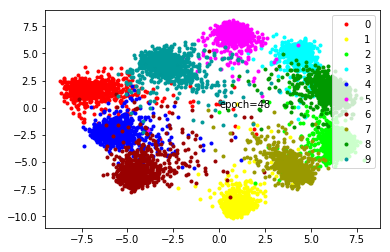

--- epoch 50 ---
--- loss: 1.8255453515052797 % acc: 94.77 %


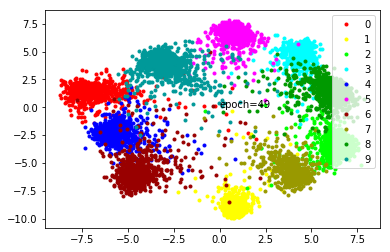

--- epoch 51 ---
--- loss: 1.8114081180095671 % acc: 94.84 %


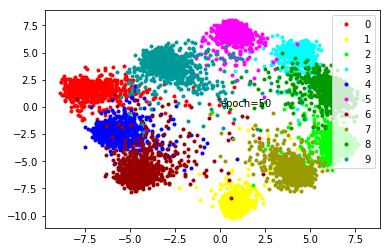

--- epoch 52 ---
--- loss: 1.7911815869808194 % acc: 94.88 %


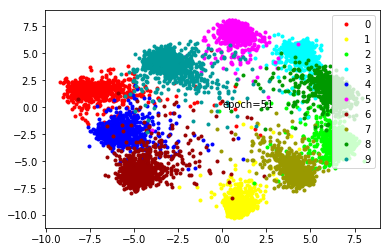

--- epoch 53 ---
--- loss: 1.8454906177520751 % acc: 94.93 %


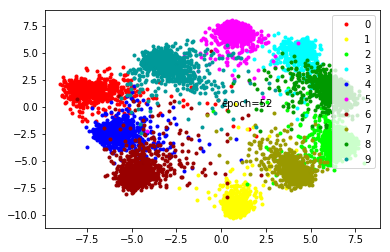

--- epoch 54 ---
--- loss: 1.911095241308212 % acc: 94.93 %


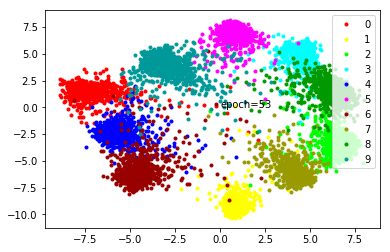

--- epoch 55 ---
--- loss: 1.8952002131938934 % acc: 94.89999999999999 %


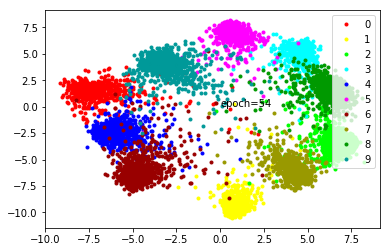

--- epoch 56 ---
--- loss: 1.8387107050418854 % acc: 95.03 %


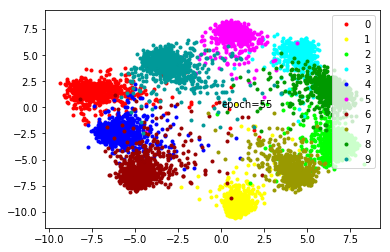

--- epoch 57 ---
--- loss: 1.9280099189281463 % acc: 94.99 %


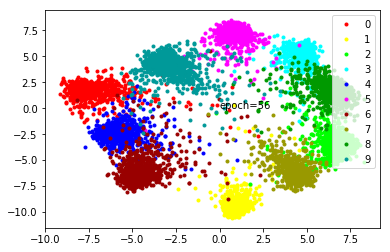

--- epoch 58 ---
--- loss: 2.005377161502838 % acc: 94.95 %


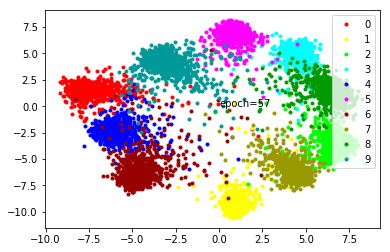

--- epoch 59 ---
--- loss: 1.9588623929023743 % acc: 94.86 %


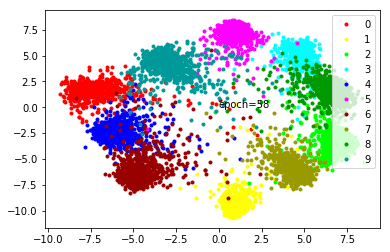

--- epoch 60 ---
--- loss: 1.9523999643325807 % acc: 94.82000000000001 %


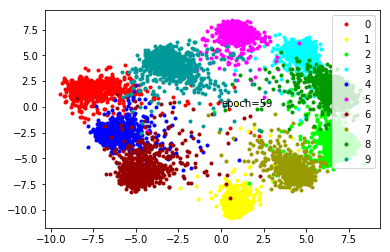

--- epoch 61 ---
--- loss: 1.9900194156169893 % acc: 95.0 %


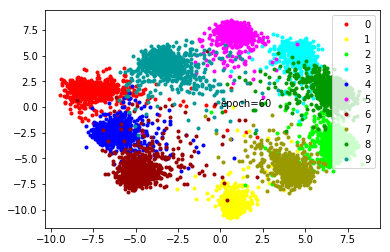

--- epoch 62 ---
--- loss: 1.9216267240047455 % acc: 95.03 %


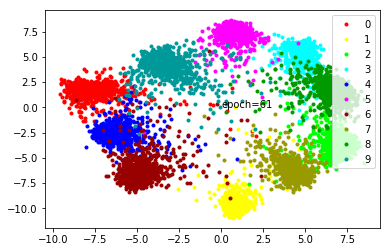

--- epoch 63 ---
--- loss: 1.9825696790218352 % acc: 94.89 %


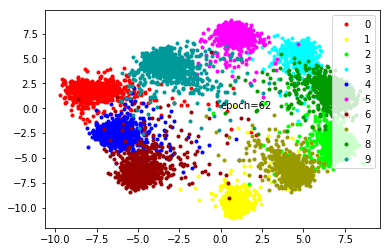

--- epoch 64 ---
--- loss: 2.0589115035533903 % acc: 95.03 %


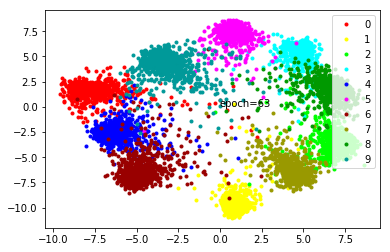

--- epoch 65 ---
--- loss: 2.1009028720855714 % acc: 94.83 %


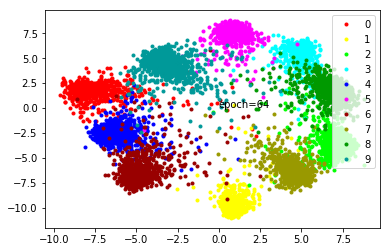

--- epoch 66 ---
--- loss: 2.012914837598801 % acc: 94.98 %


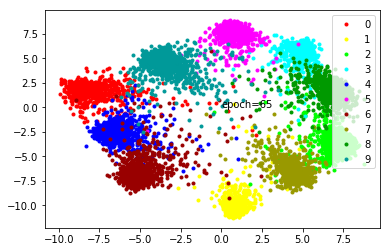

--- epoch 67 ---
--- loss: 2.013164782524109 % acc: 94.96 %


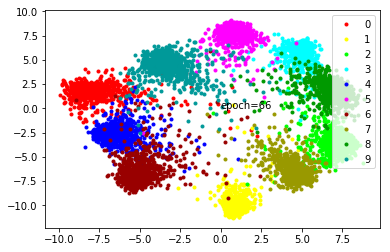

--- epoch 68 ---
--- loss: 2.0396813583374023 % acc: 94.85 %


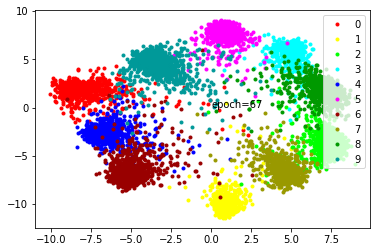

--- epoch 69 ---
--- loss: 2.1061285161972045 % acc: 95.04 %


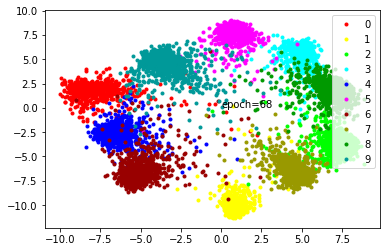

--- epoch 70 ---
--- loss: 2.0870207214355467 % acc: 95.04 %


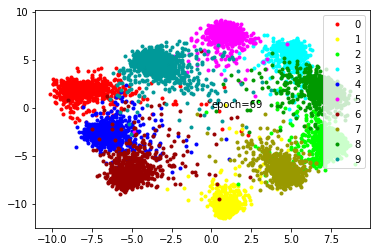

--- epoch 71 ---
--- loss: 2.1007786214351656 % acc: 95.00999999999999 %


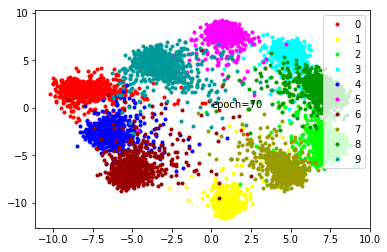

--- epoch 72 ---
--- loss: 2.0906112539768222 % acc: 94.97 %


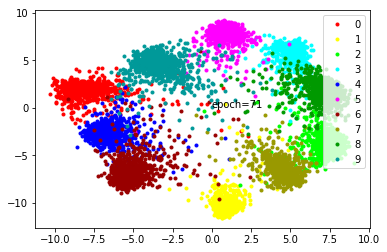

--- epoch 73 ---
--- loss: 2.1271083235740664 % acc: 94.97 %


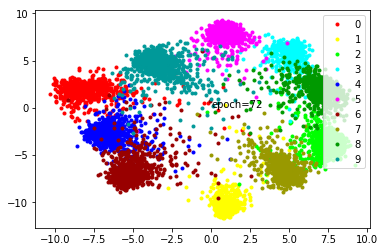

--- epoch 74 ---
--- loss: 2.1453109550476075 % acc: 94.95 %


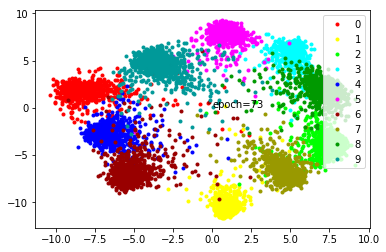

--- epoch 75 ---
--- loss: 2.117135590314865 % acc: 95.16 %


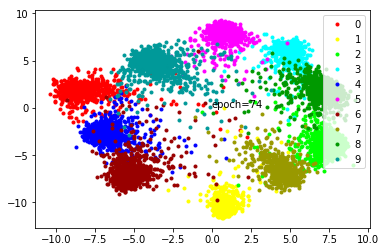

--- epoch 76 ---
--- loss: 2.172333816289902 % acc: 94.92 %


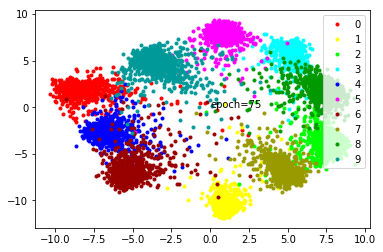

--- epoch 77 ---
--- loss: 2.1342634642124176 % acc: 95.05 %


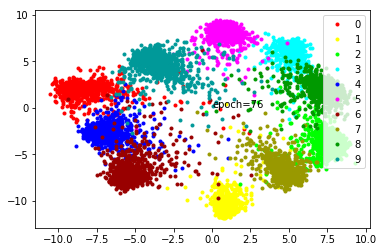

--- epoch 78 ---
--- loss: 2.166558898687363 % acc: 95.00999999999999 %


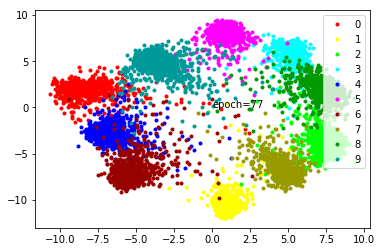

--- epoch 79 ---
--- loss: 2.170967814922333 % acc: 95.05 %


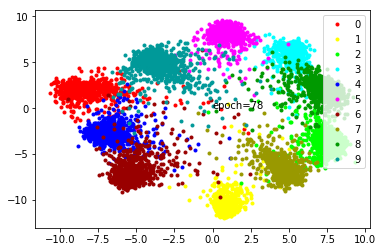

--- epoch 80 ---
--- loss: 2.174832147359848 % acc: 94.87 %


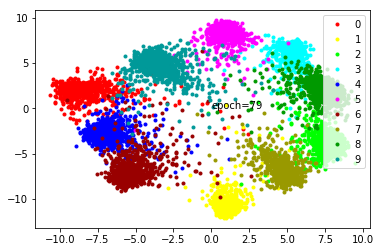

--- epoch 81 ---
--- loss: 2.2316021716594694 % acc: 94.89 %


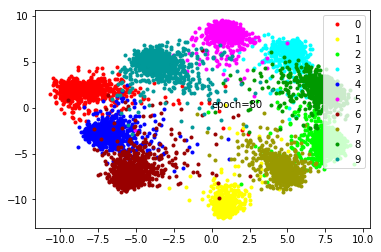

--- epoch 82 ---
--- loss: 2.2537230229377747 % acc: 94.92 %


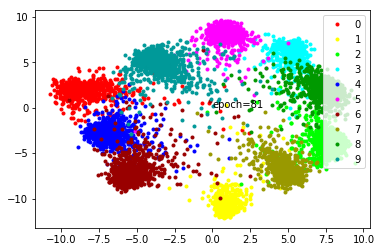

--- epoch 83 ---
--- loss: 2.256305329799652 % acc: 94.97 %


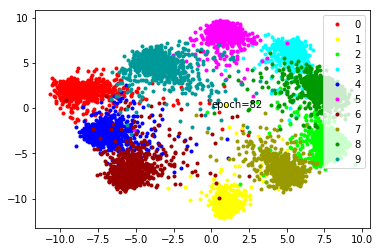

--- epoch 84 ---
--- loss: 2.2215223371982575 % acc: 94.97 %


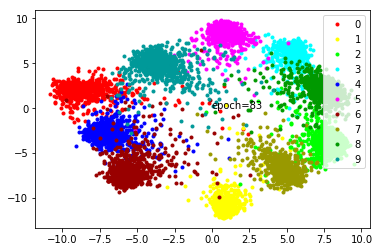

--- epoch 85 ---
--- loss: 2.287207542657852 % acc: 94.98 %


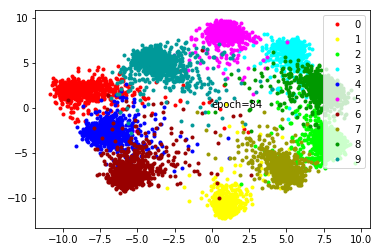

--- epoch 86 ---
--- loss: 2.3075438535213473 % acc: 94.89999999999999 %


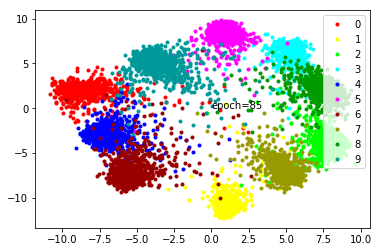

--- epoch 87 ---
--- loss: 2.2953021490573886 % acc: 94.92 %


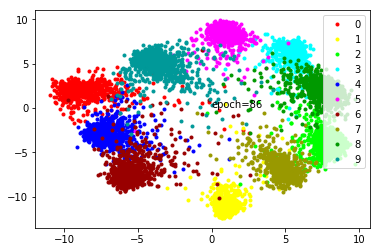

--- epoch 88 ---
--- loss: 2.293264605998993 % acc: 94.93 %


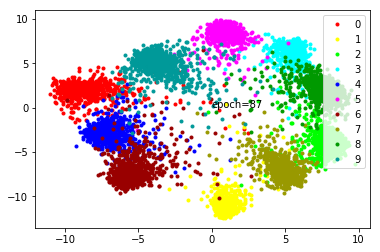

--- epoch 89 ---
--- loss: 2.343118985891342 % acc: 95.04 %


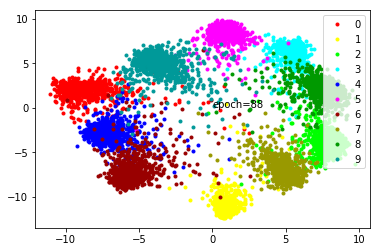

--- epoch 90 ---
--- loss: 2.320907989740372 % acc: 94.89 %


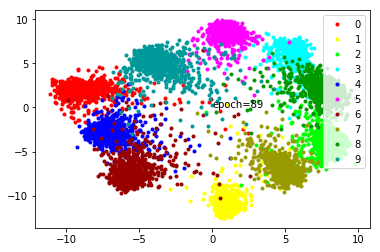

--- epoch 91 ---
--- loss: 2.3229819285869597 % acc: 94.96 %


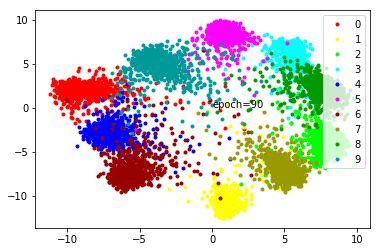

--- epoch 92 ---
--- loss: 2.369309468269348 % acc: 94.89999999999999 %


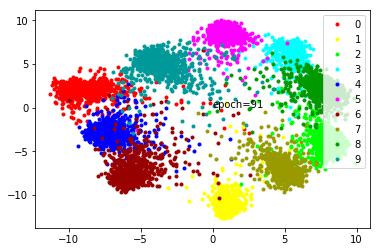

--- epoch 93 ---
--- loss: 2.402814759016037 % acc: 94.95 %


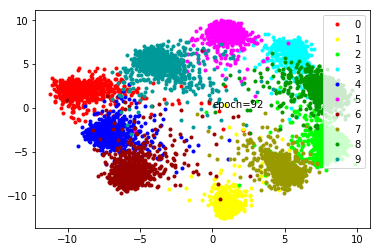

--- epoch 94 ---
--- loss: 2.3936283457279206 % acc: 94.92 %


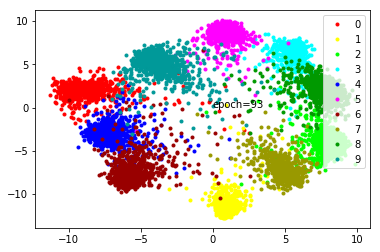

--- epoch 95 ---
--- loss: 2.419810926914215 % acc: 94.92 %


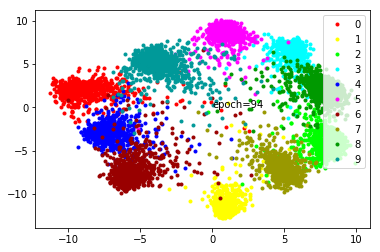

--- epoch 96 ---
--- loss: 2.406706767082214 % acc: 94.93 %


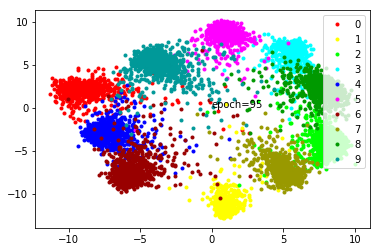

--- epoch 97 ---
--- loss: 2.401603202819824 % acc: 94.99 %


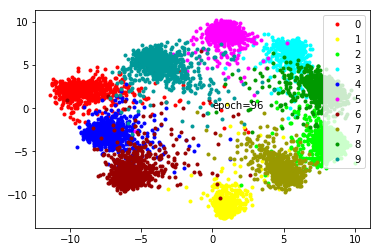

--- epoch 98 ---
--- loss: 2.477889956235886 % acc: 94.94 %


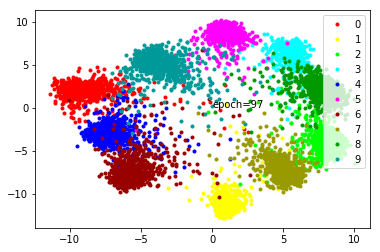

--- epoch 99 ---
--- loss: 2.4209981060028074 % acc: 94.93 %


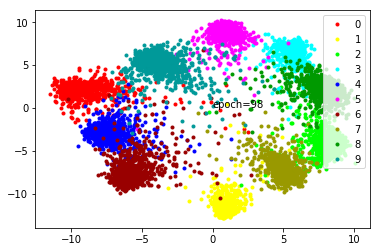

--- epoch 100 ---
--- loss: 2.405486236810684 % acc: 94.95 %


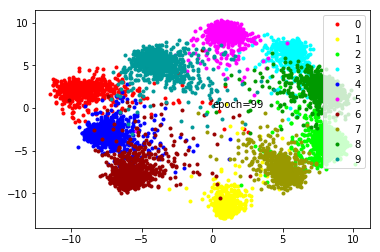

In [14]:
run_model_with_test_data(Net().to(device), 1, CenterLossAutograd(10, 2).to(device), 'test_auto_1')

--- epoch 1 ---
--- loss: 1.8215874266624452 % acc: 10.280000000000001 %


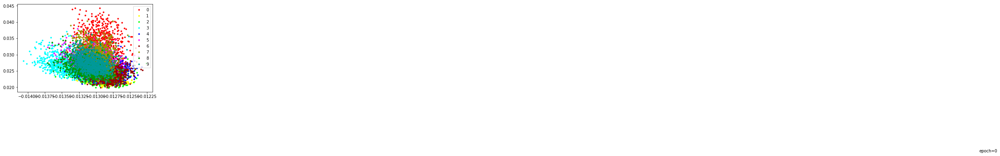

--- epoch 2 ---
--- loss: 1.765645844936371 % acc: 30.79 %


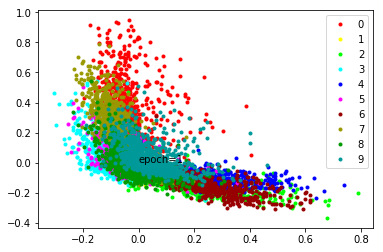

--- epoch 3 ---
--- loss: 1.6524567484855652 % acc: 44.9 %


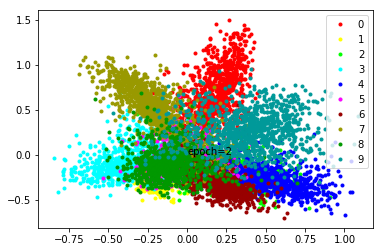

--- epoch 4 ---
--- loss: 1.486127449274063 % acc: 65.14999999999999 %


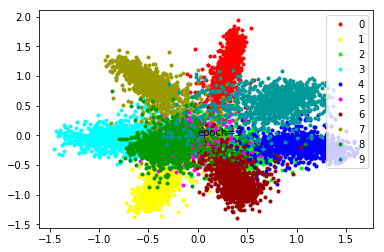

--- epoch 5 ---
--- loss: 1.3466509425640105 % acc: 66.97999999999999 %


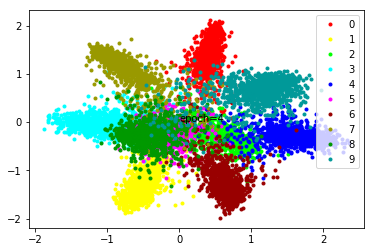

--- epoch 6 ---
--- loss: 1.2719314801692962 % acc: 75.33 %


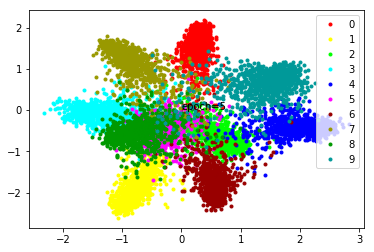

--- epoch 7 ---
--- loss: 1.2189213716983793 % acc: 81.08999999999999 %


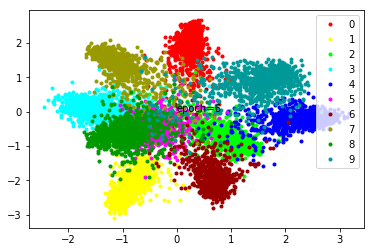

--- epoch 8 ---
--- loss: 1.1406031572818756 % acc: 82.12 %


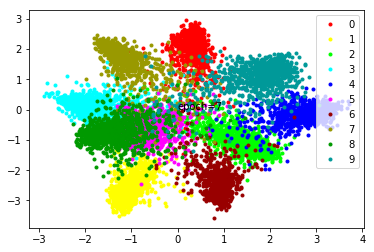

--- epoch 9 ---
--- loss: 1.1407474184036255 % acc: 78.89 %


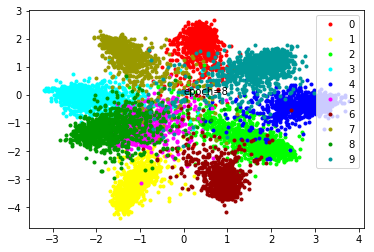

--- epoch 10 ---
--- loss: 1.11545178771019 % acc: 85.02 %


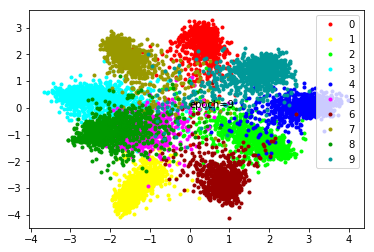

--- epoch 11 ---
--- loss: 1.0775619983673097 % acc: 84.93 %


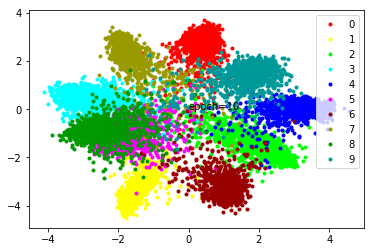

--- epoch 12 ---
--- loss: 1.0866695761680603 % acc: 86.83999999999999 %


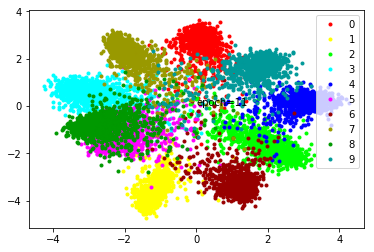

--- epoch 13 ---
--- loss: 1.0363508474826812 % acc: 87.13 %


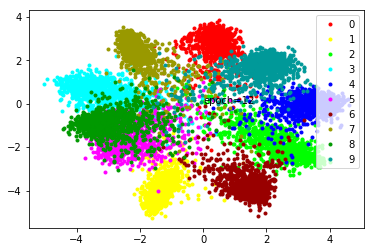

--- epoch 14 ---
--- loss: 0.9763564217090607 % acc: 89.18 %


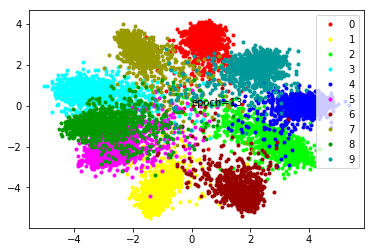

--- epoch 15 ---
--- loss: 0.9414909648895263 % acc: 88.12 %


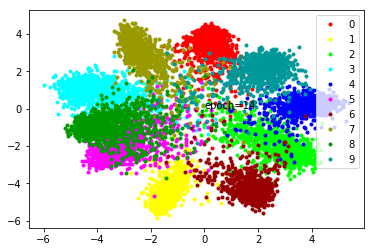

--- epoch 16 ---
--- loss: 0.8833103412389754 % acc: 90.58 %


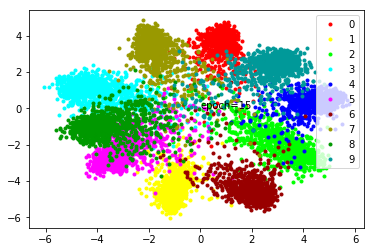

--- epoch 17 ---
--- loss: 0.90323492705822 % acc: 89.01 %


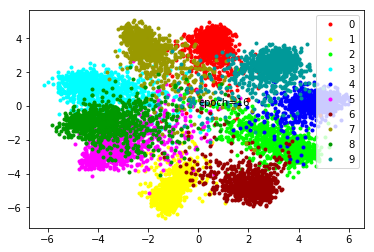

--- epoch 18 ---
--- loss: 0.8533222728967665 % acc: 89.98 %


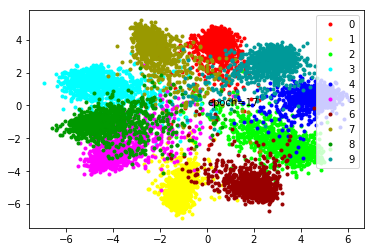

--- epoch 19 ---
--- loss: 0.8432904577255249 % acc: 90.25999999999999 %


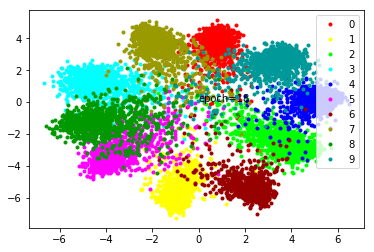

--- epoch 20 ---
--- loss: 0.8101903563737869 % acc: 90.66 %


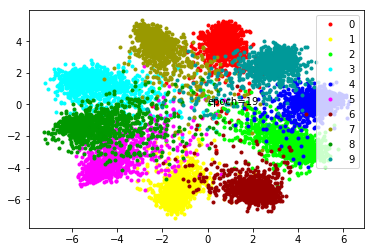

--- epoch 21 ---
--- loss: 0.7731760221719742 % acc: 90.82000000000001 %


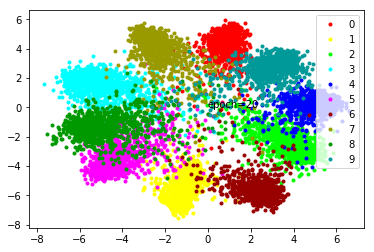

--- epoch 22 ---
--- loss: 0.762776501774788 % acc: 91.16 %


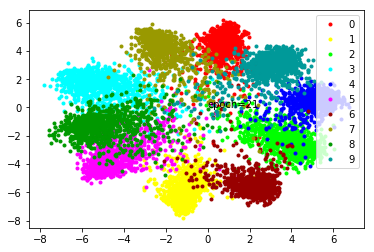

--- epoch 23 ---
--- loss: 0.7341828536987305 % acc: 90.98 %


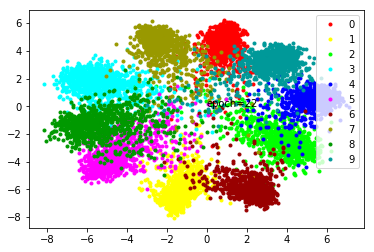

--- epoch 24 ---
--- loss: 0.7367511719465256 % acc: 90.78 %


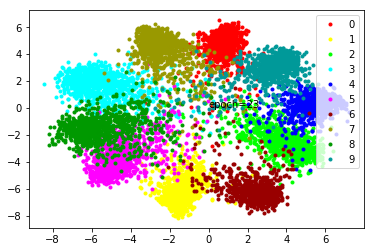

--- epoch 25 ---
--- loss: 0.7220647639036178 % acc: 91.33 %


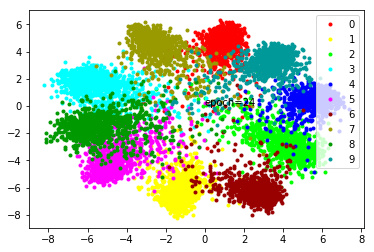

--- epoch 26 ---
--- loss: 0.7111483794450759 % acc: 91.45 %


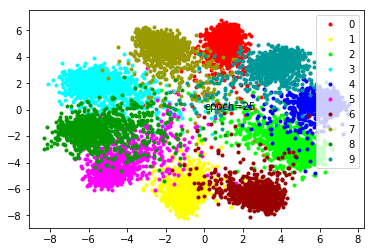

--- epoch 27 ---
--- loss: 0.7163995969295501 % acc: 91.59 %


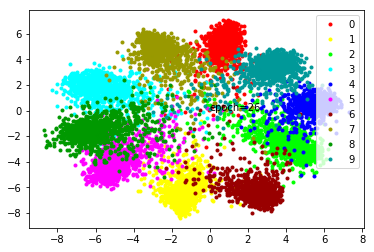

--- epoch 28 ---
--- loss: 0.6985256314277649 % acc: 91.2 %


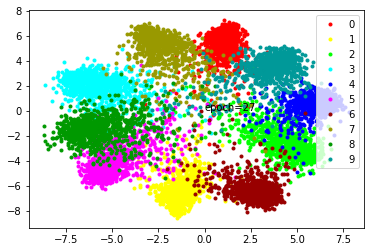

--- epoch 29 ---
--- loss: 0.7253063851594925 % acc: 90.86999999999999 %


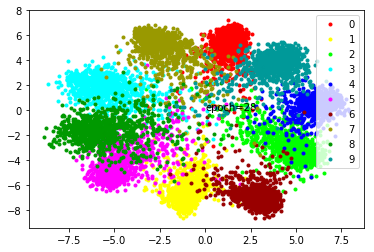

--- epoch 30 ---
--- loss: 0.6835714662075043 % acc: 91.36999999999999 %


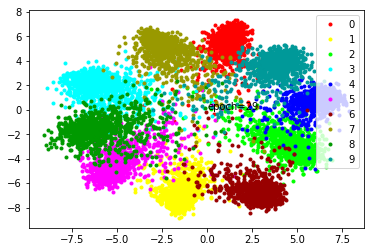

--- epoch 31 ---
--- loss: 0.6889172154664993 % acc: 91.84 %


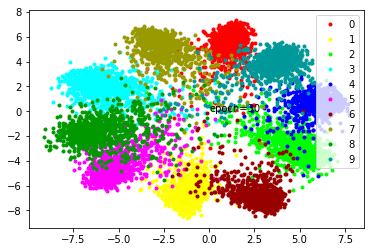

--- epoch 32 ---
--- loss: 0.6957181447744369 % acc: 91.31 %


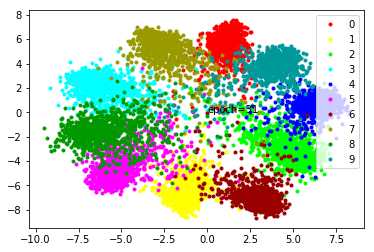

--- epoch 33 ---
--- loss: 0.6863393807411194 % acc: 91.13 %


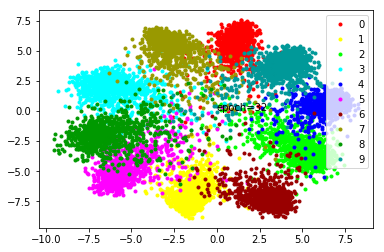

--- epoch 34 ---
--- loss: 0.6788329344987869 % acc: 91.44 %


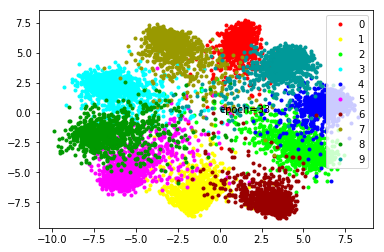

--- epoch 35 ---
--- loss: 0.6833457344770432 % acc: 91.12 %


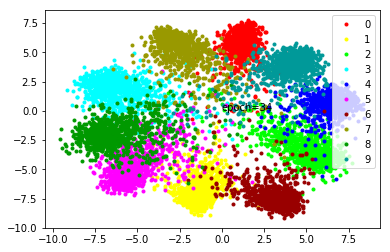

--- epoch 36 ---
--- loss: 0.6844133955240249 % acc: 91.31 %


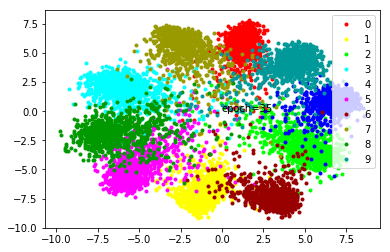

--- epoch 37 ---
--- loss: 0.6799970233440399 % acc: 91.31 %


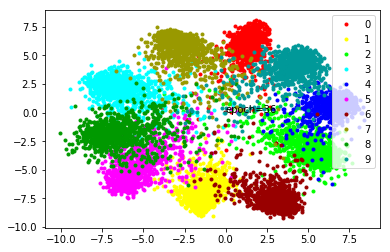

--- epoch 38 ---
--- loss: 0.6848575687408447 % acc: 91.57 %


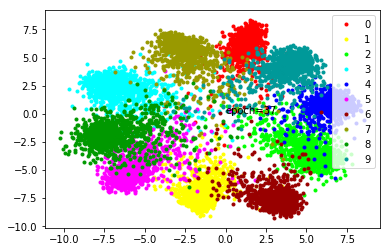

--- epoch 39 ---
--- loss: 0.677651292681694 % acc: 91.81 %


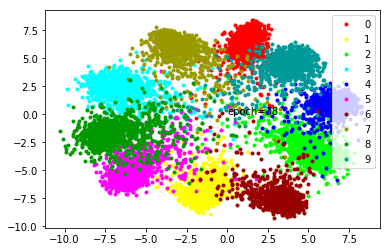

--- epoch 40 ---
--- loss: 0.6744924449920654 % acc: 91.11 %


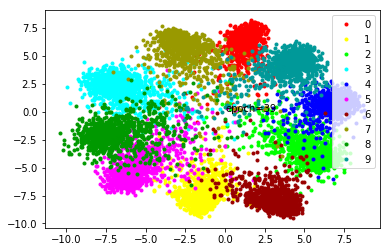

--- epoch 41 ---
--- loss: 0.6779326206445694 % acc: 91.38 %


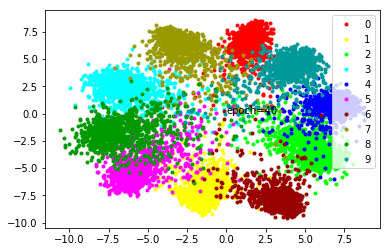

--- epoch 42 ---
--- loss: 0.6793217000365257 % acc: 91.25999999999999 %


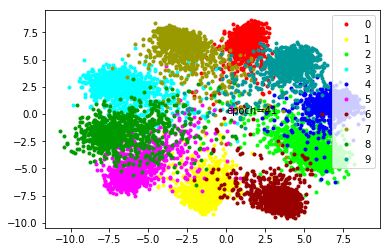

--- epoch 43 ---
--- loss: 0.6876383233070373 % acc: 91.31 %


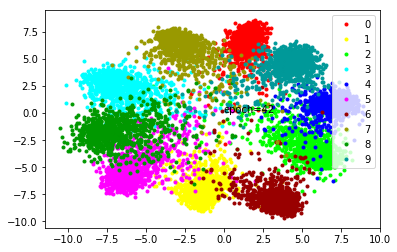

--- epoch 44 ---
--- loss: 0.6691739571094513 % acc: 91.56 %


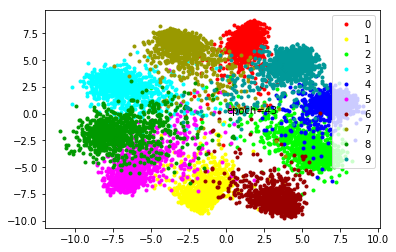

--- epoch 45 ---
--- loss: 0.6773686742782592 % acc: 91.07 %


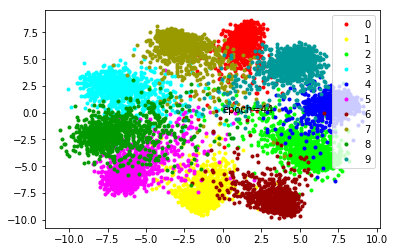

--- epoch 46 ---
--- loss: 0.6888730686903 % acc: 91.3 %


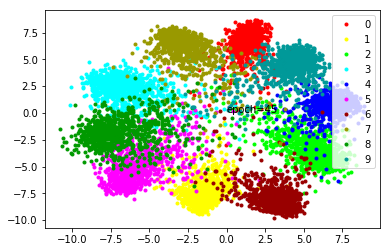

--- epoch 47 ---
--- loss: 0.6880831086635589 % acc: 91.34 %


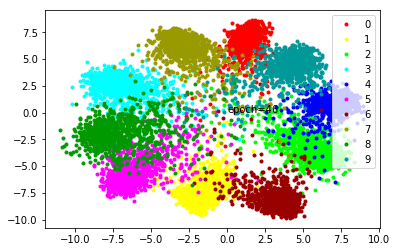

--- epoch 48 ---
--- loss: 0.6969314652681351 % acc: 91.3 %


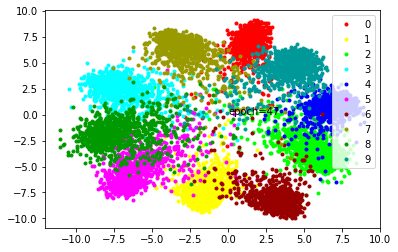

--- epoch 49 ---
--- loss: 0.6803301811218262 % acc: 91.57 %


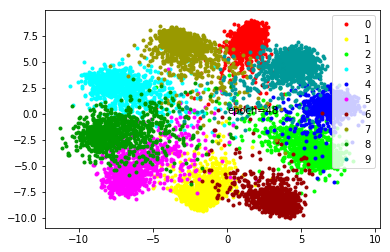

--- epoch 50 ---
--- loss: 0.6874006199836731 % acc: 91.47 %


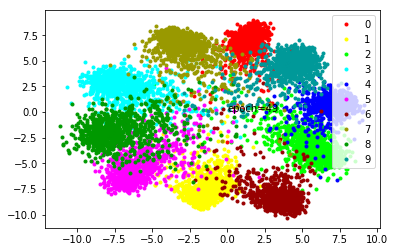

--- epoch 51 ---
--- loss: 0.6907482689619064 % acc: 91.22 %


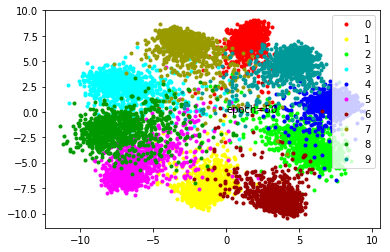

--- epoch 52 ---
--- loss: 0.6900884217023849 % acc: 91.43 %


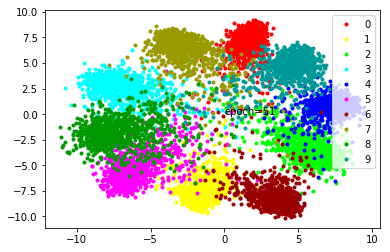

--- epoch 53 ---
--- loss: 0.6999733680486679 % acc: 91.16 %


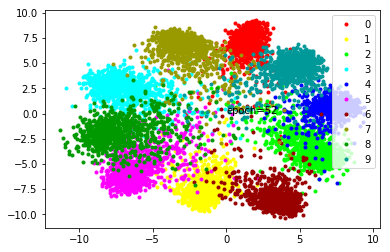

--- epoch 54 ---
--- loss: 0.6983238112926483 % acc: 91.36 %


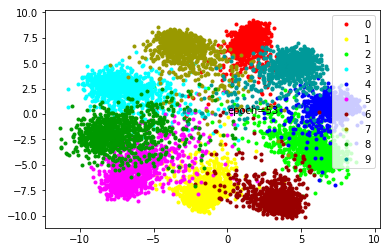

--- epoch 55 ---
--- loss: 0.7117235231399536 % acc: 91.46 %


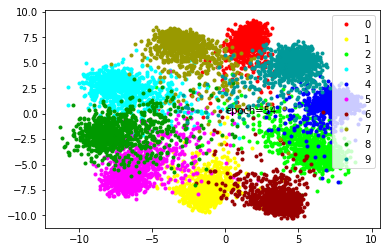

--- epoch 56 ---
--- loss: 0.7001742833852768 % acc: 91.36999999999999 %


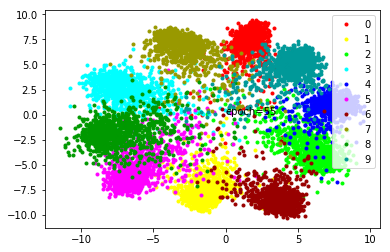

--- epoch 57 ---
--- loss: 0.7016693186759949 % acc: 91.25999999999999 %


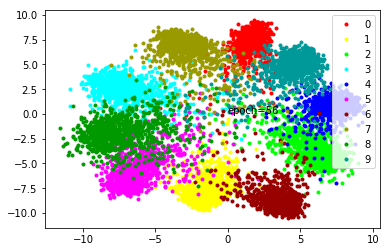

--- epoch 58 ---
--- loss: 0.7095009082555771 % acc: 91.31 %


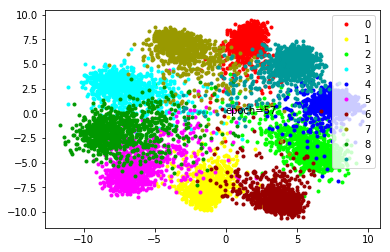

--- epoch 59 ---
--- loss: 0.7131277287006378 % acc: 91.08000000000001 %


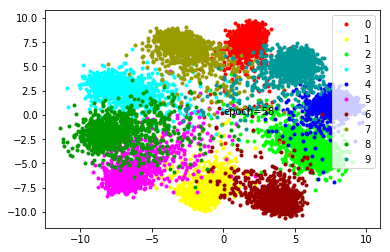

--- epoch 60 ---
--- loss: 0.7182700446248055 % acc: 91.35 %


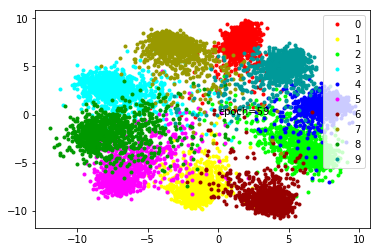

--- epoch 61 ---
--- loss: 0.7068362230062485 % acc: 91.45 %


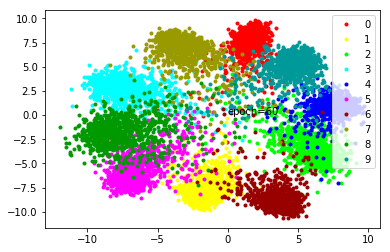

--- epoch 62 ---
--- loss: 0.7059327000379563 % acc: 91.4 %


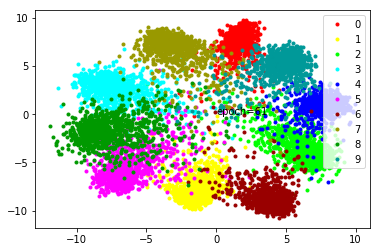

--- epoch 63 ---
--- loss: 0.7087322628498077 % acc: 91.38 %


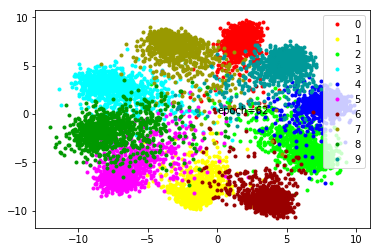

--- epoch 64 ---
--- loss: 0.7125025582313538 % acc: 91.27 %


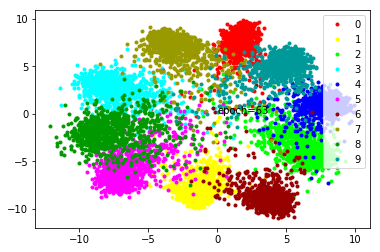

--- epoch 65 ---
--- loss: 0.7177070468664168 % acc: 91.36999999999999 %


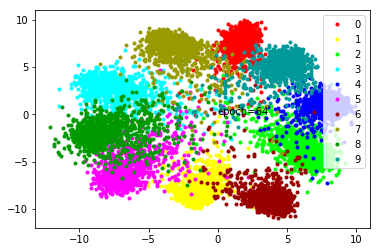

--- epoch 66 ---
--- loss: 0.7111146867275239 % acc: 91.36999999999999 %


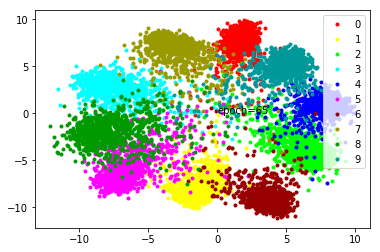

--- epoch 67 ---
--- loss: 0.7080949074029922 % acc: 91.38 %


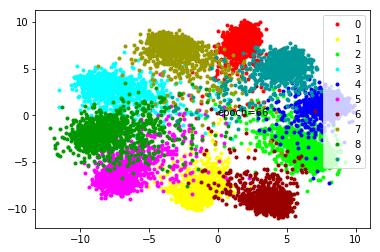

--- epoch 68 ---
--- loss: 0.752783863544464 % acc: 91.36999999999999 %


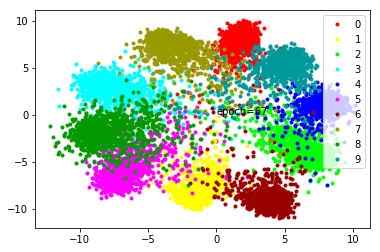

--- epoch 69 ---
--- loss: 0.7229381638765335 % acc: 91.43 %


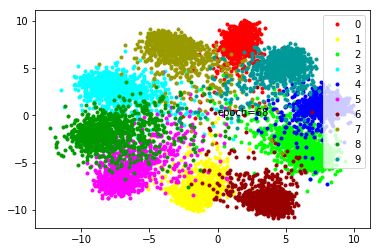

--- epoch 70 ---
--- loss: 0.7138489699363709 % acc: 91.42 %


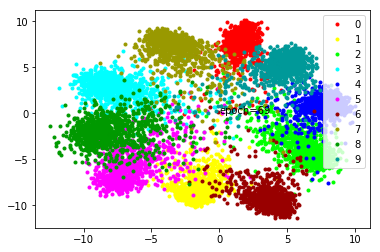

--- epoch 71 ---
--- loss: 0.7393867218494415 % acc: 91.24 %


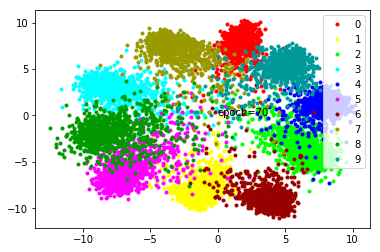

--- epoch 72 ---
--- loss: 0.7293473255634308 % acc: 91.33 %


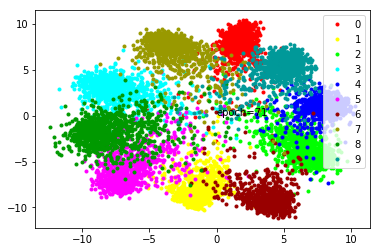

--- epoch 73 ---
--- loss: 0.7267632484436035 % acc: 91.31 %


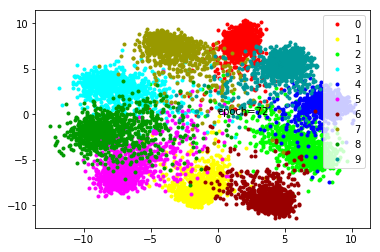

--- epoch 74 ---
--- loss: 0.7333690989017486 % acc: 91.32000000000001 %


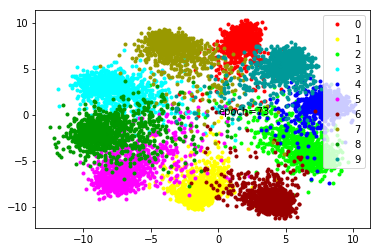

--- epoch 75 ---
--- loss: 0.7312187743186951 % acc: 91.27 %


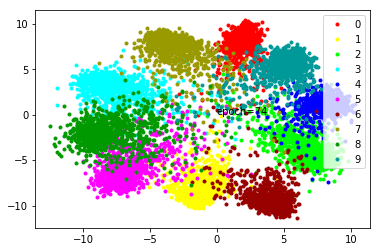

--- epoch 76 ---
--- loss: 0.7414462155103684 % acc: 91.3 %


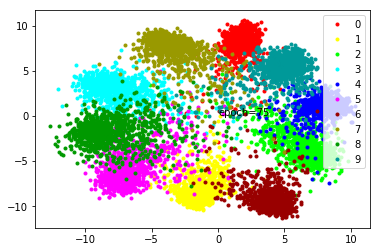

--- epoch 77 ---
--- loss: 0.7396416503190995 % acc: 91.28 %


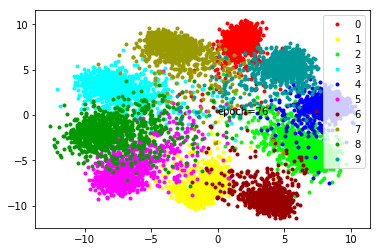

--- epoch 78 ---
--- loss: 0.7419330531358719 % acc: 91.25999999999999 %


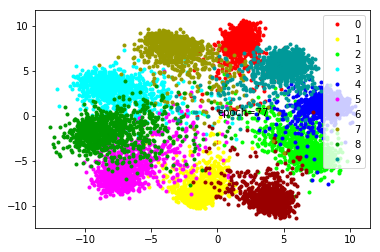

--- epoch 79 ---
--- loss: 0.7714288121461867 % acc: 91.33 %


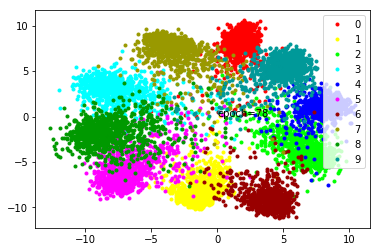

--- epoch 80 ---
--- loss: 0.7424642217159271 % acc: 91.33 %


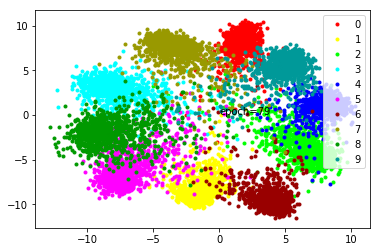

--- epoch 81 ---
--- loss: 0.7441038459539413 % acc: 91.25 %


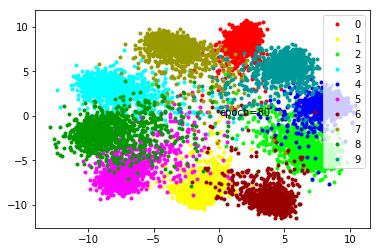

--- epoch 82 ---
--- loss: 0.7542788302898407 % acc: 91.32000000000001 %


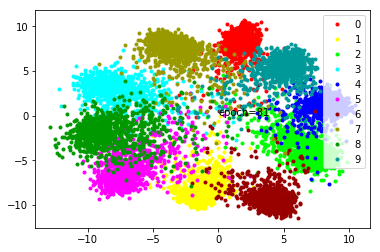

--- epoch 83 ---
--- loss: 0.7493525114655495 % acc: 91.12 %


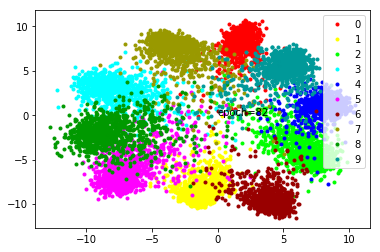

--- epoch 84 ---
--- loss: 0.7502668362855912 % acc: 91.25 %


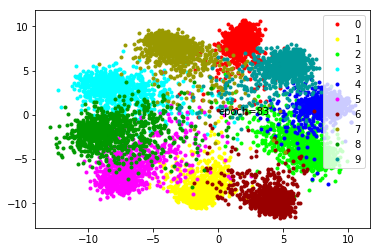

--- epoch 85 ---
--- loss: 0.763175402879715 % acc: 91.10000000000001 %


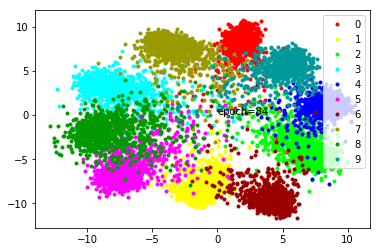

--- epoch 86 ---
--- loss: 0.7599770194292068 % acc: 91.17 %


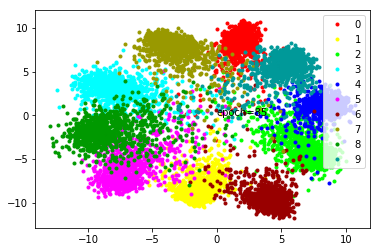

--- epoch 87 ---
--- loss: 0.7595016443729401 % acc: 91.19 %


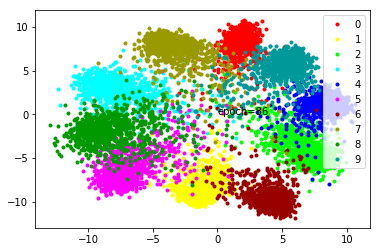

--- epoch 88 ---
--- loss: 0.7579818093776702 % acc: 91.25999999999999 %


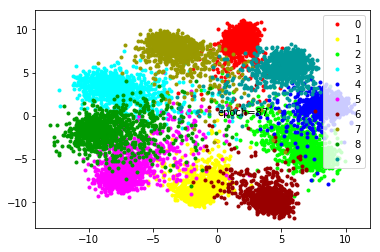

--- epoch 89 ---
--- loss: 0.7606896513700485 % acc: 91.17 %


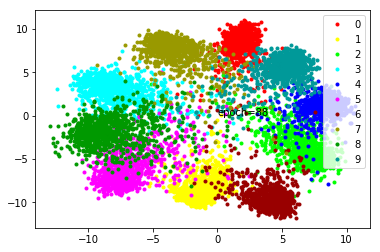

--- epoch 90 ---
--- loss: 0.7665106907486916 % acc: 91.07 %


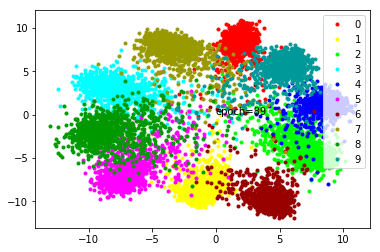

--- epoch 91 ---
--- loss: 0.7647912293672562 % acc: 91.11 %


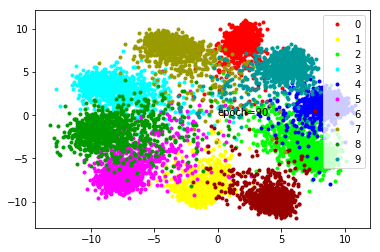

--- epoch 92 ---
--- loss: 0.7714076948165893 % acc: 91.0 %


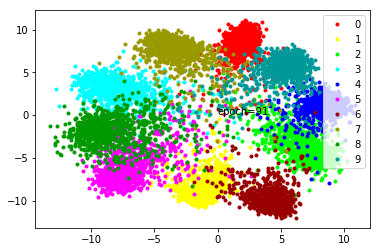

--- epoch 93 ---
--- loss: 0.7696932452917099 % acc: 91.05 %


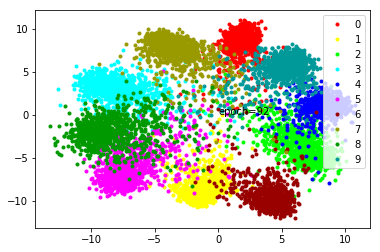

--- epoch 94 ---
--- loss: 0.7733153700828552 % acc: 90.98 %


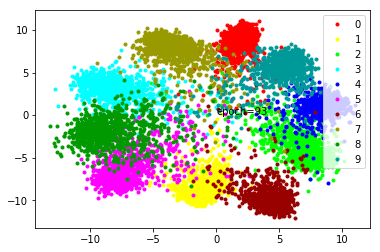

--- epoch 95 ---
--- loss: 0.7713618046045303 % acc: 91.18 %


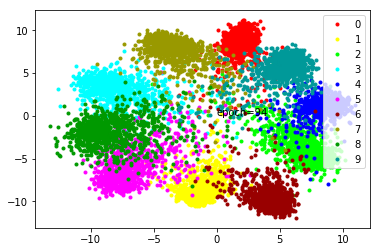

--- epoch 96 ---
--- loss: 0.7853139299154281 % acc: 91.13 %


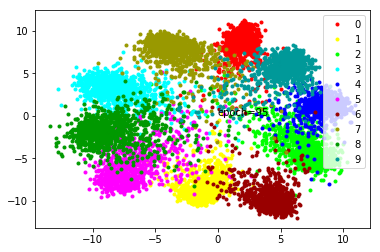

--- epoch 97 ---
--- loss: 0.7742459321022034 % acc: 91.12 %


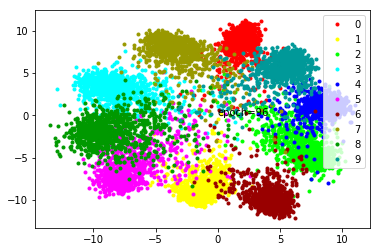

--- epoch 98 ---
--- loss: 0.7847808474302291 % acc: 91.03999999999999 %


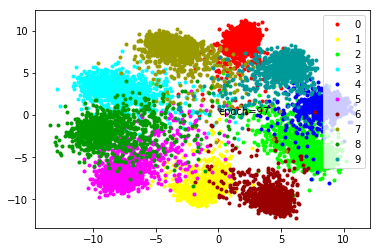

--- epoch 99 ---
--- loss: 0.7836454576253892 % acc: 91.08000000000001 %


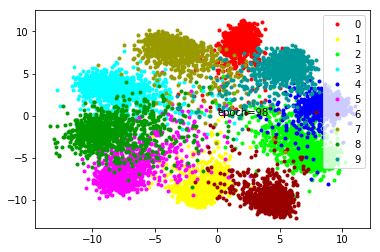

--- epoch 100 ---
--- loss: 0.7862938103079796 % acc: 91.08000000000001 %


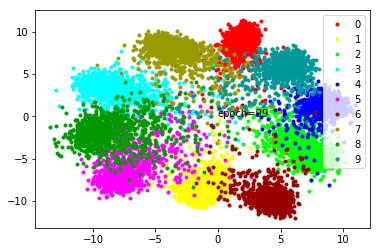

In [11]:
run_model_with_test_data(Net().to(device), 0.1, CenterLoss(10, 2).to(device), 'test_paper_0.1')

--- epoch 1 ---
--- loss: 1.8319166588783262 % acc: 9.74 %


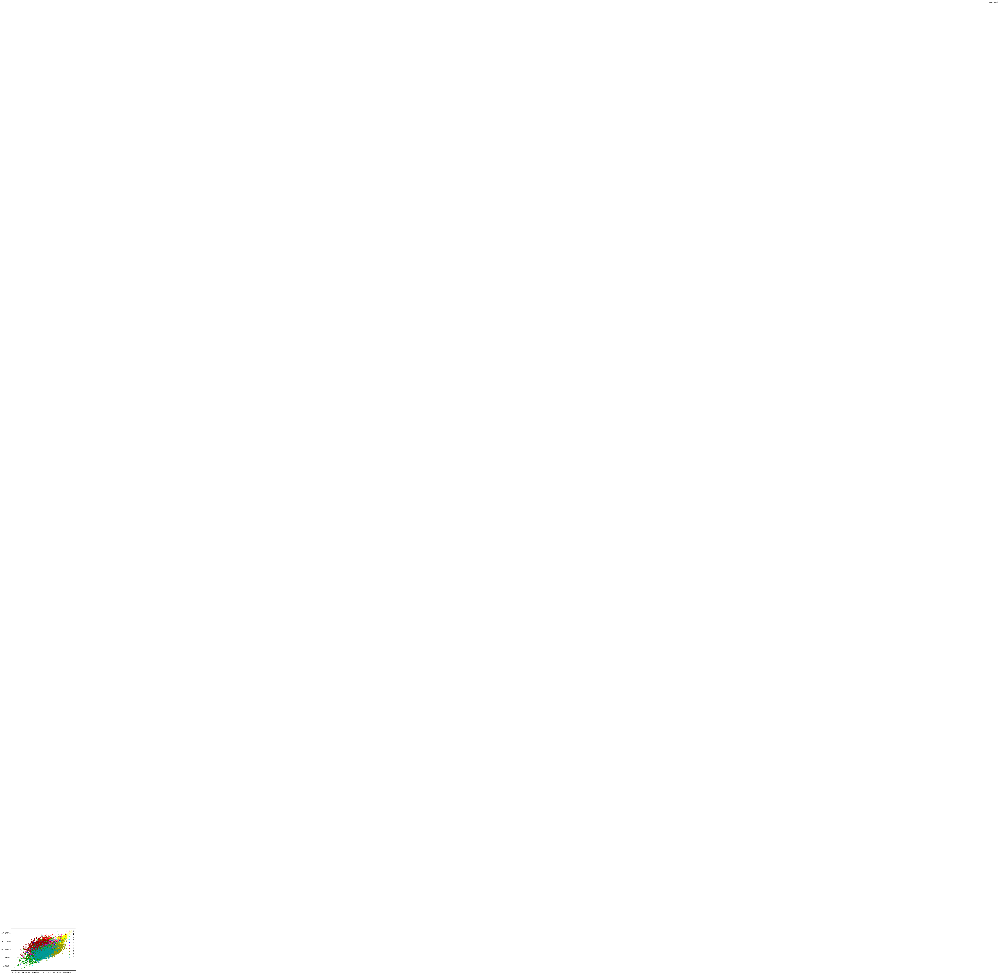

--- epoch 2 ---
--- loss: 1.8197571277618407 % acc: 9.74 %


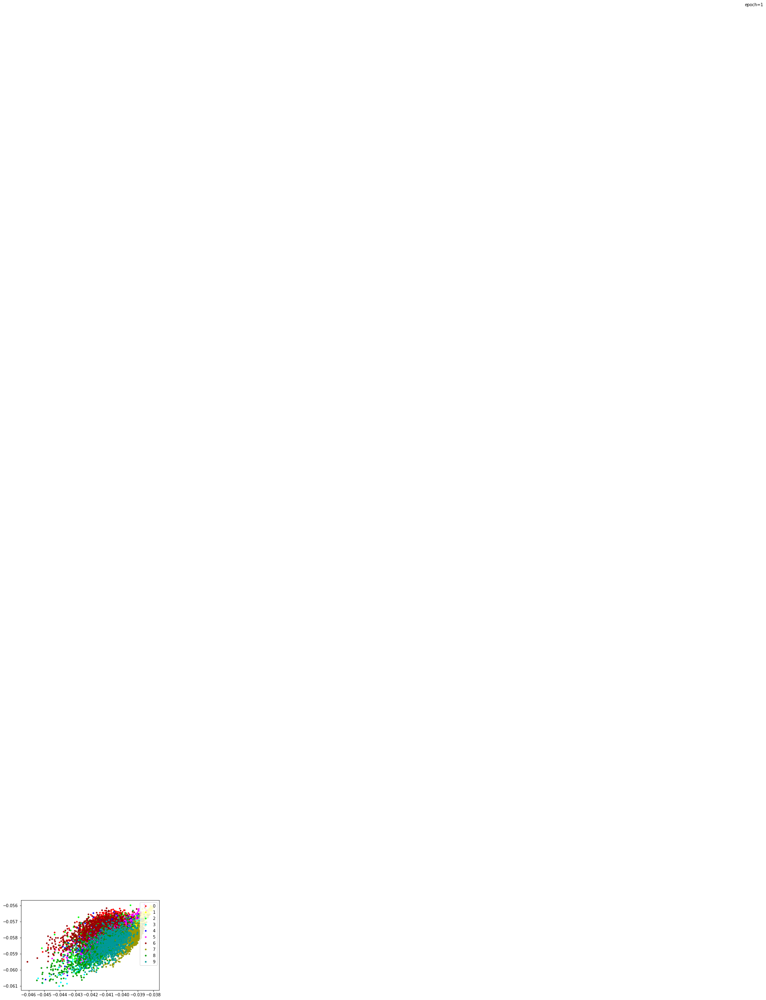

--- epoch 3 ---
--- loss: 1.8203457069396973 % acc: 9.74 %


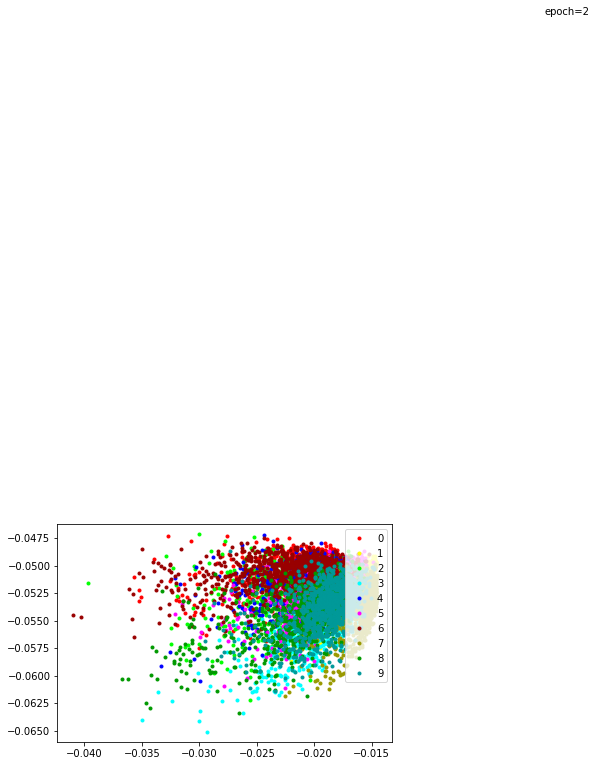

--- epoch 4 ---
--- loss: 1.825125229358673 % acc: 10.89 %


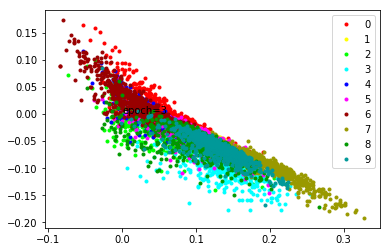

--- epoch 5 ---
--- loss: 1.8374607706069948 % acc: 16.0 %


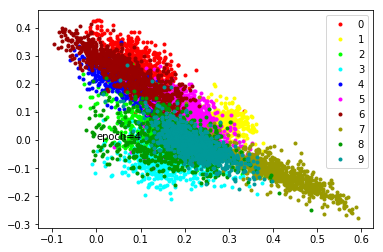

--- epoch 6 ---
--- loss: 1.8040864253044127 % acc: 32.4 %


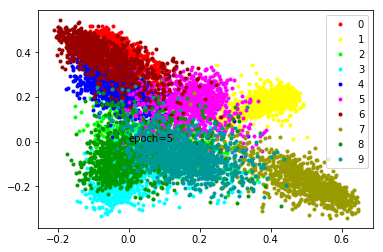

--- epoch 7 ---
--- loss: 1.7553345942497252 % acc: 44.190000000000005 %


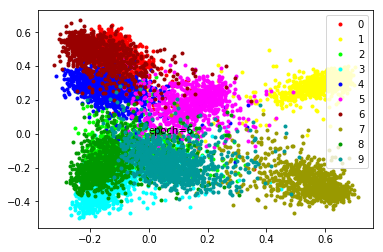

--- epoch 8 ---
--- loss: 1.746964349746704 % acc: 46.81 %


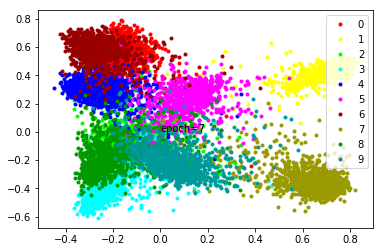

--- epoch 9 ---
--- loss: 1.7424410271644593 % acc: 52.559999999999995 %


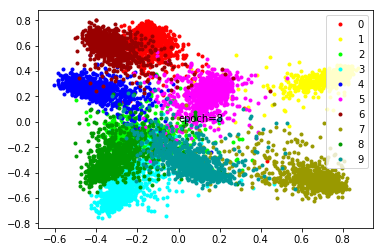

--- epoch 10 ---
--- loss: 1.7499625873565672 % acc: 58.97 %


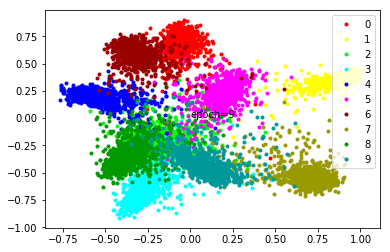

--- epoch 11 ---
--- loss: 1.717654893398285 % acc: 65.91 %


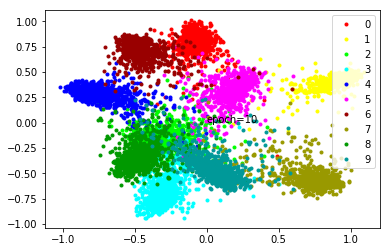

--- epoch 12 ---
--- loss: 1.7103016042709351 % acc: 72.98 %


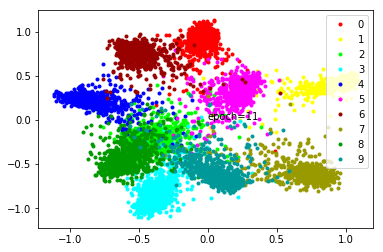

--- epoch 13 ---
--- loss: 1.6736073565483096 % acc: 76.85 %


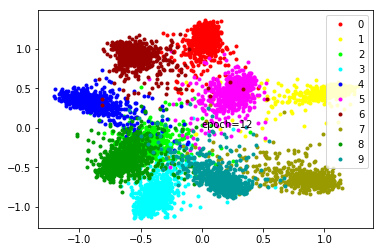

--- epoch 14 ---
--- loss: 1.6088658392429351 % acc: 79.61 %


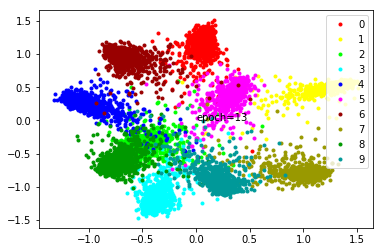

--- epoch 15 ---
--- loss: 1.5541967701911927 % acc: 83.19 %


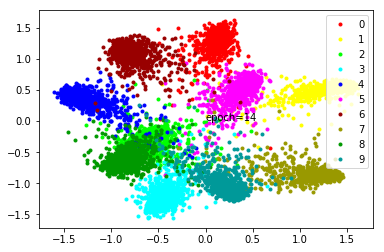

--- epoch 16 ---
--- loss: 1.5357192194461822 % acc: 85.0 %


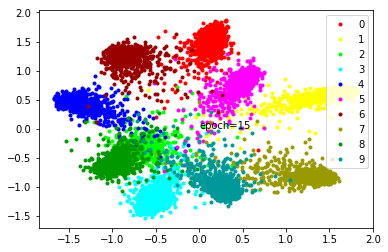

--- epoch 17 ---
--- loss: 1.4682147097587586 % acc: 85.46000000000001 %


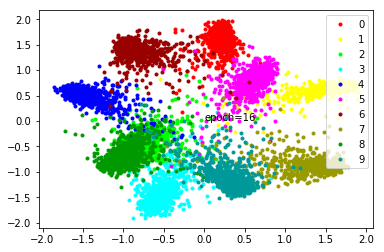

--- epoch 18 ---
--- loss: 1.4781695127487182 % acc: 88.69 %


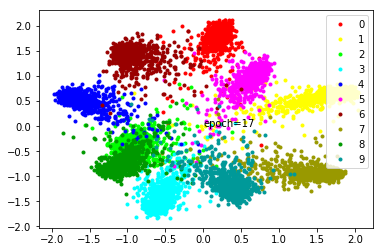

--- epoch 19 ---
--- loss: 1.4456022548675538 % acc: 87.94 %


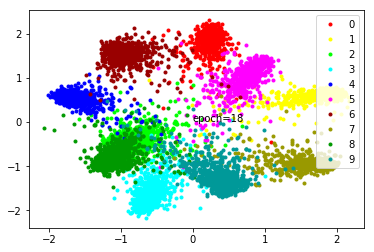

--- epoch 20 ---
--- loss: 1.4285945224761962 % acc: 89.64999999999999 %


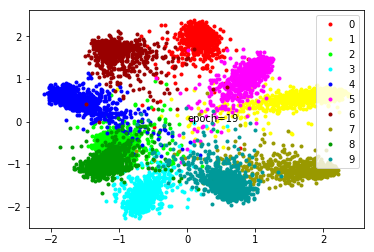

--- epoch 21 ---
--- loss: 1.4033584582805634 % acc: 92.15 %


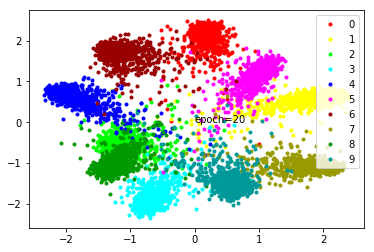

--- epoch 22 ---
--- loss: 1.4459323501586914 % acc: 90.33 %


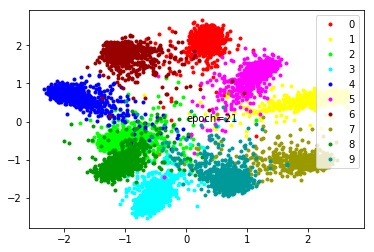

--- epoch 23 ---
--- loss: 1.3777706158161163 % acc: 93.35 %


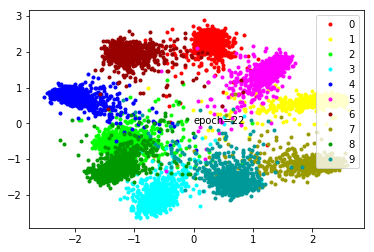

--- epoch 24 ---
--- loss: 1.403874031305313 % acc: 93.72 %


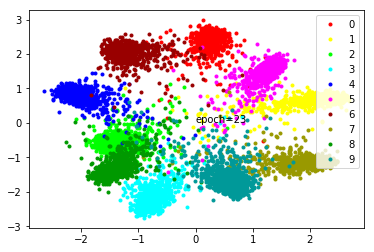

--- epoch 25 ---
--- loss: 1.4351219320297242 % acc: 94.77 %


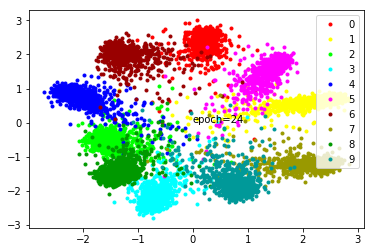

--- epoch 26 ---
--- loss: 1.3965268790721894 % acc: 94.93 %


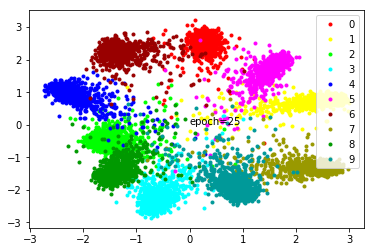

--- epoch 27 ---
--- loss: 1.385402284860611 % acc: 94.99 %


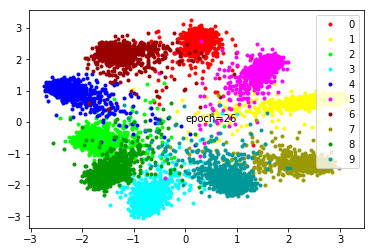

--- epoch 28 ---
--- loss: 1.3549012982845305 % acc: 95.66 %


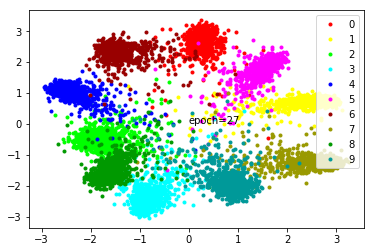

--- epoch 29 ---
--- loss: 1.3875673961639405 % acc: 95.21 %


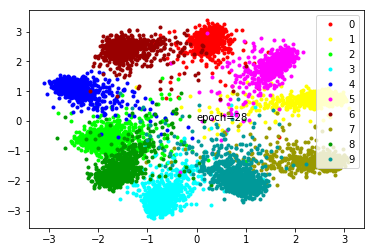

--- epoch 30 ---
--- loss: 1.387543568611145 % acc: 95.7 %


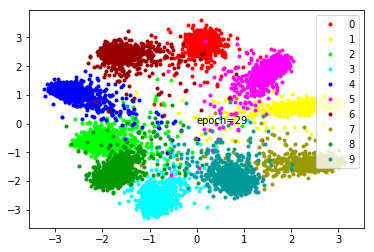

--- epoch 31 ---
--- loss: 1.3971784329414367 % acc: 95.25 %


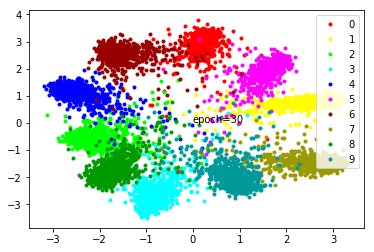

--- epoch 32 ---
--- loss: 1.4506716406345368 % acc: 95.66 %


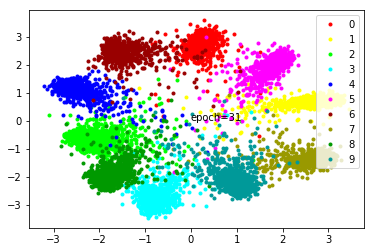

--- epoch 33 ---
--- loss: 1.4714326763153076 % acc: 95.13000000000001 %


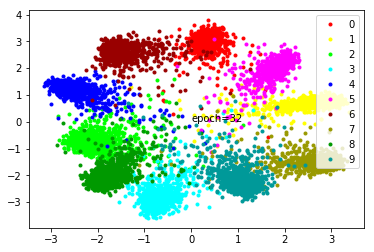

--- epoch 34 ---
--- loss: 1.4471770858764648 % acc: 95.21 %


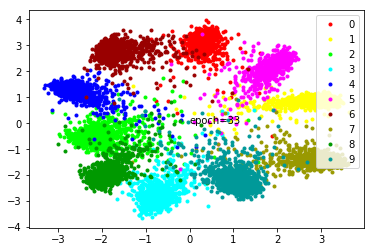

--- epoch 35 ---
--- loss: 1.452219480276108 % acc: 95.25 %


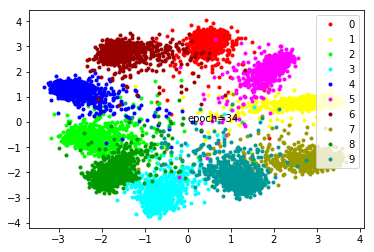

--- epoch 36 ---
--- loss: 1.515940717458725 % acc: 95.08 %


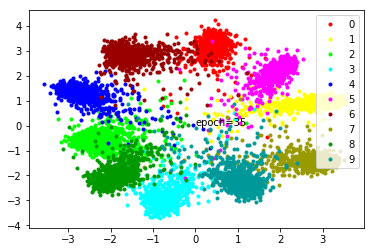

--- epoch 37 ---
--- loss: 1.408621402978897 % acc: 95.0 %


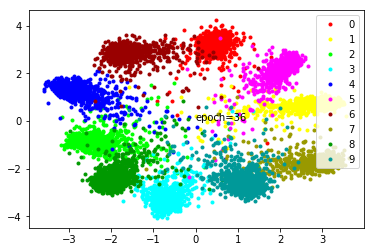

--- epoch 38 ---
--- loss: 1.5006717157363891 % acc: 95.61 %


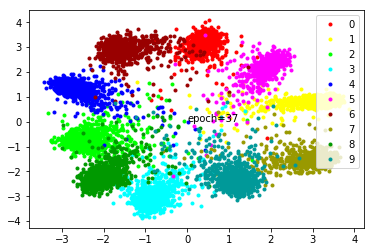

--- epoch 39 ---
--- loss: 1.4841962242126465 % acc: 95.13000000000001 %


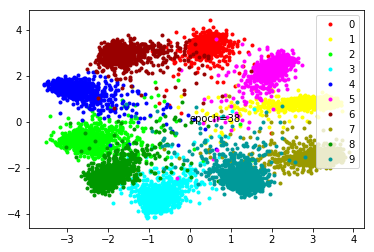

--- epoch 40 ---
--- loss: 1.5310284447669984 % acc: 95.17999999999999 %


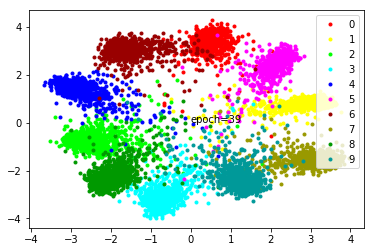

--- epoch 41 ---
--- loss: 1.553699312210083 % acc: 95.22 %


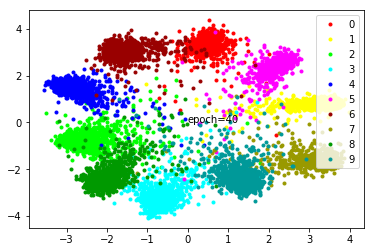

--- epoch 42 ---
--- loss: 1.5027846574783326 % acc: 95.5 %


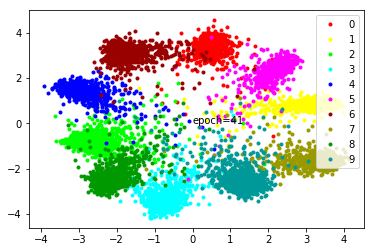

--- epoch 43 ---
--- loss: 1.4311185204982757 % acc: 95.6 %


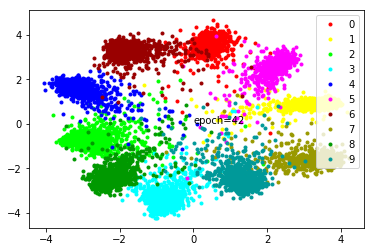

--- epoch 44 ---
--- loss: 1.483066279888153 % acc: 95.39 %


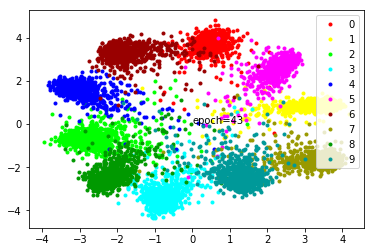

--- epoch 45 ---
--- loss: 1.4778776061534882 % acc: 95.55 %


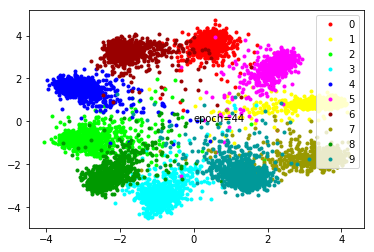

--- epoch 46 ---
--- loss: 1.527552250623703 % acc: 95.21 %


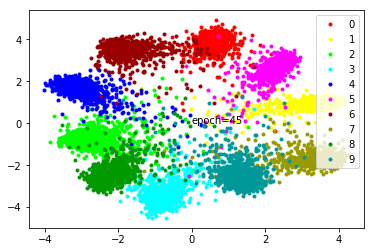

--- epoch 47 ---
--- loss: 1.5423428666591643 % acc: 95.24000000000001 %


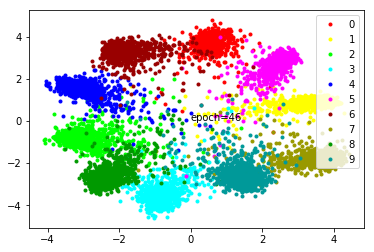

--- epoch 48 ---
--- loss: 1.5893061661720276 % acc: 95.3 %


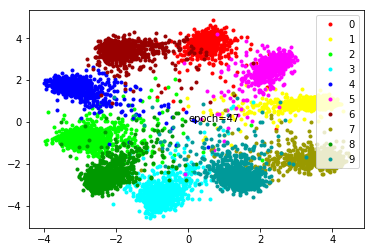

--- epoch 49 ---
--- loss: 1.5060619020462036 % acc: 95.58 %


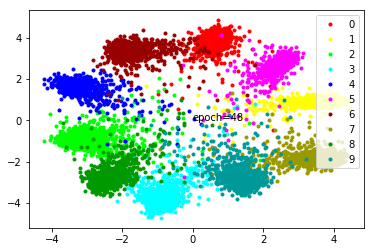

--- epoch 50 ---
--- loss: 1.5412975919246674 % acc: 95.45 %


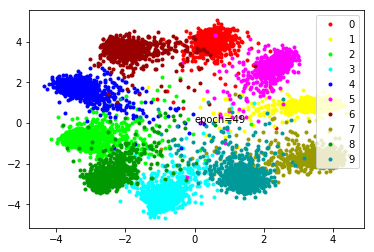

--- epoch 51 ---
--- loss: 1.5307020926475523 % acc: 95.13000000000001 %


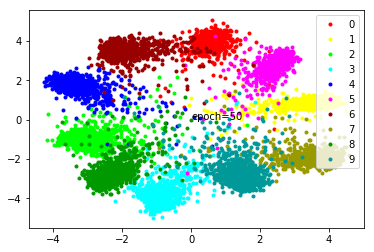

--- epoch 52 ---
--- loss: 1.534764117002487 % acc: 95.24000000000001 %


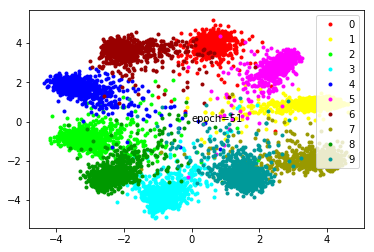

--- epoch 53 ---
--- loss: 1.579725089073181 % acc: 95.33 %


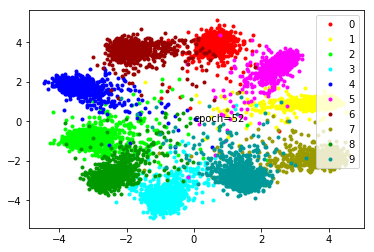

--- epoch 54 ---
--- loss: 1.608502984046936 % acc: 95.21 %


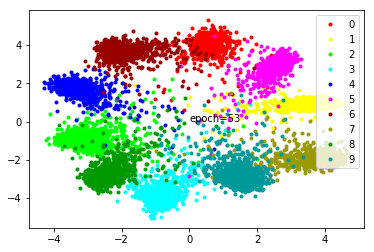

--- epoch 55 ---
--- loss: 1.5632232522964478 % acc: 95.34 %


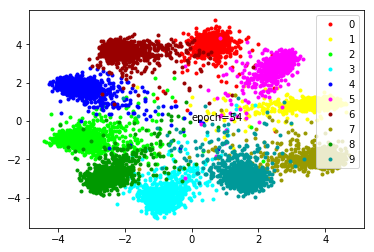

--- epoch 56 ---
--- loss: 1.5455480849742889 % acc: 95.25 %


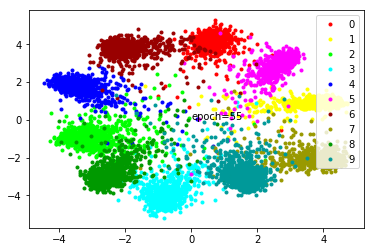

--- epoch 57 ---
--- loss: 1.6069256317615508 % acc: 95.22 %


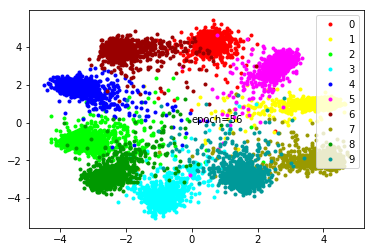

--- epoch 58 ---
--- loss: 1.6705545270442963 % acc: 95.03 %


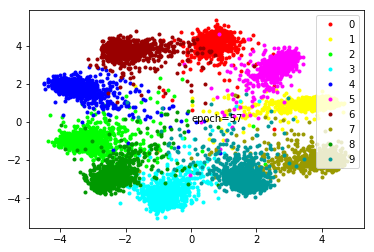

--- epoch 59 ---
--- loss: 1.699320933818817 % acc: 95.11 %


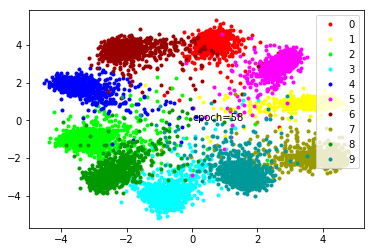

--- epoch 60 ---
--- loss: 1.711548537015915 % acc: 95.27 %


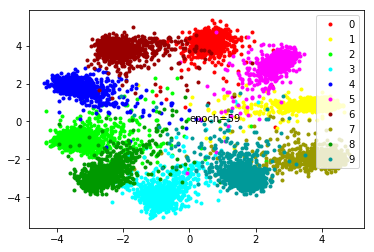

--- epoch 61 ---
--- loss: 1.618861654996872 % acc: 95.35 %


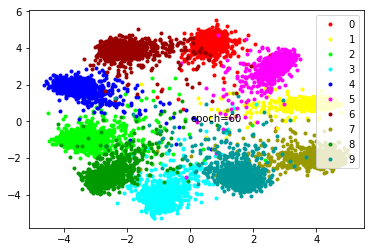

--- epoch 62 ---
--- loss: 1.6004157626628874 % acc: 95.26 %


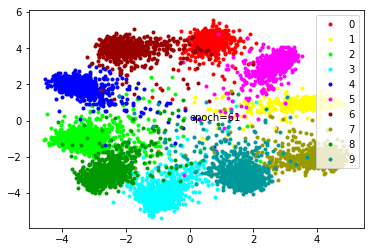

--- epoch 63 ---
--- loss: 1.6196951615810393 % acc: 95.23 %


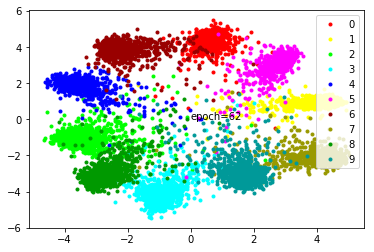

--- epoch 64 ---
--- loss: 1.6485098922252657 % acc: 95.17 %


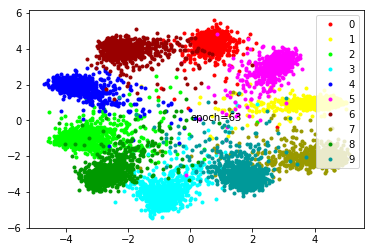

--- epoch 65 ---
--- loss: 1.6248232746124267 % acc: 95.19 %


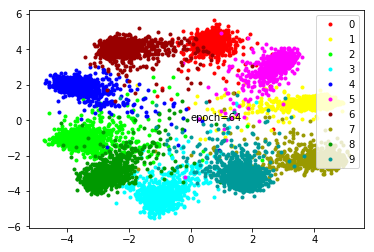

--- epoch 66 ---
--- loss: 1.6494940662384032 % acc: 95.09 %


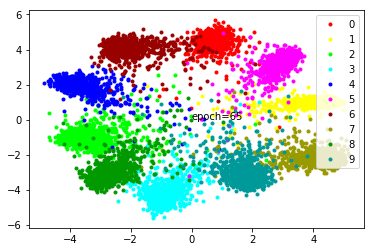

--- epoch 67 ---
--- loss: 1.657873455286026 % acc: 95.33 %


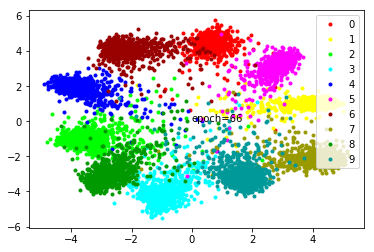

--- epoch 68 ---
--- loss: 1.6754827880859375 % acc: 95.17 %


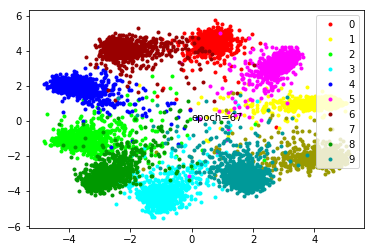

--- epoch 69 ---
--- loss: 1.6551342952251433 % acc: 95.30999999999999 %


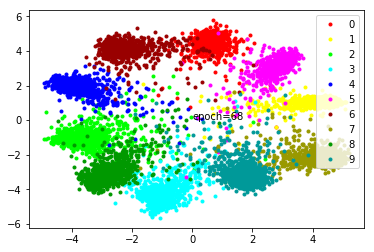

--- epoch 70 ---
--- loss: 1.7087812674045564 % acc: 95.30999999999999 %


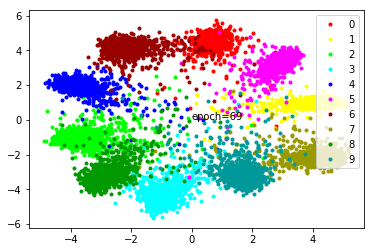

--- epoch 71 ---
--- loss: 1.662953152656555 % acc: 95.09 %


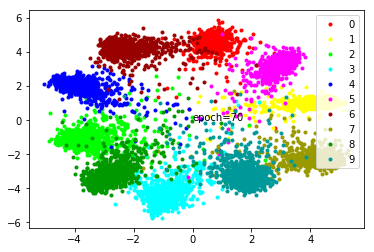

--- epoch 72 ---
--- loss: 1.708310171365738 % acc: 95.17 %


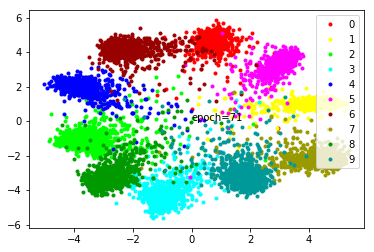

--- epoch 73 ---
--- loss: 1.7511711287498475 % acc: 95.14 %


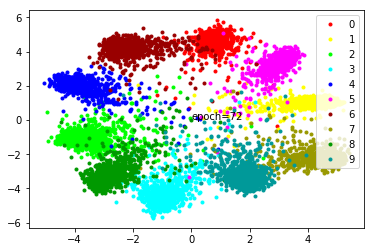

--- epoch 74 ---
--- loss: 1.74596532702446 % acc: 95.17999999999999 %


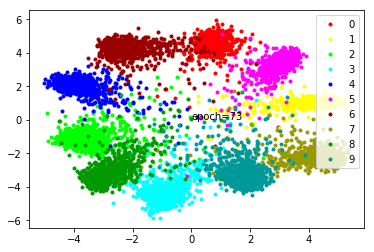

--- epoch 75 ---
--- loss: 1.7424072945117952 % acc: 95.19 %


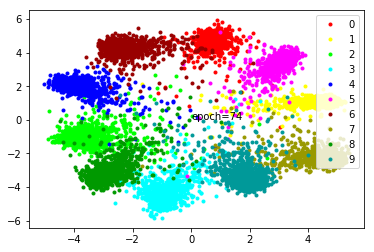

--- epoch 76 ---
--- loss: 1.8159793674945832 % acc: 95.05 %


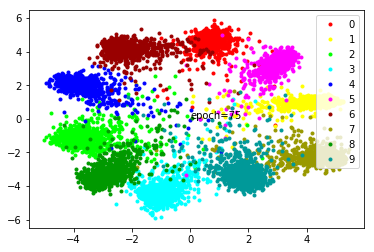

--- epoch 77 ---
--- loss: 1.7856893622875212 % acc: 95.13000000000001 %


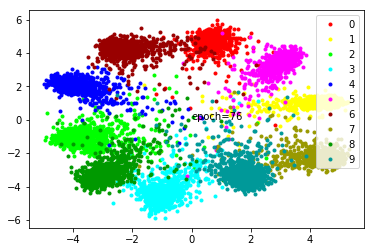

--- epoch 78 ---
--- loss: 1.761428165435791 % acc: 95.06 %


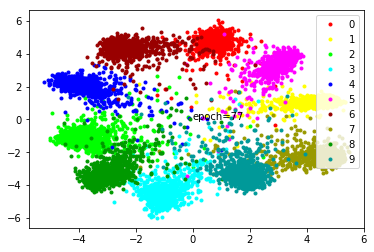

--- epoch 79 ---
--- loss: 1.7746878504753112 % acc: 95.19999999999999 %


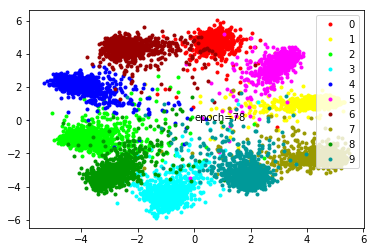

--- epoch 80 ---
--- loss: 1.7607045555114746 % acc: 95.28 %


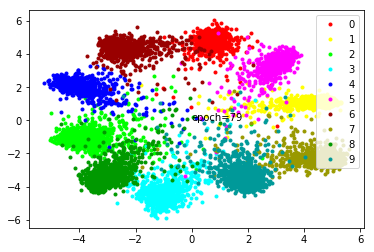

--- epoch 81 ---
--- loss: 1.7827665042877199 % acc: 95.14 %


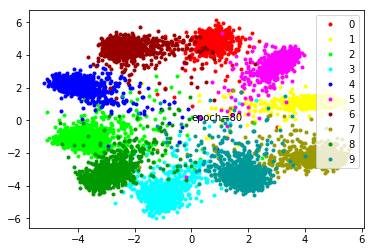

--- epoch 82 ---
--- loss: 1.8325934755802156 % acc: 95.16 %


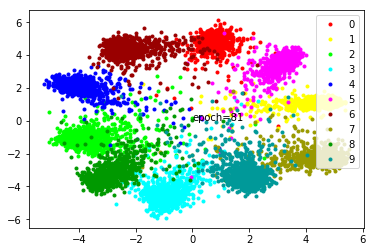

--- epoch 83 ---
--- loss: 1.796729907989502 % acc: 95.0 %


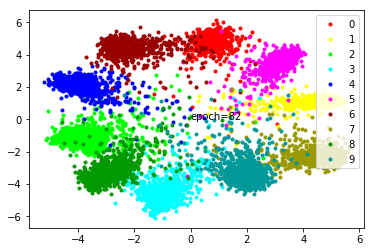

--- epoch 84 ---
--- loss: 1.794811679124832 % acc: 95.06 %


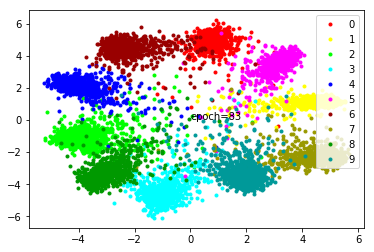

--- epoch 85 ---
--- loss: 1.8012497186660765 % acc: 95.16 %


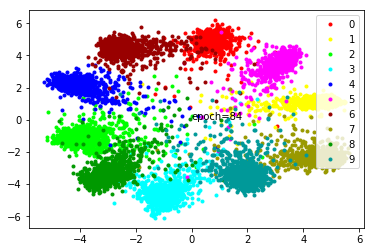

--- epoch 86 ---
--- loss: 1.8626123762130737 % acc: 95.07 %


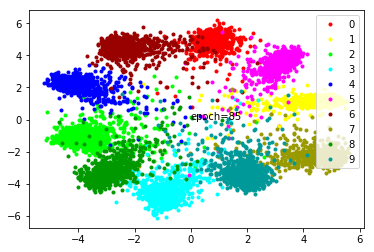

--- epoch 87 ---
--- loss: 1.810295035839081 % acc: 95.23 %


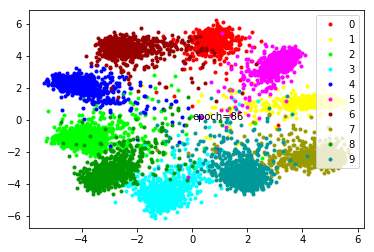

--- epoch 88 ---
--- loss: 1.8664799296855927 % acc: 94.98 %


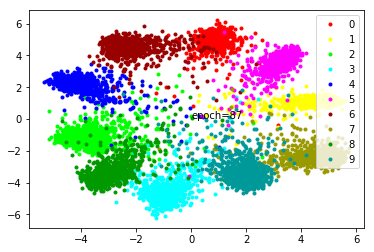

--- epoch 89 ---
--- loss: 1.8898576974868773 % acc: 94.99 %


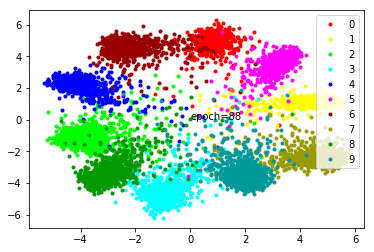

--- epoch 90 ---
--- loss: 1.8304937970638275 % acc: 95.02000000000001 %


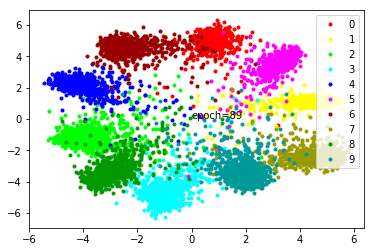

--- epoch 91 ---
--- loss: 1.8731278312206268 % acc: 94.94 %


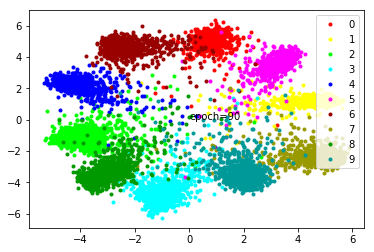

--- epoch 92 ---
--- loss: 1.862672880887985 % acc: 95.05 %


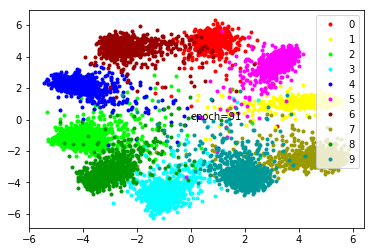

--- epoch 93 ---
--- loss: 1.9163461685180665 % acc: 95.11 %


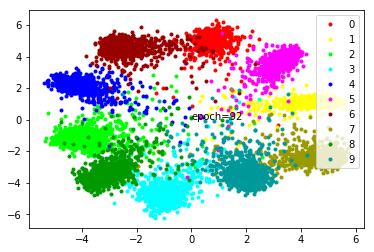

--- epoch 94 ---
--- loss: 1.9018431699275968 % acc: 95.0 %


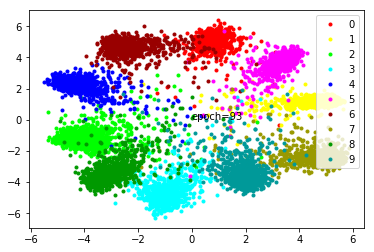

--- epoch 95 ---
--- loss: 1.8751593363285066 % acc: 95.13000000000001 %


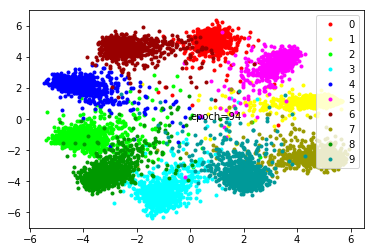

--- epoch 96 ---
--- loss: 1.8912351155281066 % acc: 95.08 %


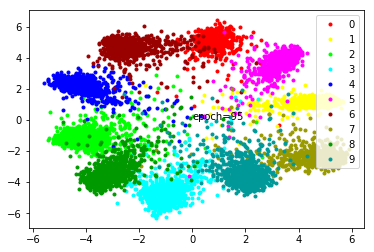

--- epoch 97 ---
--- loss: 1.9604925489425657 % acc: 94.95 %


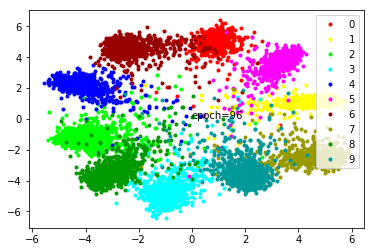

--- epoch 98 ---
--- loss: 1.9336157894134522 % acc: 94.96 %


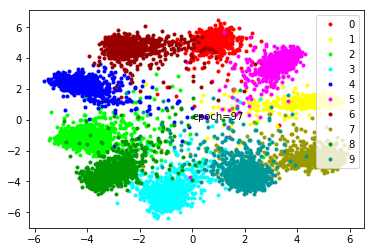

--- epoch 99 ---
--- loss: 1.9258191418647768 % acc: 95.03 %


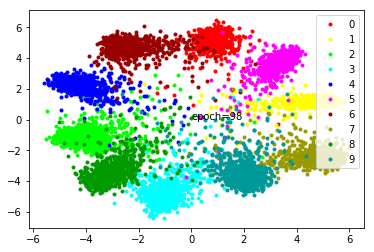

--- epoch 100 ---
--- loss: 1.937709971666336 % acc: 94.96 %


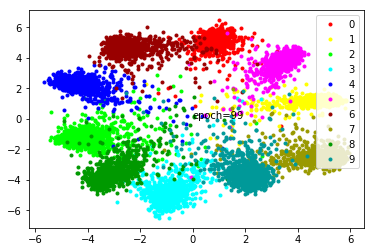

In [12]:
run_model_with_test_data(Net().to(device), 1, CenterLoss(10, 2).to(device), 'test_paper_1')

--- epoch 1 ---
--- loss: 1.8169736337661744 % acc: 11.35 %


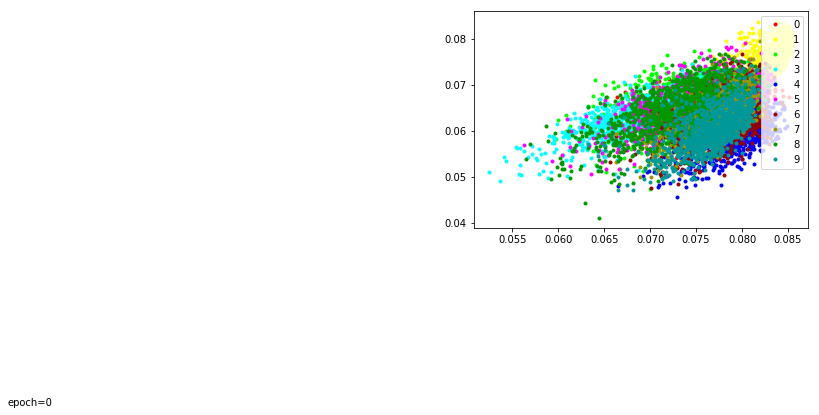

--- epoch 2 ---
--- loss: 1.4179884648323058 % acc: 38.89 %


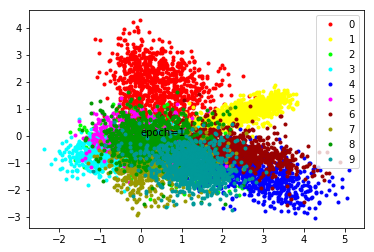

--- epoch 3 ---
--- loss: 0.8650543522834777 % acc: 81.99 %


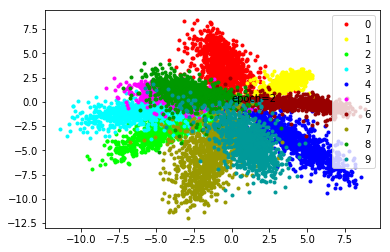

--- epoch 4 ---
--- loss: 0.6605727356672286 % acc: 89.83 %


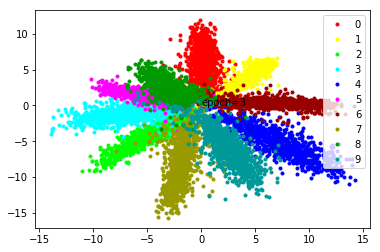

--- epoch 5 ---
--- loss: 0.6071764928102493 % acc: 88.08 %


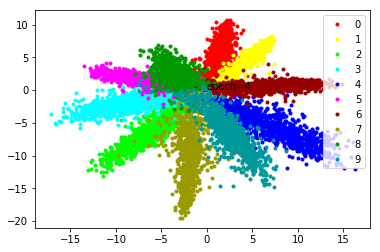

--- epoch 6 ---
--- loss: 0.5982640880346298 % acc: 85.72 %


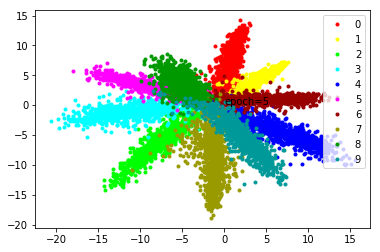

--- epoch 7 ---
--- loss: 0.5411896419525146 % acc: 86.56 %


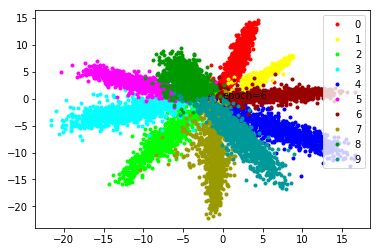

--- epoch 8 ---
--- loss: 0.5088413506746292 % acc: 86.13 %


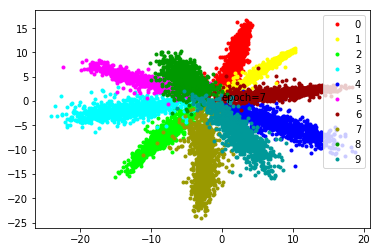

--- epoch 9 ---
--- loss: 0.4751266729831696 % acc: 91.2 %


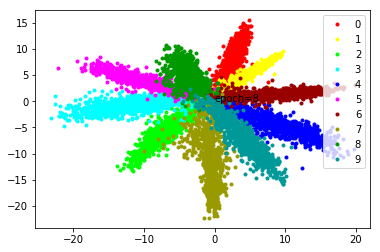

--- epoch 10 ---
--- loss: 0.4680618587136269 % acc: 89.69 %


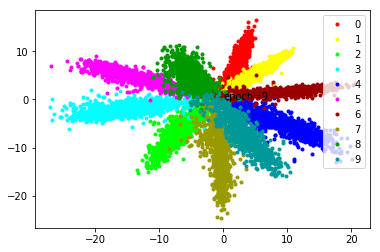

--- epoch 11 ---
--- loss: 0.45730442374944685 % acc: 87.85 %


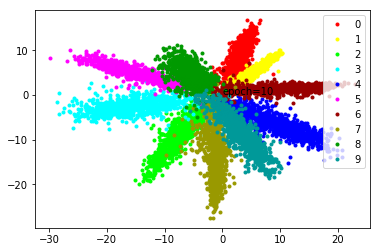

--- epoch 12 ---
--- loss: 0.4070171490311623 % acc: 93.55 %


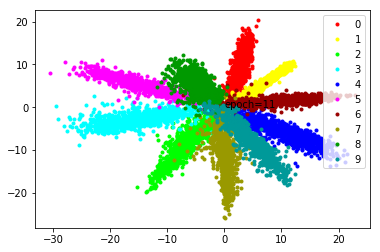

--- epoch 13 ---
--- loss: 0.40274330675601955 % acc: 90.72 %


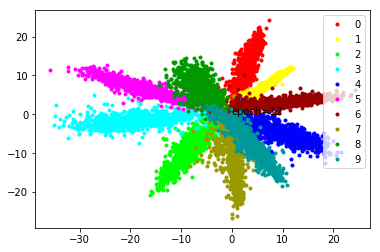

--- epoch 14 ---
--- loss: 0.4062928727269172 % acc: 89.73 %


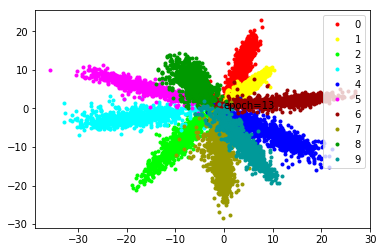

--- epoch 15 ---
--- loss: 0.3980100548267364 % acc: 88.68 %


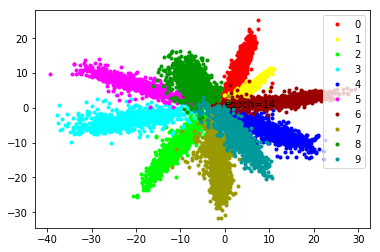

--- epoch 16 ---
--- loss: 0.37375406324863436 % acc: 89.37 %


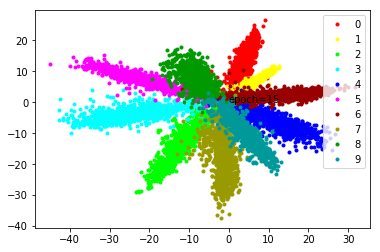

--- epoch 17 ---
--- loss: 0.3905704918503761 % acc: 88.59 %


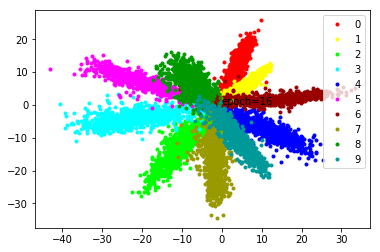

--- epoch 18 ---
--- loss: 0.3511394712328911 % acc: 90.85 %


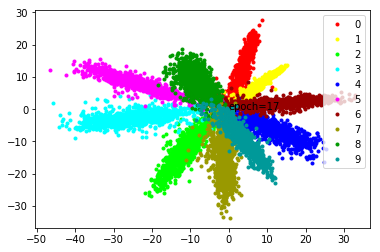

--- epoch 19 ---
--- loss: 0.32448458939790725 % acc: 92.17 %


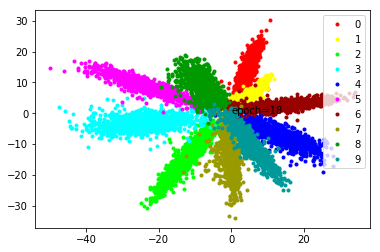

--- epoch 20 ---
--- loss: 0.27866589307785034 % acc: 93.0 %


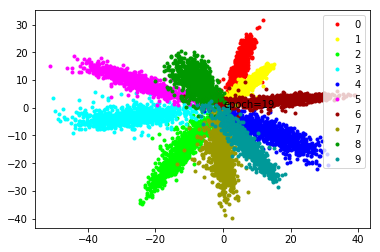

--- epoch 21 ---
--- loss: 0.3208332160115242 % acc: 90.49000000000001 %


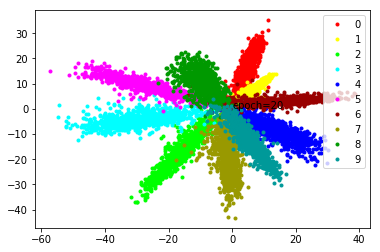

--- epoch 22 ---
--- loss: 0.27330795258283613 % acc: 92.67 %


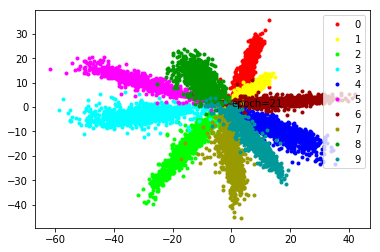

--- epoch 23 ---
--- loss: 0.27682181656360627 % acc: 92.75 %


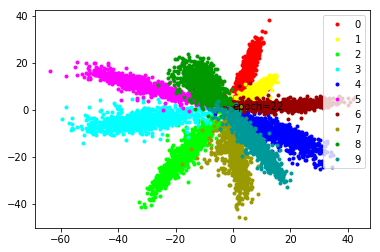

--- epoch 24 ---
--- loss: 0.27207501396536826 % acc: 92.55 %


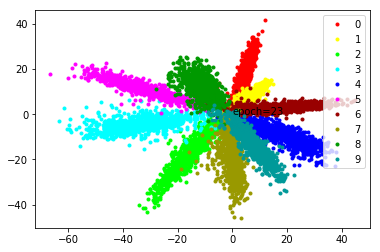

--- epoch 25 ---
--- loss: 0.3117676244676113 % acc: 90.75 %


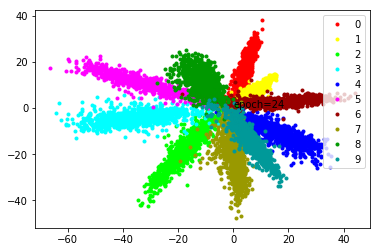

--- epoch 26 ---
--- loss: 0.3112919767200947 % acc: 90.53 %


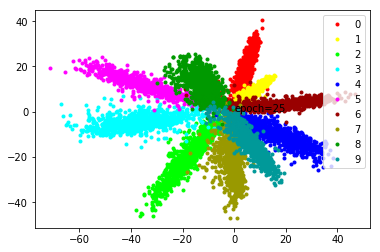

--- epoch 27 ---
--- loss: 0.29748799666762354 % acc: 91.4 %


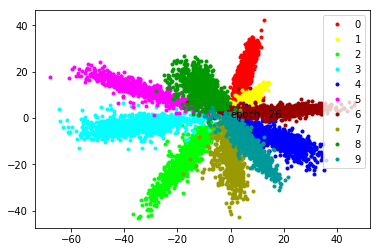

--- epoch 28 ---
--- loss: 0.289932674318552 % acc: 91.5 %


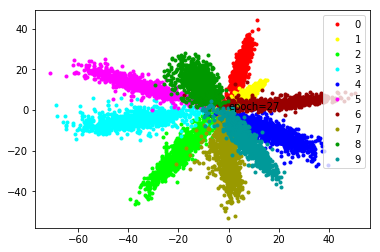

--- epoch 29 ---
--- loss: 0.28535795643925665 % acc: 90.71000000000001 %


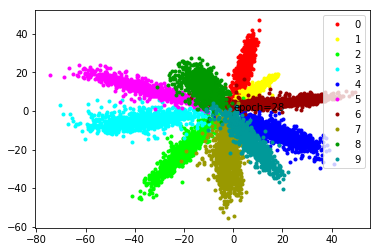

--- epoch 30 ---
--- loss: 0.27535107389092445 % acc: 91.67999999999999 %


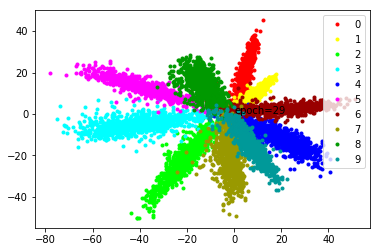

--- epoch 31 ---
--- loss: 0.2808369281888008 % acc: 91.4 %


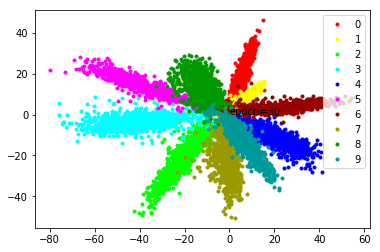

--- epoch 32 ---
--- loss: 0.2674623362720013 % acc: 91.71000000000001 %


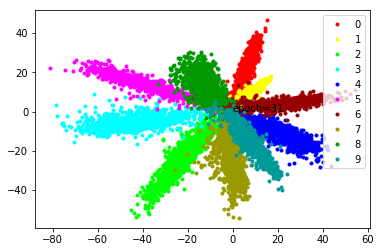

--- epoch 33 ---
--- loss: 0.27871560007333757 % acc: 90.74 %


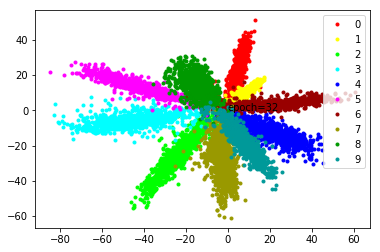

--- epoch 34 ---
--- loss: 0.28324205815792086 % acc: 90.84 %


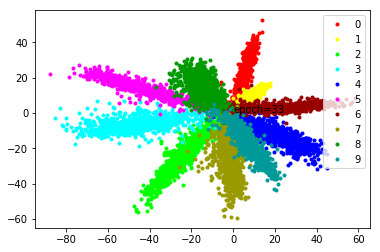

--- epoch 35 ---
--- loss: 0.2857737910747528 % acc: 91.36999999999999 %


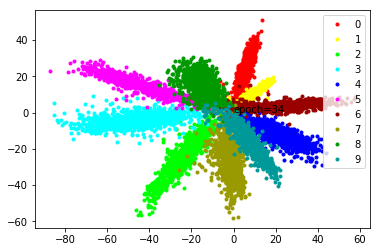

--- epoch 36 ---
--- loss: 0.2777178217470646 % acc: 91.71000000000001 %


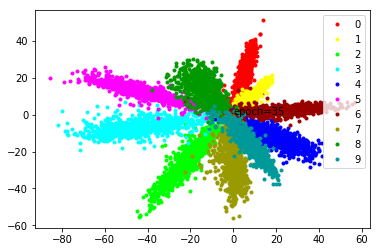

--- epoch 37 ---
--- loss: 0.402534915804863 % acc: 85.65 %


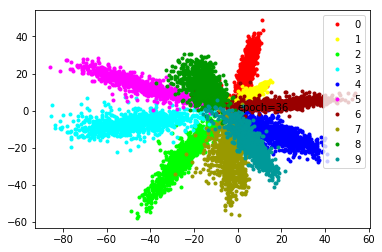

--- epoch 38 ---
--- loss: 0.330574449300766 % acc: 88.81 %


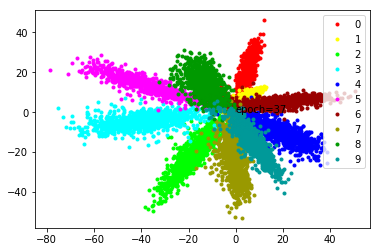

--- epoch 39 ---
--- loss: 0.3007442960143089 % acc: 90.83 %


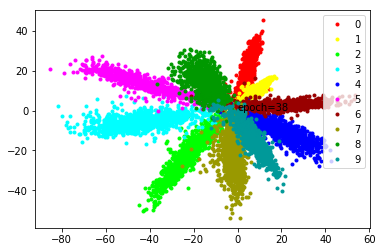

--- epoch 40 ---
--- loss: 0.26366828829050065 % acc: 91.64 %


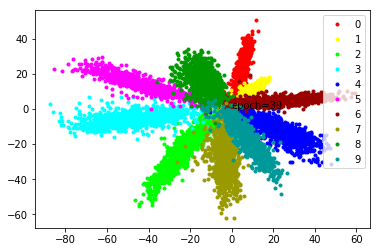

--- epoch 41 ---
--- loss: 0.26254390001297 % acc: 92.11 %


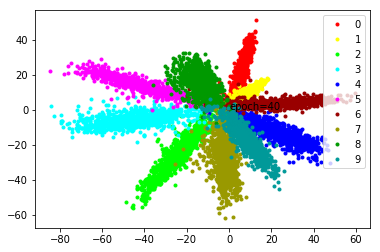

--- epoch 42 ---
--- loss: 0.2783002406358719 % acc: 91.34 %


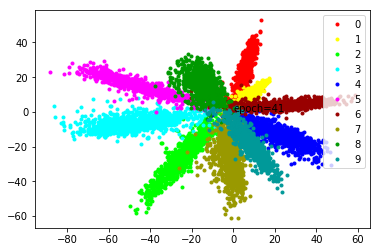

--- epoch 43 ---
--- loss: 0.26225718811154364 % acc: 91.94 %


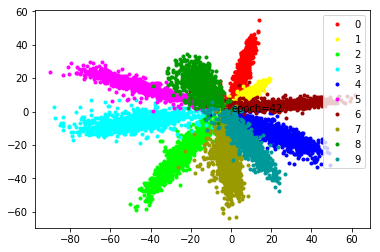

--- epoch 44 ---
--- loss: 0.26784550175070765 % acc: 91.63 %


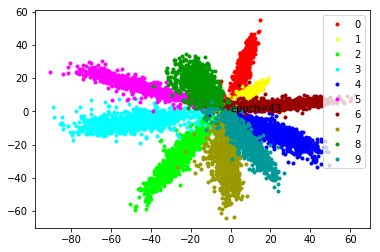

--- epoch 45 ---
--- loss: 0.2718460476398468 % acc: 91.49000000000001 %


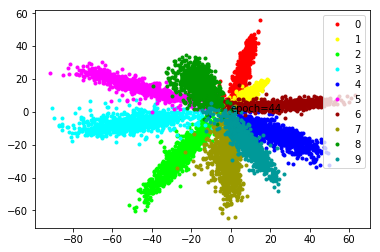

--- epoch 46 ---
--- loss: 0.26102962166070937 % acc: 91.75999999999999 %


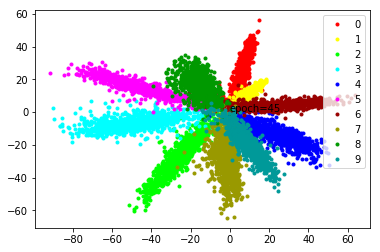

--- epoch 47 ---
--- loss: 0.26274301767349245 % acc: 91.86 %


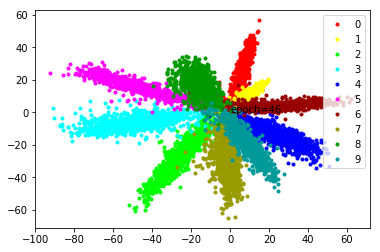

--- epoch 48 ---
--- loss: 0.26115662053227423 % acc: 91.88 %


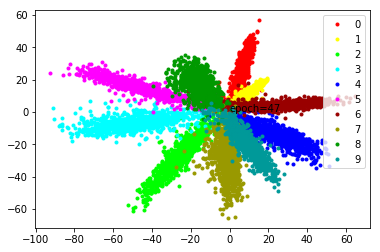

--- epoch 49 ---
--- loss: 0.2622563481330871 % acc: 91.82000000000001 %


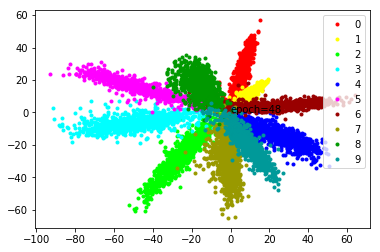

--- epoch 50 ---
--- loss: 0.26127727299928666 % acc: 91.77 %


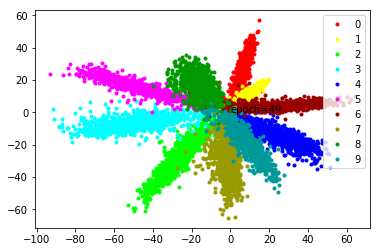

--- epoch 51 ---
--- loss: 0.2648115184158087 % acc: 92.0 %


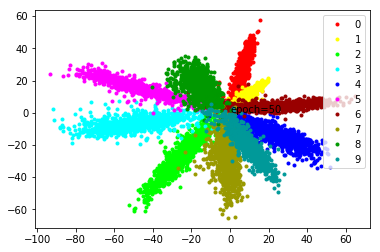

--- epoch 52 ---
--- loss: 0.257190959751606 % acc: 92.02 %


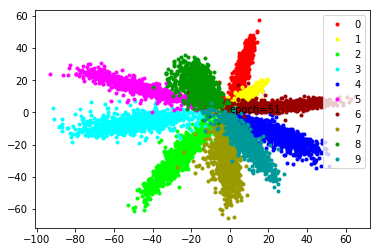

--- epoch 53 ---
--- loss: 0.2560859876871109 % acc: 92.0 %


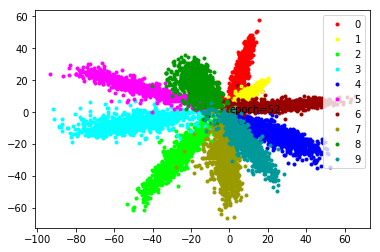

--- epoch 54 ---
--- loss: 0.2529213017225266 % acc: 92.08 %


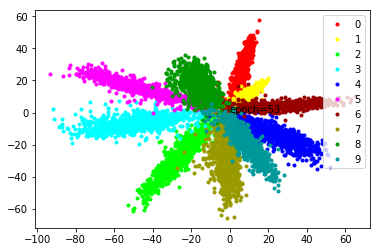

--- epoch 55 ---
--- loss: 0.25794627591967584 % acc: 91.86 %


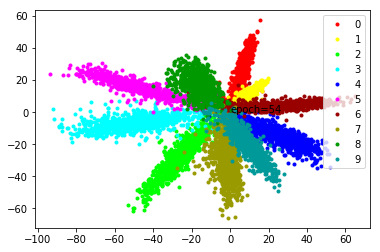

--- epoch 56 ---
--- loss: 0.2585138259828091 % acc: 92.0 %


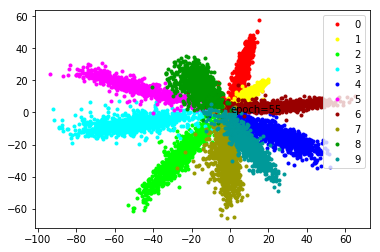

--- epoch 57 ---
--- loss: 0.25919569298624995 % acc: 91.97 %


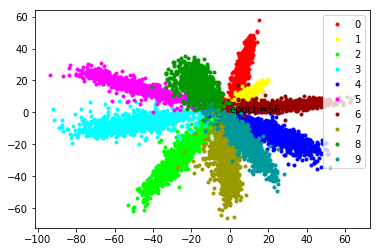

--- epoch 58 ---
--- loss: 0.2581531116366386 % acc: 91.99000000000001 %


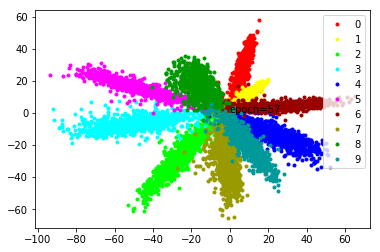

--- epoch 59 ---
--- loss: 0.2517033576965332 % acc: 92.15 %


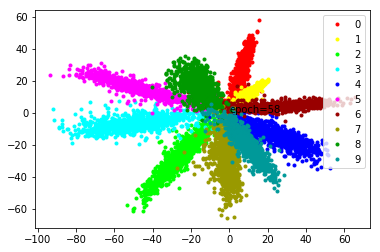

--- epoch 60 ---
--- loss: 0.25604116439819335 % acc: 92.0 %


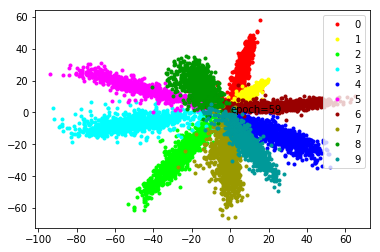

--- epoch 61 ---
--- loss: 0.25488003477454185 % acc: 91.97 %


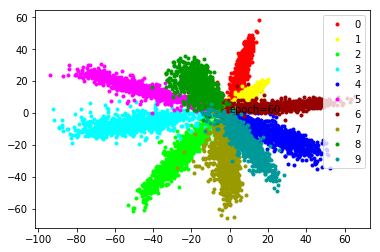

--- epoch 62 ---
--- loss: 0.2568136619031429 % acc: 91.91 %


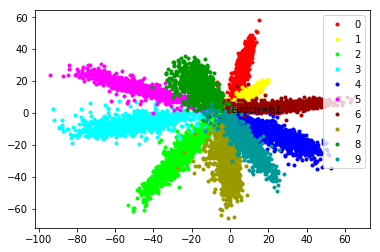

--- epoch 63 ---
--- loss: 0.2605292923748493 % acc: 91.81 %


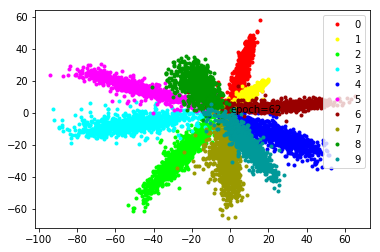

--- epoch 64 ---
--- loss: 0.25081411600112913 % acc: 92.11 %


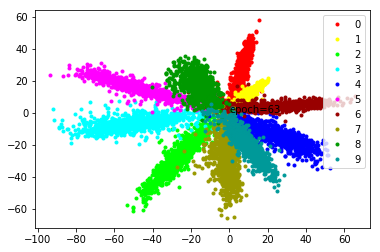

--- epoch 65 ---
--- loss: 0.25190700247883796 % acc: 92.22 %


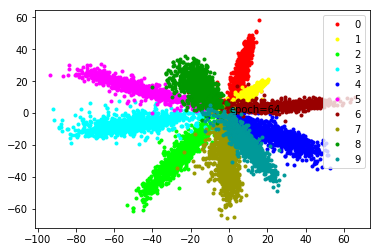

--- epoch 66 ---
--- loss: 0.25119028747081756 % acc: 92.12 %


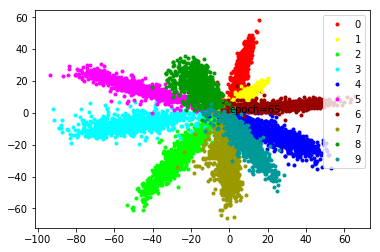

--- epoch 67 ---
--- loss: 0.2624466097354889 % acc: 92.06 %


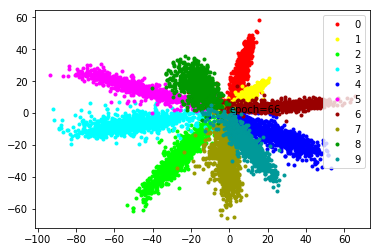

--- epoch 68 ---
--- loss: 0.2511395841836929 % acc: 92.10000000000001 %


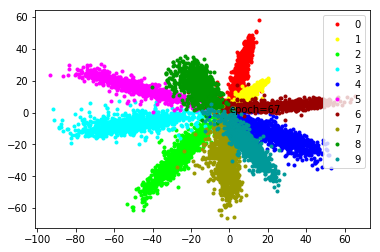

--- epoch 69 ---
--- loss: 0.2512792633473873 % acc: 92.2 %


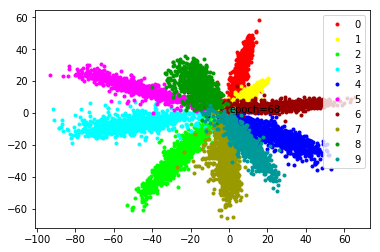

--- epoch 70 ---
--- loss: 0.2560860615968704 % acc: 92.02 %


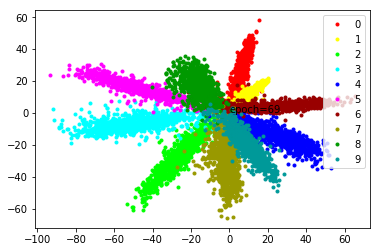

--- epoch 71 ---
--- loss: 0.2526770533621311 % acc: 91.96 %


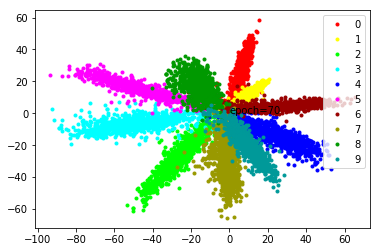

--- epoch 72 ---
--- loss: 0.25524543210864065 % acc: 91.96 %


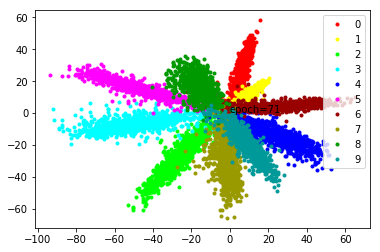

--- epoch 73 ---
--- loss: 0.25837617091834547 % acc: 91.92 %


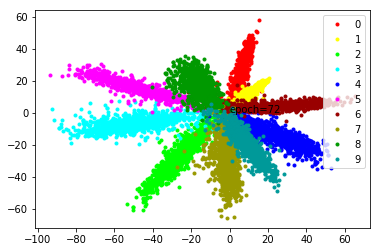

--- epoch 74 ---
--- loss: 0.2528749337792397 % acc: 92.02 %


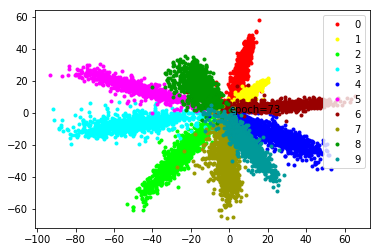

--- epoch 75 ---
--- loss: 0.25267591685056684 % acc: 92.08 %


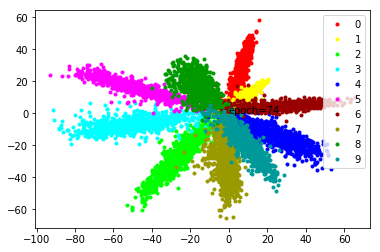

--- epoch 76 ---
--- loss: 0.25268295183777806 % acc: 92.01 %


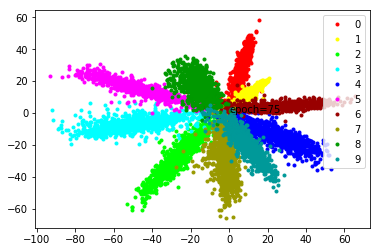

--- epoch 77 ---
--- loss: 0.24911419235169888 % acc: 92.14 %


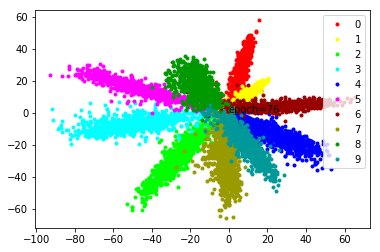

--- epoch 78 ---
--- loss: 0.25434201553463937 % acc: 91.99000000000001 %


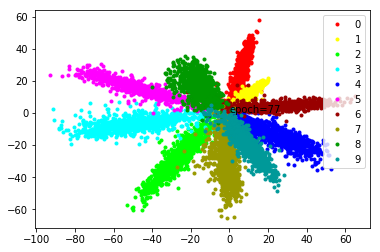

--- epoch 79 ---
--- loss: 0.2526381053030491 % acc: 92.02 %


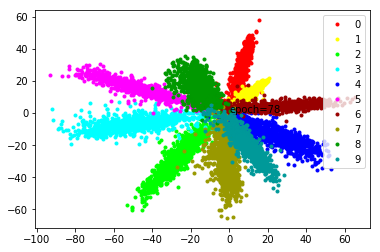

--- epoch 80 ---
--- loss: 0.2545497153699398 % acc: 91.95 %


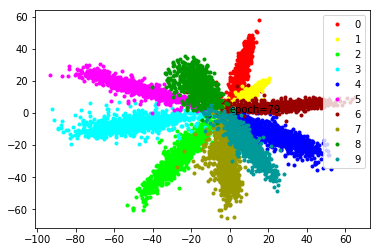

--- epoch 81 ---
--- loss: 0.2511015936732292 % acc: 92.04 %


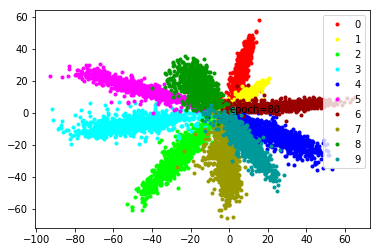

--- epoch 82 ---
--- loss: 0.2520462563633919 % acc: 92.01 %


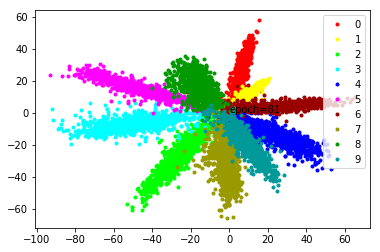

--- epoch 83 ---
--- loss: 0.25081265084445475 % acc: 92.06 %


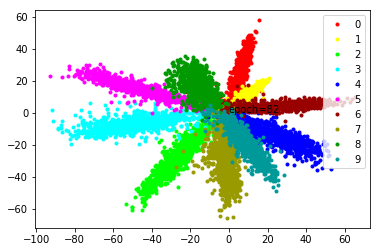

--- epoch 84 ---
--- loss: 0.26147533535957335 % acc: 92.04 %


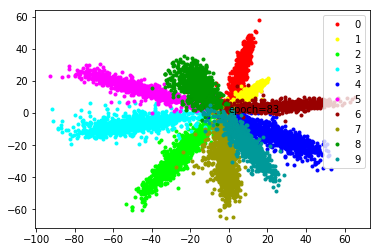

--- epoch 85 ---
--- loss: 0.2539216524362564 % acc: 91.97999999999999 %


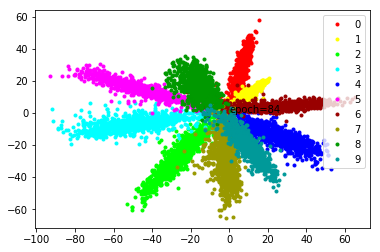

--- epoch 86 ---
--- loss: 0.25332328021526335 % acc: 92.01 %


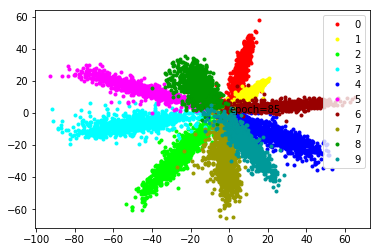

--- epoch 87 ---
--- loss: 0.2538905367255211 % acc: 92.02 %


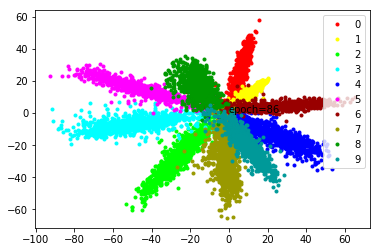

--- epoch 88 ---
--- loss: 0.2537156607210636 % acc: 91.94 %


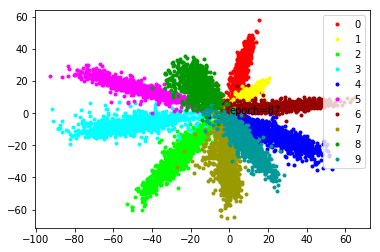

--- epoch 89 ---
--- loss: 0.2500243566930294 % acc: 92.07 %


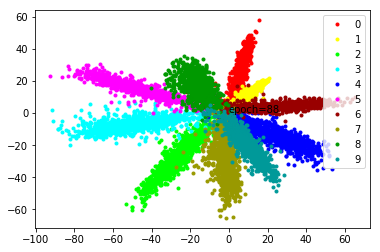

--- epoch 90 ---
--- loss: 0.24927376002073287 % acc: 92.10000000000001 %


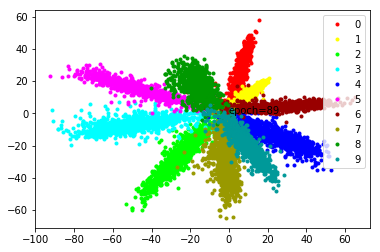

--- epoch 91 ---
--- loss: 0.25113649725914 % acc: 92.01 %


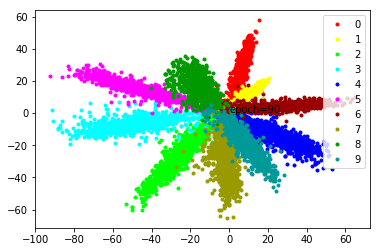

--- epoch 92 ---
--- loss: 0.2550953370332718 % acc: 92.01 %


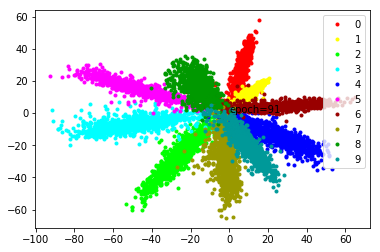

--- epoch 93 ---
--- loss: 0.2550342820584774 % acc: 91.92 %


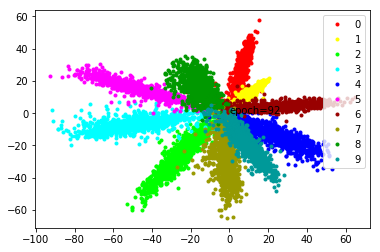

--- epoch 94 ---
--- loss: 0.249339532405138 % acc: 92.06 %


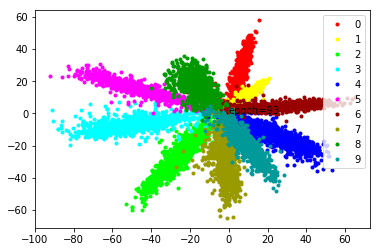

--- epoch 95 ---
--- loss: 0.25177294939756395 % acc: 92.02 %


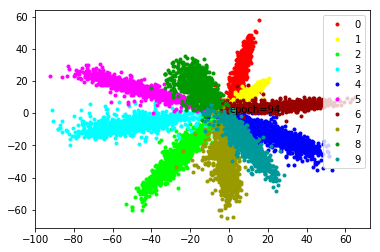

--- epoch 96 ---
--- loss: 0.2512604381144047 % acc: 92.08 %


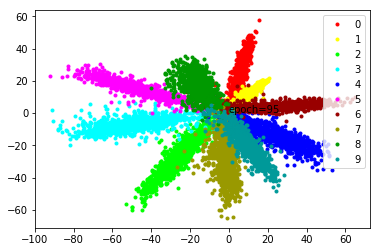

--- epoch 97 ---
--- loss: 0.261989673525095 % acc: 92.11 %


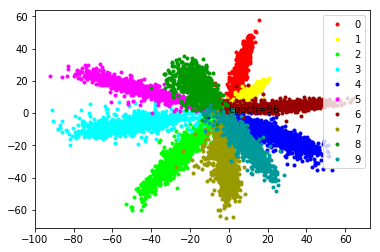

--- epoch 98 ---
--- loss: 0.2531394983828068 % acc: 91.96 %


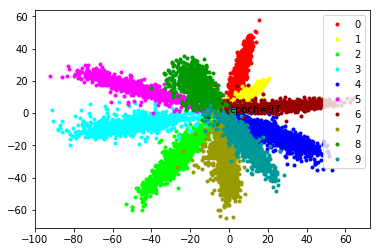

--- epoch 99 ---
--- loss: 0.2507745641469955 % acc: 92.11 %


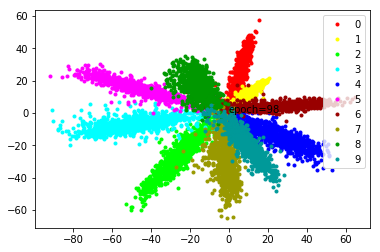

--- epoch 100 ---
--- loss: 0.2529986092448234 % acc: 92.0 %


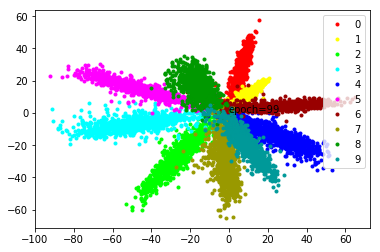

In [13]:
run_model_with_test_data(Net().to(device), 0, CenterLoss(10, 2).to(device), 'test_softmax')

## 3. Run real model

In [7]:
model = Net()
model.ip1 = nn.Linear(128*3*3, 500)
model.ip2 = nn.Linear(500, 10)
run_model_with_test_data(model.to(device), 0, CenterLoss(10, 500).to(device))

--- epoch 1 ---
--- loss: 1.8169481372833252 % acc: 11.35 %
--- epoch 2 ---
--- loss: 1.2737312066555022 % acc: 62.03999999999999 %
--- epoch 3 ---
--- loss: 1.0108087861537933 % acc: 75.32 %
--- epoch 4 ---
--- loss: 0.8602176022529603 % acc: 84.05 %
--- epoch 5 ---
--- loss: 0.7635436481237412 % acc: 89.55 %
--- epoch 6 ---
--- loss: 0.6565245968103409 % acc: 93.54 %
--- epoch 7 ---
--- loss: 0.6077688014507293 % acc: 92.88 %
--- epoch 8 ---
--- loss: 0.5745077896118165 % acc: 94.89 %
--- epoch 9 ---
--- loss: 0.503235205411911 % acc: 96.04 %
--- epoch 10 ---
--- loss: 0.484572679400444 % acc: 95.44 %
--- epoch 11 ---
--- loss: 0.44855368763208386 % acc: 96.26 %
--- epoch 12 ---
--- loss: 0.42030615836381907 % acc: 96.83 %
--- epoch 13 ---
--- loss: 0.3904612502455711 % acc: 97.45 %
--- epoch 14 ---
--- loss: 0.3982886326313019 % acc: 96.6 %
--- epoch 15 ---
--- loss: 0.3642943000793457 % acc: 97.14 %
--- epoch 16 ---
--- loss: 0.3363960960507393 % acc: 97.35000000000001 %
--- epoch 

In [8]:
model = Net()
model.ip1 = nn.Linear(128*3*3, 500)
model.ip2 = nn.Linear(500, 10)
run_model_with_test_data(model.to(device), 0.01, CenterLoss(10, 500).to(device))

--- epoch 1 ---
--- loss: 1.8835374355316161 % acc: 11.35 %
--- epoch 2 ---
--- loss: 1.612290610074997 % acc: 43.9 %
--- epoch 3 ---
--- loss: 1.1960571718215942 % acc: 82.99 %
--- epoch 4 ---
--- loss: 0.9656533610820771 % acc: 95.33 %
--- epoch 5 ---
--- loss: 0.8271287912130356 % acc: 96.98 %
--- epoch 6 ---
--- loss: 0.7633402913808823 % acc: 97.56 %
--- epoch 7 ---
--- loss: 0.6961877578496932 % acc: 97.89 %
--- epoch 8 ---
--- loss: 0.6383659678697586 % acc: 98.33 %
--- epoch 9 ---
--- loss: 0.6005302214622498 % acc: 98.44000000000001 %
--- epoch 10 ---
--- loss: 0.5583380317687988 % acc: 98.65 %
--- epoch 11 ---
--- loss: 0.5241531455516815 % acc: 98.77 %
--- epoch 12 ---
--- loss: 0.5077287679910659 % acc: 98.71 %
--- epoch 13 ---
--- loss: 0.4604631105065346 % acc: 98.83999999999999 %
--- epoch 14 ---
--- loss: 0.4449660804867745 % acc: 99.03 %
--- epoch 15 ---
--- loss: 0.4216116985678673 % acc: 98.87 %
--- epoch 16 ---
--- loss: 0.40334713280200957 % acc: 98.91 %
--- epoch 